In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import pylab
pylab.rcParams['figure.figsize'] = (10.0, 8.0)

In [2]:
import numpy as np

import torch
from faster_rcnn.utils.cython_bbox import bbox_overlaps
from pycrayon import CrayonClient

import cPickle
from torch.optim import SGD, RMSprop, Adam
from torch.optim.lr_scheduler import StepLR
from datetime import datetime
from faster_rcnn.utils.datasets.adapter import convert_data
from faster_rcnn.utils.evaluate.metter import AverageMeter
from faster_rcnn.utils.display.images import imshow, result_show

### Đọc dữ liệu từ MS COCO dataset


In [3]:
import gc, inspect
def _get_tensors(gpu_only=True):
    for obj in gc.get_objects():
        try:
            if torch.is_tensor(obj):
                tensor = obj
            elif hasattr(obj, 'data') and torch.is_tensor(obj.data):
                tensor = obj.data
            else:
                continue

            if tensor.is_cuda:
                yield tensor
        except Exception as e:
            pass

def find_names(obj):
    frame = inspect.currentframe()
    for frame in iter(lambda: frame.f_back, None):
        frame.f_locals
    obj_names = []
    for referrer in gc.get_referrers(obj):
        if isinstance(referrer, dict):
            for k, v in referrer.items():
                if v is obj:
                    obj_names.append(k)
    return obj_names

In [4]:
import os
from faster_rcnn.utils.datasets.adapter import convert_data
import torchvision.transforms as transforms
from faster_rcnn.utils.datasets.voc.voc import VOCDetection
from faster_rcnn.utils.datasets.merge  import VOCMerge
from torch.utils.data import DataLoader
from faster_rcnn.utils.datasets.transform import RandomHorizontalFlip, Resize, Compose
from faster_rcnn.utils.datasets import SortedIndexSampler

sampler = SortedIndexSampler(np.load("./shuffled_index.npy"))

general_transform = Compose([
    Resize(600),
    RandomHorizontalFlip(0.5)
])


transform = transforms.Compose([
                transforms.RandomChoice([
                    transforms.ColorJitter(hue=.1, saturation=.1),
                    transforms.RandomGrayscale(p=0.7),
                ]),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [
                                     0.229, 0.224, 0.225])
            ])

root = '/data/data/'
ds = VOCMerge(root, 'train', dataset_name='tmp', oversample=True, oversample_len=100, general_transform=general_transform, transform=transform)
val_ds = VOCMerge(root, 'val', dataset_name='tmp', oversample=True, oversample_len=50, general_transform=general_transform,)
print(len(ds), len(val_ds))
batch_size = 4

train_data_loader = DataLoader(ds, batch_size=batch_size, shuffle=False, sampler=sampler, collate_fn=convert_data, num_workers=0)
val_data_loader = DataLoader(val_ds, batch_size=batch_size, shuffle=True, collate_fn=convert_data, num_workers=0)

(43630, 21700)


In [5]:
for k,v in ds.sub_class_dict.iteritems():
    print("id: %s, len: %d"%  (k, len(v.ids)))
for k,v in val_ds.sub_class_dict.iteritems():
    print("id: %s, len: %d"%  (k, len(v.ids)))

id: 2788, len: 126
id: 625, len: 78
id: 5563, len: 55
id: 11262, len: 44
id: 1945, len: 64
id: 810, len: 72
id: 349, len: 64
id: 817, len: 79
id: 1623, len: 81
id: 1799, len: 75
id: 2857, len: 75
id: 1490, len: 54
id: 1493, len: 80
id: 2071, len: 70
id: 5308, len: 35
id: 1701, len: 73
id: 5303, len: 100
id: 2075, len: 65
id: 1668, len: 68
id: 1667, len: 87
id: 1666, len: 78
id: 1664, len: 37
id: 1660, len: 80
id: 1129, len: 50
id: 594, len: 80
id: 195, len: 64
id: 968, len: 63
id: 8607, len: 76
id: 1126, len: 40
id: 1088, len: 77
id: 39368, len: 33
id: 276, len: 92
id: 277, len: 75
id: 4557, len: 69
id: 17387, len: 32
id: 2541, len: 56
id: 3381, len: 95
id: 2985, len: 104
id: 2381, len: 80
id: 527, len: 55
id: 1016, len: 37
id: 1017, len: 67
id: 1407, len: 81
id: 449, len: 60
id: 1237, len: 78
id: 4212, len: 87
id: 4196, len: 72
id: 1337, len: 82
id: 440, len: 80
id: 100, len: 48
id: 2101, len: 53
id: 4353, len: 100
id: 38, len: 77
id: 4815, len: 78
id: 1843, len: 63
id: 1842, len: 80


In [6]:
ds.classes

['__background__',
 u'1009',
 u'100',
 u'1016',
 u'1017',
 u'1022',
 u'1028',
 u'1041',
 u'1044',
 u'10564',
 u'10576',
 u'1057',
 u'1058',
 u'10610',
 u'10641',
 u'1077',
 u'1088',
 u'1101',
 u'11262',
 u'1126',
 u'1129',
 u'1133',
 u'1136',
 u'1143',
 u'1163',
 u'1167',
 u'1173',
 u'1191',
 u'119',
 u'1203',
 u'1205',
 u'12122',
 u'1217',
 u'1218',
 u'1220',
 u'1221',
 u'1227',
 u'122',
 u'1237',
 u'1243',
 u'1245',
 u'1247',
 u'1248',
 u'1251',
 u'1258',
 u'1831',
 u'1271',
 u'1276',
 u'1277',
 u'1279',
 u'13373',
 u'1337',
 u'1354',
 u'1364',
 u'1365',
 u'136',
 u'1372',
 u'1382',
 u'1392',
 u'13953',
 u'1395',
 u'1396',
 u'1407',
 u'1425',
 u'1430',
 u'1431',
 u'1434',
 u'1439',
 u'1446',
 u'1457',
 u'1458',
 u'1463',
 u'146',
 u'1485',
 u'1486',
 u'1490',
 u'1493',
 u'150',
 u'1538',
 u'1541',
 u'1556',
 u'1562',
 u'1584',
 u'1589',
 u'1593',
 u'1595',
 u'1596',
 u'15',
 u'1603',
 u'16064',
 u'160',
 u'1619',
 u'1623',
 u'1624',
 u'1630',
 u'1632',
 u'1635',
 u'1638',
 u'1639',
 

(7, 5)
2_gs_808266.jpg [[  4.   12.8 793.6 595.2 332. ]]


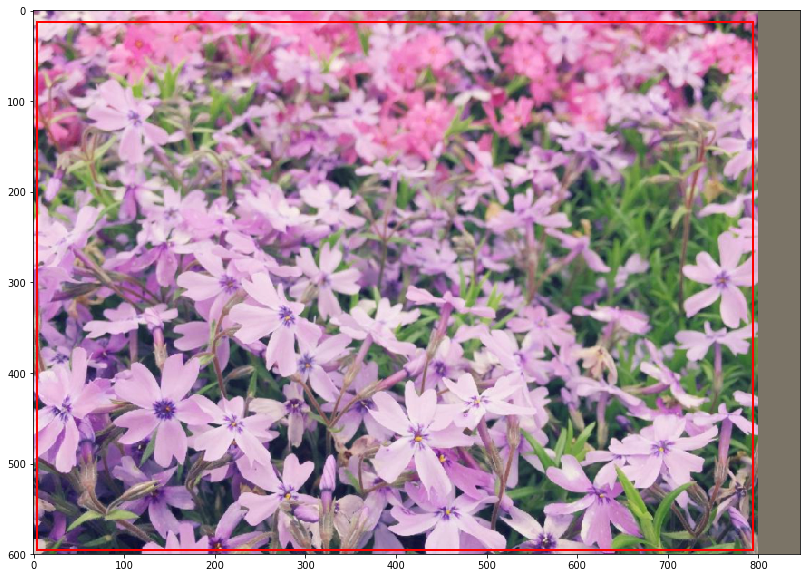

2_gs_1018066.jpg [[150.4 261.6 282.4 404.  349. ]
 [251.2 156.  368.  308.  349. ]
 [348.  128.  524.8 348.8 349. ]
 [652.8 193.6 799.2 356.8 349. ]]


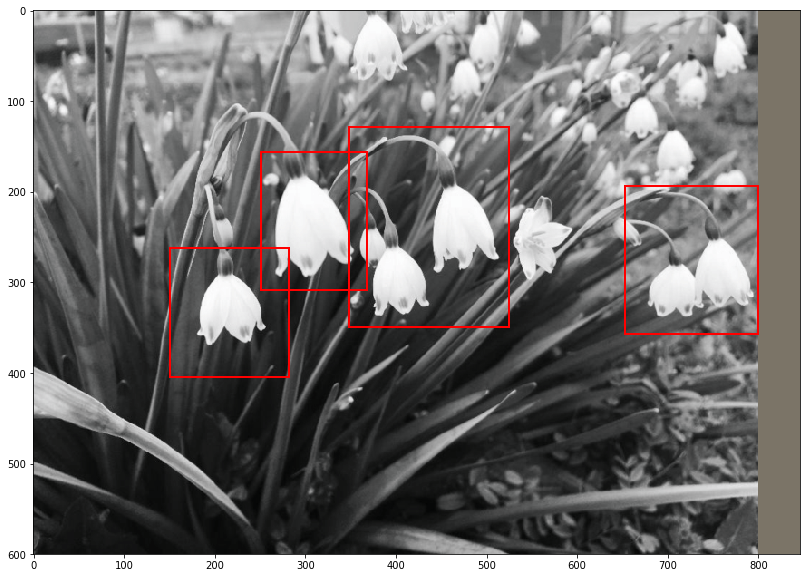

2_gs_1527016.jpg [[245.41607898  44.85190409 846.26234133 544.99294781 191.        ]]


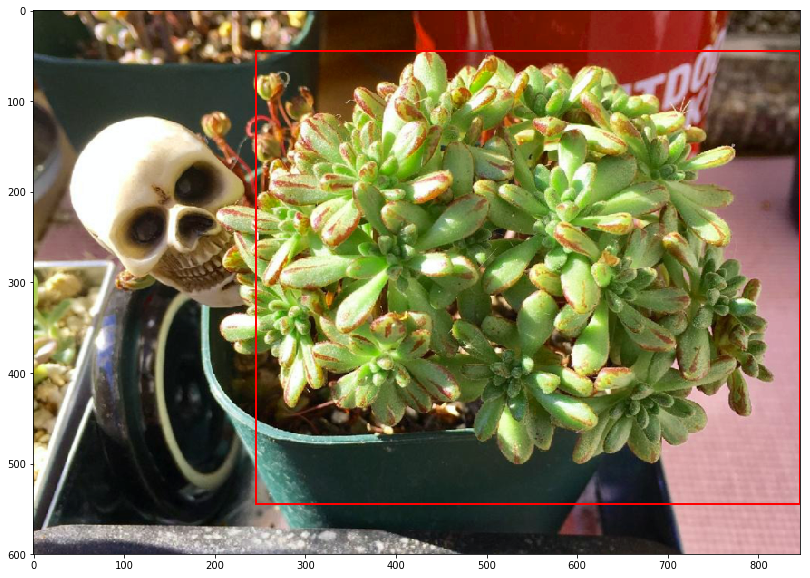

2_gs_1501810.jpg [[ 68.  24. 788. 416. 321.]]


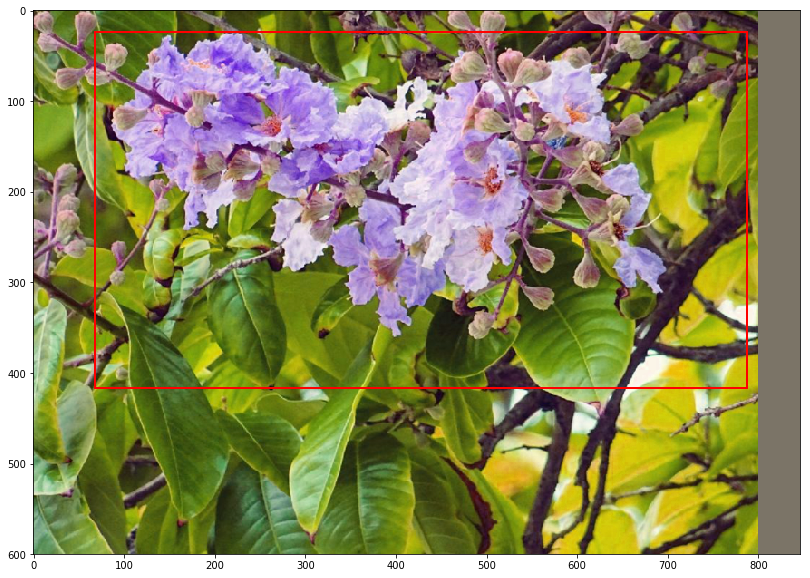

(4, 5)
2_gs_1727933.jpg [[168.46846847   0.         722.52252252 442.34234234 242.        ]]


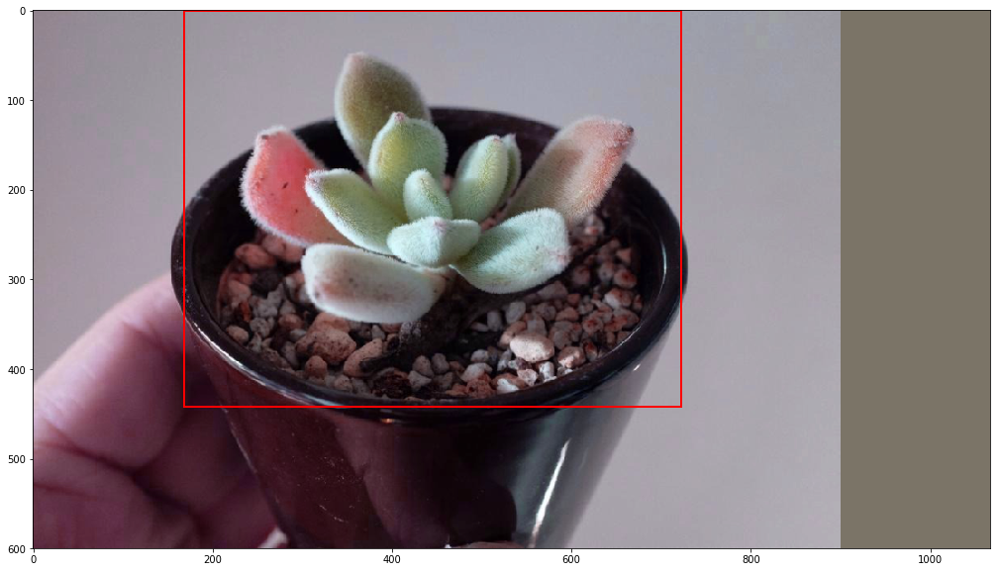

2_gs_1103708.jpg [[ 20.80427046 136.65480427 486.28469751 590.39145907 238.        ]]


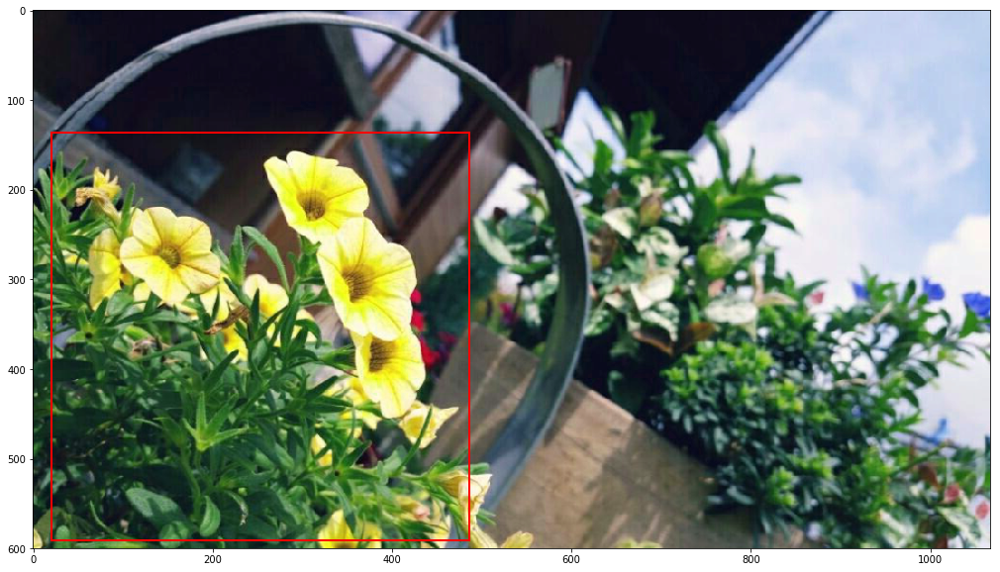

2_gs_1015364.jpg [[474.62686567 316.11940299 816.71641791 600.         160.        ]]


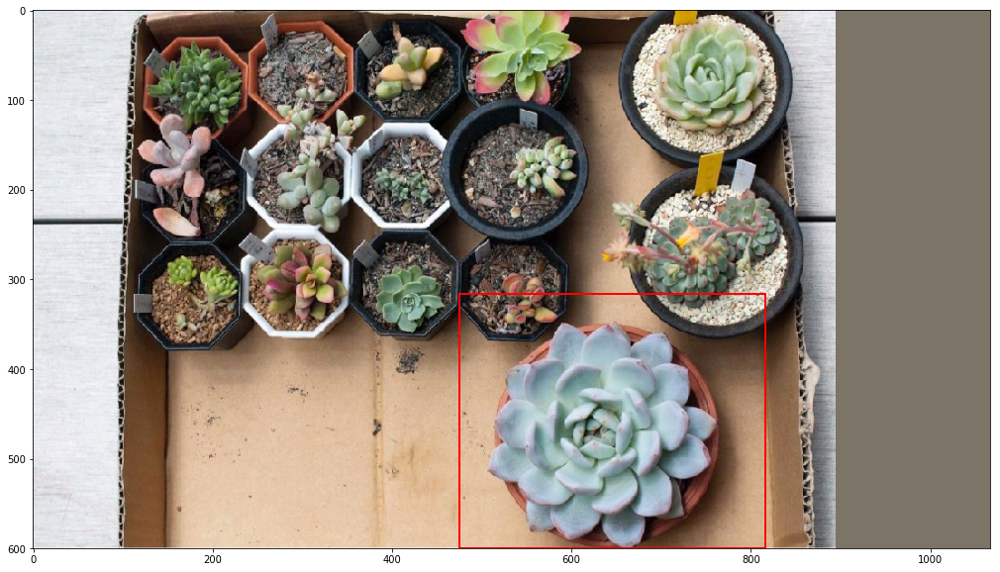

2_gs_1029069.jpg [[124.32432432  87.38738739 684.68468468 556.75675676 306.        ]]


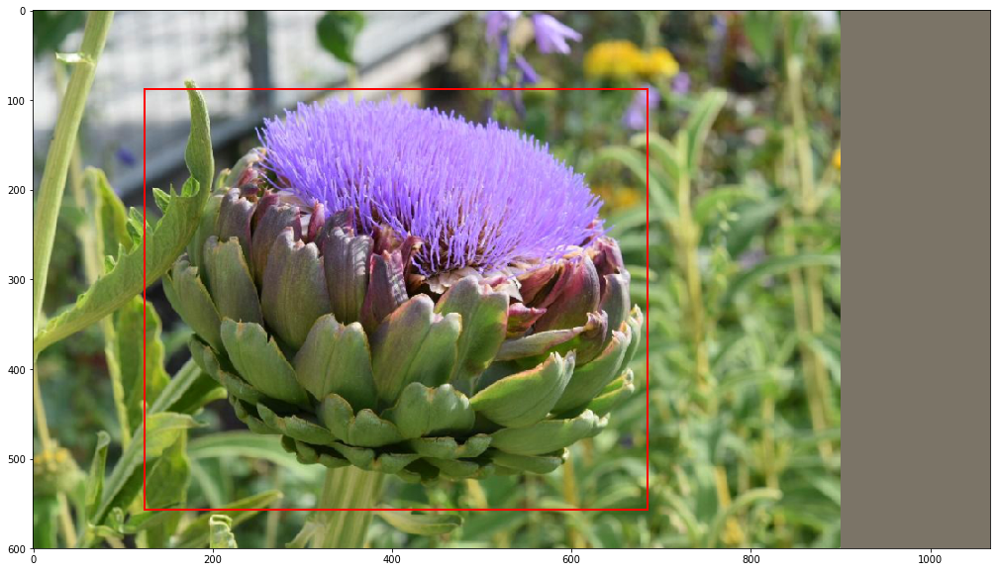

(6, 5)
2_gs_2544339.jpg [[ 91.26690391  80.07117438 179.87900356 182.56227758  35.        ]
 [645.3594306  117.43772242 755.32384342 196.44128114  35.        ]
 [783.08185053 112.09964413 911.19572954 214.59074733  35.        ]]


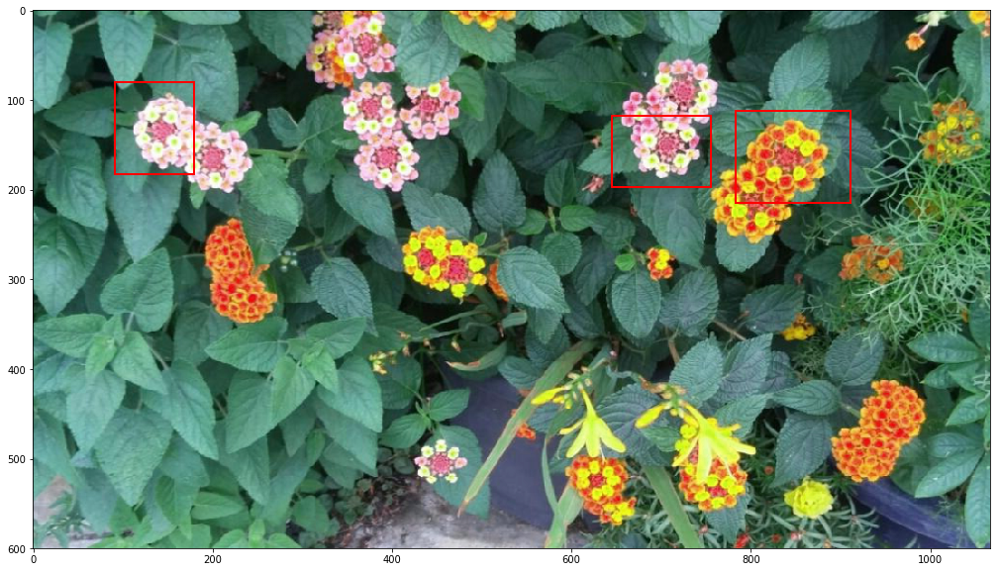

2_gs_1644406.jpg [[398.1981982  292.79279279 697.2972973  569.36936937  62.        ]]


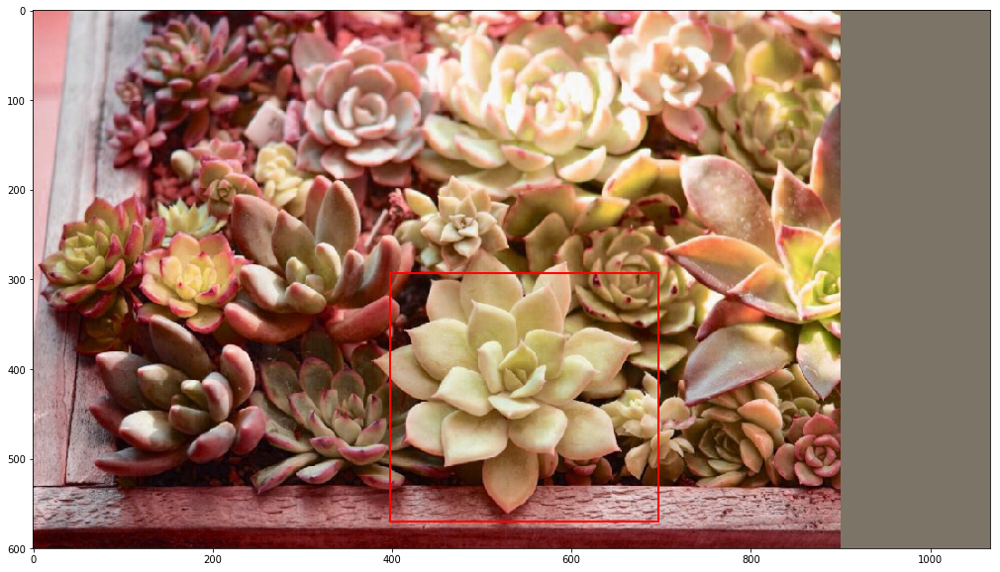

2_gs_1951801.jpg [[377.38790036 338.4341637  575.96441281 551.95729537 202.        ]]


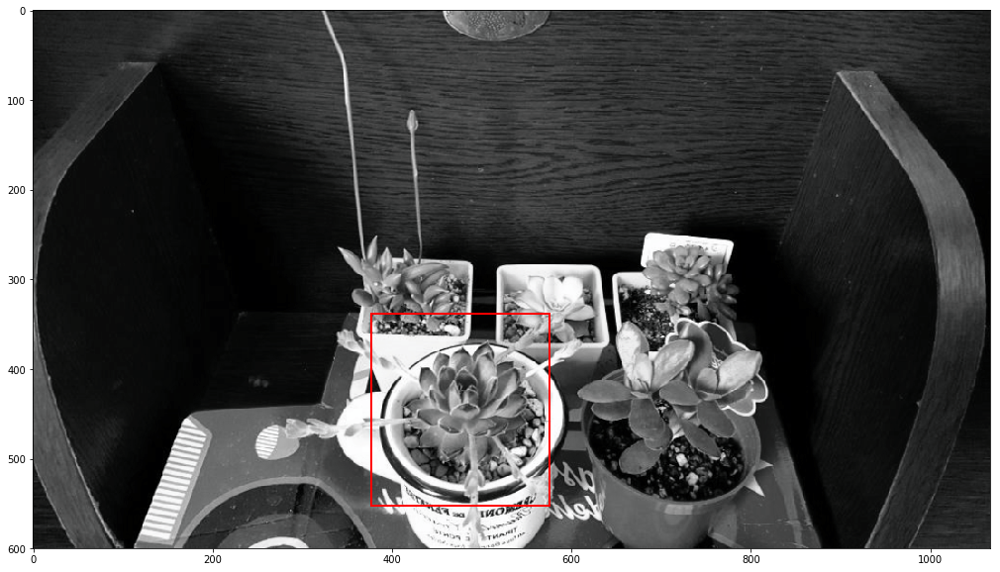

2_gs_2239502.jpg [[ 71.02803738 237.91722296 482.77703605 503.07076101 301.        ]]


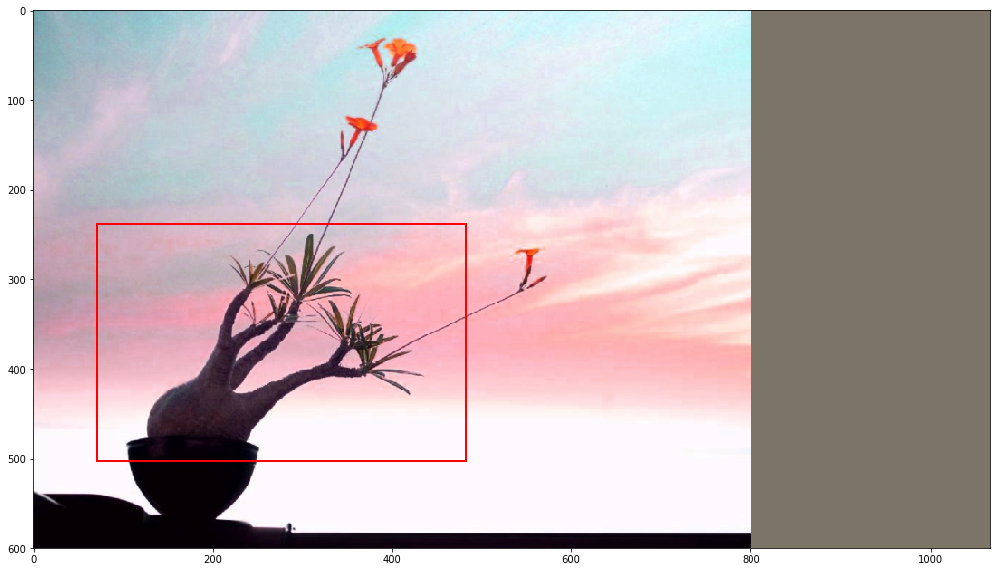

(4, 5)
2_gs_1505502.jpg [[399.05660377  86.32075472 635.37735849 309.90566038 167.        ]]


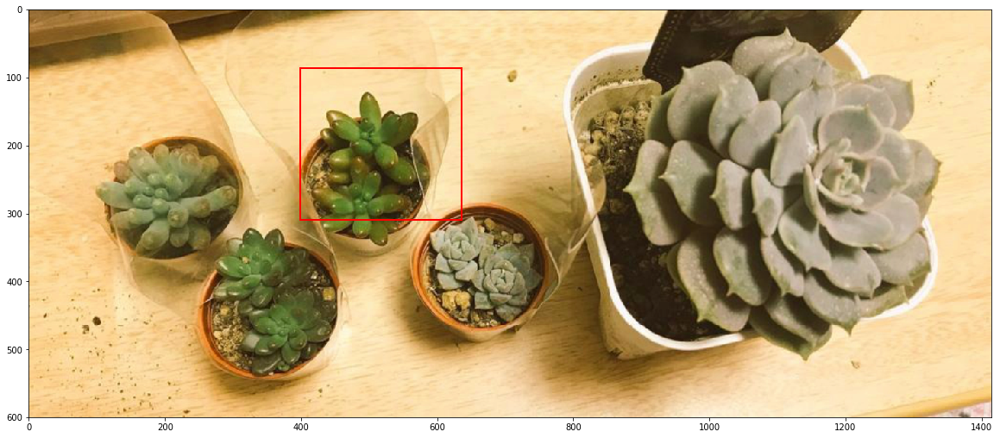

2_gs_824898.jpg [[189.18918919  21.62162162 594.59459459 600.         349.        ]]


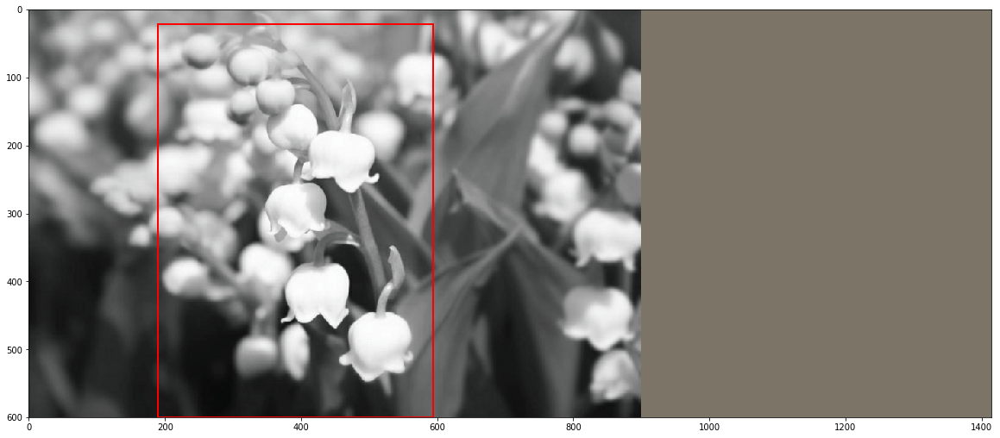

2_gs_1617641.jpg [[552.  280.  800.  571.2 239. ]]


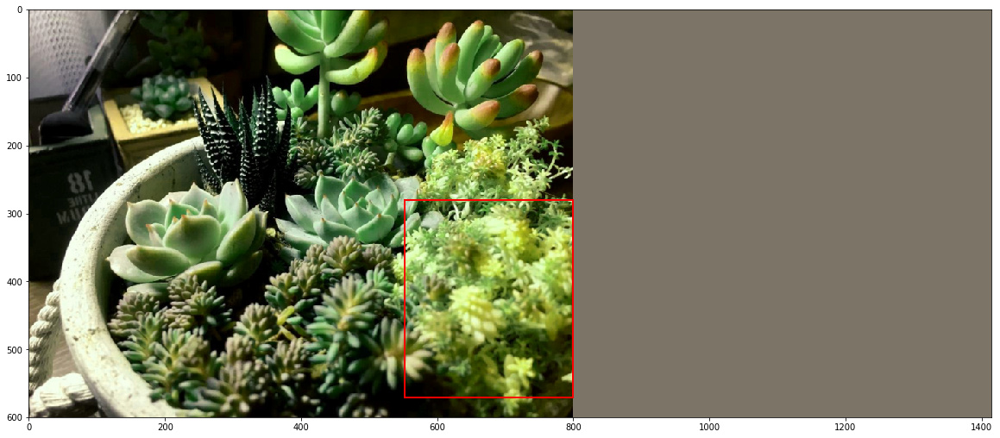

2_gs_1000267.jpg [[204.   96.8 593.6 488.8 368. ]]


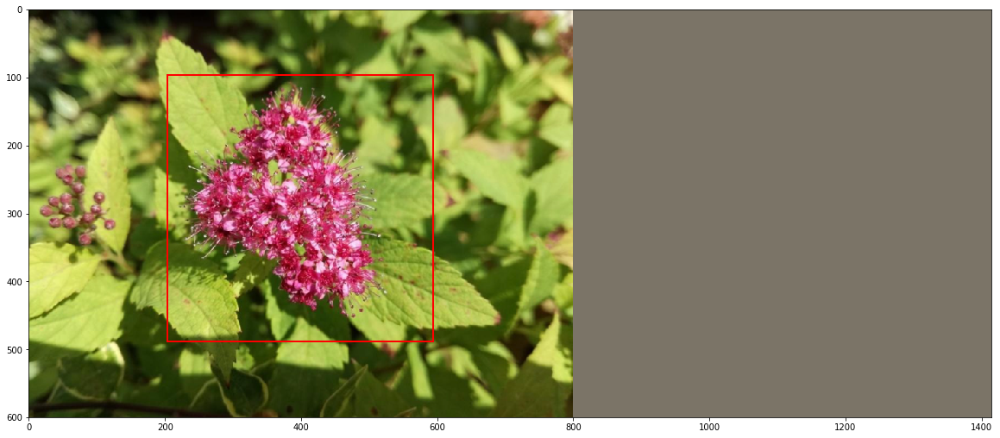

In [7]:
for i, data in enumerate(train_data_loader):
    if not data:
        continue
    if i > 3:
        break
    batch_tensor, im_info, batch_boxes, batch_boxes_index, img_names = data
    print batch_boxes.shape
    for k in range(batch_tensor.shape[0]):
        print img_names[k], batch_boxes[np.where(batch_boxes_index == k )]
        imshow(batch_tensor[k], gt_boxes=batch_boxes[ np.where(batch_boxes_index == k )])
    del batch_tensor, im_info, batch_boxes, batch_boxes_index    

Thử hiển thị ảnh cùng các bounding boxes

In [8]:
from faster_rcnn.faster_rcnn import FastRCNN

### Tính toán feed-forward


Chúng ta sử dụng một ảnh có kích thước đầu vào là  `(width , height) = (600, 800)`

Input:
    - im_data : 
        kích thước : (batch_size, dim, witdh, height)
    - ground_boxes: 
        kích thước (n, 4)
        

In [9]:
categories = ds.classes
print(categories)

['__background__', u'1009', u'100', u'1016', u'1017', u'1022', u'1028', u'1041', u'1044', u'10564', u'10576', u'1057', u'1058', u'10610', u'10641', u'1077', u'1088', u'1101', u'11262', u'1126', u'1129', u'1133', u'1136', u'1143', u'1163', u'1167', u'1173', u'1191', u'119', u'1203', u'1205', u'12122', u'1217', u'1218', u'1220', u'1221', u'1227', u'122', u'1237', u'1243', u'1245', u'1247', u'1248', u'1251', u'1258', u'1831', u'1271', u'1276', u'1277', u'1279', u'13373', u'1337', u'1354', u'1364', u'1365', u'136', u'1372', u'1382', u'1392', u'13953', u'1395', u'1396', u'1407', u'1425', u'1430', u'1431', u'1434', u'1439', u'1446', u'1457', u'1458', u'1463', u'146', u'1485', u'1486', u'1490', u'1493', u'150', u'1538', u'1541', u'1556', u'1562', u'1584', u'1589', u'1593', u'1595', u'1596', u'15', u'1603', u'16064', u'160', u'1619', u'1623', u'1624', u'1630', u'1632', u'1635', u'1638', u'1639', u'1642', u'1647', u'1653', u'1654', u'165', u'1660', u'1664', u'1666', u'1667', u'1668', u'1675', u

In [10]:
ds.label_map_dict

{u'100': 2,
 u'1009': 1,
 u'1016': 3,
 u'1017': 4,
 u'1022': 5,
 u'1028': 6,
 u'1041': 7,
 u'1044': 8,
 u'10564': 9,
 u'1057': 11,
 u'10576': 10,
 u'1058': 12,
 u'10610': 13,
 u'10641': 14,
 u'1077': 15,
 u'1088': 16,
 u'1101': 17,
 u'1126': 19,
 u'11262': 18,
 u'1129': 20,
 u'1133': 21,
 u'1136': 22,
 u'1143': 23,
 u'1163': 24,
 u'1167': 25,
 u'1173': 26,
 u'119': 28,
 u'1191': 27,
 u'1203': 29,
 u'1205': 30,
 u'12122': 31,
 u'1217': 32,
 u'1218': 33,
 u'122': 37,
 u'1220': 34,
 u'1221': 35,
 u'1227': 36,
 u'1237': 38,
 u'1243': 39,
 u'1245': 40,
 u'1247': 41,
 u'1248': 42,
 u'1251': 43,
 u'1258': 44,
 u'1271': 46,
 u'1276': 47,
 u'1277': 48,
 u'1279': 49,
 u'1337': 51,
 u'13373': 50,
 u'1354': 52,
 u'136': 55,
 u'1364': 53,
 u'1365': 54,
 u'1372': 56,
 u'1382': 57,
 u'1392': 58,
 u'1395': 60,
 u'13953': 59,
 u'1396': 61,
 u'1407': 62,
 u'1425': 63,
 u'1430': 64,
 u'1431': 65,
 u'1434': 66,
 u'1439': 67,
 u'1446': 68,
 u'1457': 69,
 u'1458': 70,
 u'146': 72,
 u'1463': 71,
 u'1485': 73

In [11]:
net = FastRCNN(categories, debug=False)
net.cuda()
net.train()

FastRCNN(
  (rpn): RPN(
    (features): DataParallel(
      (module): Sequential(
        (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace)
        (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU(inplace)
        (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (6): ReLU(inplace)
        (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (8): ReLU(inplace)
        (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (11): ReLU(inplace)
        (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (13): ReLU(inplace)
        (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (15): 

In [12]:
# net.load_state_dict(torch.load('./checkpoints_2/faster_model_at_9.pkl'))

In [13]:
param = filter(lambda x: x.requires_grad, net.parameters())
optimizer = RMSprop(param, lr=1e-5, momentum=0.9, weight_decay=0.00005)
exp_lr_scheduler = StepLR(optimizer, step_size=5000, gamma=0.99)

In [14]:
def train(data_gen ,model, tensorboard_client, metters, optimizer, lr_scheduler, current_epoch=0):
    
    steps_per_epoch = len(data_gen) 
    
    train_loss , cross_entropy_loss , loss_box, rpn_loss_box, rpn_cross_entropy_loss = metters
    for step, blobs in enumerate(data_gen):
        model.train()
        if not blobs:
            continue
        batch_tensor, im_info, batch_boxes, batch_boxes_index, img_names = blobs
        cls_prob, bbox_pred, rois, cls_score, target, rpn_cls_prob_reshape, rpn_bbox_pred, rpn_target = model(batch_tensor, im_info, batch_boxes, batch_boxes_index)
        rpn_cross_entropy, rpn_bbox_loss = model.rpn.build_loss(rpn_cls_prob_reshape, rpn_bbox_pred, rpn_target)
        cross_entropy, bbox_loss = model.build_loss(cls_score, bbox_pred, target)
        loss = rpn_cross_entropy + rpn_bbox_loss * 10 + cross_entropy + bbox_loss * 10
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        lr_scheduler.step()

        train_loss.update(loss.item())   
        cross_entropy_loss.update(cross_entropy.item())
        loss_box.update(bbox_loss.item())
        rpn_loss_box.update(rpn_bbox_loss.item())
        rpn_cross_entropy_loss.update(rpn_cross_entropy.item())

        current_step = current_epoch * steps_per_epoch + step
        if step % 10 == 1:
            log_text = 'epoch: %d : step %d,  loss: %.4f at %s' % (
                current_epoch + 1, step , train_loss.avg, datetime.now().strftime('%m/%d_%H:%M'))
            print(log_text)

        if step % 10 == 1:
            tensorboard_client.add_scalar_value('train_loss', train_loss.avg, step=current_step)
            tensorboard_client.add_scalar_value('cross_entropy', cross_entropy_loss.avg, step=current_step)
            tensorboard_client.add_scalar_value('loss_box', loss_box.avg, step=current_step)
            tensorboard_client.add_scalar_value('rpn_cross_entropy_loss', rpn_cross_entropy_loss.avg, step=current_step)
            tensorboard_client.add_scalar_value('rpn_loss_box', rpn_loss_box.avg, step=current_step)


        del loss, rpn_cross_entropy , rpn_bbox_loss , cross_entropy , bbox_loss, cls_prob, bbox_pred, rois, cls_score, target, rpn_cls_prob_reshape, rpn_bbox_pred, rpn_target

In [15]:
def validate(validate_data_gen ,model, tensorboard_client, current_epoch):
    
    steps_per_epoch = len(validate_data_gen)
    
    train_loss = AverageMeter()
    
    for step, blobs in enumerate(validate_data_gen):
        with torch.no_grad():
            model.train()
            if not blobs:
                continue
            batch_tensor, im_info, batch_boxes, batch_boxes_index, img_names = blobs
            cls_prob, bbox_pred, rois, cls_score, target, rpn_cls_prob_reshape, rpn_bbox_pred, rpn_target = model(batch_tensor, im_info, batch_boxes, batch_boxes_index)
            rpn_cross_entropy, rpn_bbox_loss = model.rpn.build_loss(rpn_cls_prob_reshape, rpn_bbox_pred, rpn_target)
            cross_entropy, bbox_loss = model.build_loss(cls_score, bbox_pred, target)
            loss = rpn_cross_entropy + rpn_bbox_loss * 10 + cross_entropy + bbox_loss * 10

            train_loss.update(loss.item())     

            current_step = current_epoch * steps_per_epoch + step
            if step % 10 == 1:
                log_text = 'epoch: %d : step %d,  val_loss: %.4f at %s' % (
                    current_epoch + 1, step , train_loss.avg, datetime.now().strftime('%m/%d_%H:%M'))
                print(log_text)
        
    tensorboard_client.add_scalar_value('val_loss', train_loss.avg, step=current_epoch)



In [16]:
def training(data, val_data, optimizer, lr_scheduler ,model, epochs=10):
    
    exp_name = datetime.now().strftime('vgg16_%m-%d_%H-%M3')
    cc = CrayonClient(hostname="crayon", port=8889)
    exp = cc.create_experiment(exp_name)
    
    
    train_loss = AverageMeter()
    cross_entropy = AverageMeter()
    loss_box = AverageMeter()
    rpn_loss_box = AverageMeter()
    rpn_cross_entropy = AverageMeter()
    metters = (train_loss , cross_entropy , loss_box, rpn_loss_box, rpn_cross_entropy)

    for epoch in range(epochs):
        train(data ,model, exp, metters, optimizer, lr_scheduler, epoch)
        validate(val_data ,model, exp, epoch)
        torch.save(net.state_dict(), './checkpoints/faster_model_at_%d.pkl' % epoch) 

In [ ]:
training(train_data_loader, val_data_loader ,optimizer=optimizer,lr_scheduler=exp_lr_scheduler, model=net, epochs=50)

faster_rcnn/rpn_msr/anchor_target_layer.py:333: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  current_batch_boxes = batch_boxes[[batch_boxes_index == i]]
faster_rcnn/rpn_msr/proposal_target_layer.py:75: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  current_gt_boxes = gt_boxes[[gt_boxes_index == i]]
faster_rcnn/faster_rcnn.py:266: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  cls_prob = F.softmax(cls_score)


epoch: 1 : step 1,  loss: 11.0124 at 11/30_16:59


DEBUG:root:23


epoch: 1 : step 11,  loss: 6.8886 at 11/30_17:00
epoch: 1 : step 21,  loss: 6.2627 at 11/30_17:00
epoch: 1 : step 31,  loss: 5.9503 at 11/30_17:00


DEBUG:root:25


epoch: 1 : step 41,  loss: 5.7080 at 11/30_17:00


DEBUG:root:3
DEBUG:root:17
DEBUG:root:11


epoch: 1 : step 51,  loss: 5.5814 at 11/30_17:01
epoch: 1 : step 61,  loss: 5.4584 at 11/30_17:01
epoch: 1 : step 71,  loss: 5.3689 at 11/30_17:01


DEBUG:root:15
DEBUG:root:27


epoch: 1 : step 81,  loss: 5.2688 at 11/30_17:01


DEBUG:root:24
DEBUG:root:14
DEBUG:root:21


epoch: 1 : step 91,  loss: 5.2168 at 11/30_17:01


DEBUG:root:13
DEBUG:root:29


epoch: 1 : step 101,  loss: 5.1630 at 11/30_17:02


DEBUG:root:5
DEBUG:root:0


epoch: 1 : step 111,  loss: 5.1143 at 11/30_17:02
epoch: 1 : step 121,  loss: 5.0762 at 11/30_17:02


DEBUG:root:3


epoch: 1 : step 131,  loss: 5.0411 at 11/30_17:02


DEBUG:root:8


epoch: 1 : step 141,  loss: 5.0199 at 11/30_17:02
epoch: 1 : step 151,  loss: 4.9854 at 11/30_17:03


DEBUG:root:11


epoch: 1 : step 161,  loss: 4.9689 at 11/30_17:03


DEBUG:root:29


epoch: 1 : step 171,  loss: 4.9414 at 11/30_17:03
epoch: 1 : step 181,  loss: 4.9188 at 11/30_17:03


DEBUG:root:11
DEBUG:root:1
DEBUG:root:15


epoch: 1 : step 191,  loss: 4.8854 at 11/30_17:03
epoch: 1 : step 201,  loss: 4.8676 at 11/30_17:04


DEBUG:root:24


epoch: 1 : step 211,  loss: 4.8530 at 11/30_17:04


DEBUG:root:21
DEBUG:root:29
DEBUG:root:14


epoch: 1 : step 221,  loss: 4.8484 at 11/30_17:04


DEBUG:root:14


epoch: 1 : step 231,  loss: 4.8232 at 11/30_17:04


DEBUG:root:22
DEBUG:root:5
DEBUG:root:29


epoch: 1 : step 241,  loss: 4.8032 at 11/30_17:04


DEBUG:root:19
DEBUG:root:3


epoch: 1 : step 251,  loss: 4.7910 at 11/30_17:05


DEBUG:root:18


epoch: 1 : step 261,  loss: 4.7784 at 11/30_17:05
epoch: 1 : step 271,  loss: 4.7661 at 11/30_17:05
epoch: 1 : step 281,  loss: 4.7515 at 11/30_17:05


DEBUG:root:21
DEBUG:root:25


epoch: 1 : step 291,  loss: 4.7443 at 11/30_17:05


DEBUG:root:25


epoch: 1 : step 301,  loss: 4.7349 at 11/30_17:06


DEBUG:root:2
DEBUG:root:23


epoch: 1 : step 311,  loss: 4.7235 at 11/30_17:06
epoch: 1 : step 321,  loss: 4.7187 at 11/30_17:06


DEBUG:root:21


epoch: 1 : step 331,  loss: 4.7111 at 11/30_17:06
epoch: 1 : step 341,  loss: 4.7071 at 11/30_17:06


DEBUG:root:5
DEBUG:root:23
DEBUG:root:25


epoch: 1 : step 351,  loss: 4.7013 at 11/30_17:07


DEBUG:root:26
DEBUG:root:12


epoch: 1 : step 361,  loss: 4.6925 at 11/30_17:07


DEBUG:root:2


epoch: 1 : step 371,  loss: 4.6857 at 11/30_17:07


DEBUG:root:26


epoch: 1 : step 381,  loss: 4.6674 at 11/30_17:07
epoch: 1 : step 391,  loss: 4.6603 at 11/30_17:07


DEBUG:root:0


epoch: 1 : step 401,  loss: 4.6531 at 11/30_17:08


DEBUG:root:15
DEBUG:root:24
DEBUG:root:8


epoch: 1 : step 411,  loss: 4.6472 at 11/30_17:08


DEBUG:root:5
DEBUG:root:28


epoch: 1 : step 421,  loss: 4.6394 at 11/30_17:08
epoch: 1 : step 431,  loss: 4.6288 at 11/30_17:08


DEBUG:root:13
DEBUG:root:26


epoch: 1 : step 441,  loss: 4.6209 at 11/30_17:08


DEBUG:root:5


epoch: 1 : step 451,  loss: 4.6148 at 11/30_17:09


DEBUG:root:5
DEBUG:root:11
DEBUG:root:17


epoch: 1 : step 461,  loss: 4.6138 at 11/30_17:09


DEBUG:root:0
DEBUG:root:28


epoch: 1 : step 471,  loss: 4.6094 at 11/30_17:09
epoch: 1 : step 481,  loss: 4.6013 at 11/30_17:09


DEBUG:root:20
DEBUG:root:16


epoch: 1 : step 491,  loss: 4.5943 at 11/30_17:09
epoch: 1 : step 501,  loss: 4.5928 at 11/30_17:10


DEBUG:root:0


epoch: 1 : step 511,  loss: 4.5916 at 11/30_17:10


DEBUG:root:22
DEBUG:root:29


epoch: 1 : step 521,  loss: 4.5889 at 11/30_17:10


DEBUG:root:26
DEBUG:root:12
DEBUG:root:15
DEBUG:root:7
DEBUG:root:25


epoch: 1 : step 531,  loss: 4.5843 at 11/30_17:10
epoch: 1 : step 541,  loss: 4.5816 at 11/30_17:10


DEBUG:root:17
DEBUG:root:26


epoch: 1 : step 551,  loss: 4.5802 at 11/30_17:11
epoch: 1 : step 561,  loss: 4.5789 at 11/30_17:11
epoch: 1 : step 571,  loss: 4.5727 at 11/30_17:11


DEBUG:root:22


epoch: 1 : step 581,  loss: 4.5701 at 11/30_17:11


DEBUG:root:20


epoch: 1 : step 591,  loss: 4.5711 at 11/30_17:11


DEBUG:root:21


epoch: 1 : step 601,  loss: 4.5686 at 11/30_17:12


DEBUG:root:19


epoch: 1 : step 611,  loss: 4.5658 at 11/30_17:12
epoch: 1 : step 621,  loss: 4.5660 at 11/30_17:12


DEBUG:root:18


epoch: 1 : step 631,  loss: 4.5647 at 11/30_17:12


DEBUG:root:23


epoch: 1 : step 641,  loss: 4.5643 at 11/30_17:12
epoch: 1 : step 651,  loss: 4.5625 at 11/30_17:13


DEBUG:root:28
DEBUG:root:28


epoch: 1 : step 661,  loss: 4.5600 at 11/30_17:13
epoch: 1 : step 671,  loss: 4.5553 at 11/30_17:13
epoch: 1 : step 681,  loss: 4.5517 at 11/30_17:13
epoch: 1 : step 691,  loss: 4.5467 at 11/30_17:13
epoch: 1 : step 701,  loss: 4.5438 at 11/30_17:14


DEBUG:root:22
DEBUG:root:27


epoch: 1 : step 711,  loss: 4.5409 at 11/30_17:14
epoch: 1 : step 721,  loss: 4.5378 at 11/30_17:14
epoch: 1 : step 731,  loss: 4.5360 at 11/30_17:14


DEBUG:root:1
DEBUG:root:24


epoch: 1 : step 741,  loss: 4.5312 at 11/30_17:15


DEBUG:root:18


epoch: 1 : step 751,  loss: 4.5284 at 11/30_17:15
epoch: 1 : step 761,  loss: 4.5239 at 11/30_17:15


DEBUG:root:9


epoch: 1 : step 771,  loss: 4.5199 at 11/30_17:15


DEBUG:root:3


epoch: 1 : step 781,  loss: 4.5154 at 11/30_17:15


DEBUG:root:26


epoch: 1 : step 791,  loss: 4.5150 at 11/30_17:16
epoch: 1 : step 801,  loss: 4.5125 at 11/30_17:16
epoch: 1 : step 811,  loss: 4.5111 at 11/30_17:16


DEBUG:root:28


epoch: 1 : step 821,  loss: 4.5106 at 11/30_17:16
epoch: 1 : step 831,  loss: 4.5096 at 11/30_17:16
epoch: 1 : step 841,  loss: 4.5077 at 11/30_17:17
epoch: 1 : step 851,  loss: 4.5074 at 11/30_17:17
epoch: 1 : step 861,  loss: 4.5056 at 11/30_17:17
[117.0, 108.0, 120.0, 108.0] (259, 194) /data/data/tmp/9_output/Annotations/1_google_76.xml
epoch: 1 : step 871,  loss: 4.5045 at 11/30_17:17
epoch: 1 : step 881,  loss: 4.5025 at 11/30_17:17
epoch: 1 : step 891,  loss: 4.5012 at 11/30_17:18


DEBUG:root:22
DEBUG:root:20
DEBUG:root:18


epoch: 1 : step 901,  loss: 4.4988 at 11/30_17:18


DEBUG:root:26
DEBUG:root:24
DEBUG:root:7


epoch: 1 : step 911,  loss: 4.4974 at 11/30_17:18


DEBUG:root:25
DEBUG:root:28
DEBUG:root:16


epoch: 1 : step 921,  loss: 4.4975 at 11/30_17:18


DEBUG:root:13


epoch: 1 : step 931,  loss: 4.4933 at 11/30_17:18


DEBUG:root:16


[117.0, 108.0, 120.0, 108.0] (259, 194) /data/data/tmp/9_output/Annotations/1_google_76.xml
epoch: 1 : step 941,  loss: 4.4915 at 11/30_17:19
epoch: 1 : step 951,  loss: 4.4907 at 11/30_17:19


DEBUG:root:27
DEBUG:root:24


epoch: 1 : step 961,  loss: 4.4873 at 11/30_17:19
epoch: 1 : step 971,  loss: 4.4854 at 11/30_17:19
epoch: 1 : step 981,  loss: 4.4850 at 11/30_17:19


DEBUG:root:11
DEBUG:root:27
DEBUG:root:8


epoch: 1 : step 991,  loss: 4.4822 at 11/30_17:20


DEBUG:root:22


epoch: 1 : step 1001,  loss: 4.4793 at 11/30_17:20


DEBUG:root:16
DEBUG:root:4


epoch: 1 : step 1011,  loss: 4.4757 at 11/30_17:20


DEBUG:root:25
DEBUG:root:17


epoch: 1 : step 1021,  loss: 4.4771 at 11/30_17:20


DEBUG:root:27


epoch: 1 : step 1031,  loss: 4.4761 at 11/30_17:20
epoch: 1 : step 1041,  loss: 4.4750 at 11/30_17:21
epoch: 1 : step 1051,  loss: 4.4717 at 11/30_17:21


DEBUG:root:26


epoch: 1 : step 1061,  loss: 4.4705 at 11/30_17:21


DEBUG:root:20


epoch: 1 : step 1071,  loss: 4.4697 at 11/30_17:21
epoch: 1 : step 1081,  loss: 4.4680 at 11/30_17:21
epoch: 1 : step 1091,  loss: 4.4683 at 11/30_17:22
epoch: 1 : step 1101,  loss: 4.4677 at 11/30_17:22


DEBUG:root:11


epoch: 1 : step 1111,  loss: 4.4677 at 11/30_17:22


DEBUG:root:25


epoch: 1 : step 1121,  loss: 4.4687 at 11/30_17:22
epoch: 1 : step 1131,  loss: 4.4673 at 11/30_17:22


DEBUG:root:23


epoch: 1 : step 1141,  loss: 4.4678 at 11/30_17:23


DEBUG:root:16


epoch: 1 : step 1151,  loss: 4.4658 at 11/30_17:23


DEBUG:root:10
DEBUG:root:27
DEBUG:root:0


epoch: 1 : step 1161,  loss: 4.4643 at 11/30_17:23


DEBUG:root:27


epoch: 1 : step 1171,  loss: 4.4634 at 11/30_17:23
epoch: 1 : step 1181,  loss: 4.4614 at 11/30_17:23


DEBUG:root:22


epoch: 1 : step 1191,  loss: 4.4603 at 11/30_17:24
epoch: 1 : step 1201,  loss: 4.4606 at 11/30_17:24


DEBUG:root:23
DEBUG:root:11


epoch: 1 : step 1211,  loss: 4.4607 at 11/30_17:24
epoch: 1 : step 1221,  loss: 4.4594 at 11/30_17:24


DEBUG:root:0


epoch: 1 : step 1231,  loss: 4.4583 at 11/30_17:24
epoch: 1 : step 1241,  loss: 4.4562 at 11/30_17:25


DEBUG:root:24


epoch: 1 : step 1251,  loss: 4.4561 at 11/30_17:25


DEBUG:root:0


epoch: 1 : step 1261,  loss: 4.4565 at 11/30_17:25


DEBUG:root:10


epoch: 1 : step 1271,  loss: 4.4561 at 11/30_17:25


DEBUG:root:5


epoch: 1 : step 1281,  loss: 4.4561 at 11/30_17:25
epoch: 1 : step 1291,  loss: 4.4583 at 11/30_17:26


DEBUG:root:14


epoch: 1 : step 1301,  loss: 4.4584 at 11/30_17:26


DEBUG:root:26


epoch: 1 : step 1311,  loss: 4.4597 at 11/30_17:26


DEBUG:root:19


epoch: 1 : step 1321,  loss: 4.4594 at 11/30_17:26
epoch: 1 : step 1331,  loss: 4.4585 at 11/30_17:26
epoch: 1 : step 1341,  loss: 4.4583 at 11/30_17:27
epoch: 1 : step 1351,  loss: 4.4574 at 11/30_17:27


DEBUG:root:4
DEBUG:root:27


epoch: 1 : step 1361,  loss: 4.4575 at 11/30_17:27


DEBUG:root:20


epoch: 1 : step 1371,  loss: 4.4552 at 11/30_17:27
epoch: 1 : step 1471,  loss: 4.4495 at 11/30_17:29
epoch: 1 : step 1481,  loss: 4.4488 at 11/30_17:30
epoch: 1 : step 1491,  loss: 4.4478 at 11/30_17:30


DEBUG:root:20
DEBUG:root:28


epoch: 1 : step 1501,  loss: 4.4464 at 11/30_17:30
epoch: 1 : step 1511,  loss: 4.4453 at 11/30_17:30


DEBUG:root:22


epoch: 1 : step 1521,  loss: 4.4445 at 11/30_17:30


DEBUG:root:0
DEBUG:root:10


epoch: 1 : step 1531,  loss: 4.4446 at 11/30_17:31
epoch: 1 : step 1541,  loss: 4.4447 at 11/30_17:31
epoch: 1 : step 1551,  loss: 4.4446 at 11/30_17:31


DEBUG:root:23
DEBUG:root:6


epoch: 1 : step 1561,  loss: 4.4445 at 11/30_17:31
epoch: 1 : step 1571,  loss: 4.4468 at 11/30_17:31
epoch: 1 : step 1581,  loss: 4.4481 at 11/30_17:31
epoch: 1 : step 1591,  loss: 4.4483 at 11/30_17:32
epoch: 1 : step 1601,  loss: 4.4491 at 11/30_17:32
epoch: 1 : step 1611,  loss: 4.4506 at 11/30_17:32


DEBUG:root:8


epoch: 1 : step 1621,  loss: 4.4513 at 11/30_17:32
epoch: 1 : step 1631,  loss: 4.4526 at 11/30_17:32


DEBUG:root:25


epoch: 1 : step 1641,  loss: 4.4537 at 11/30_17:33
epoch: 1 : step 1651,  loss: 4.4543 at 11/30_17:33


DEBUG:root:19


epoch: 1 : step 1661,  loss: 4.4546 at 11/30_17:33
epoch: 1 : step 1671,  loss: 4.4545 at 11/30_17:33
epoch: 1 : step 1681,  loss: 4.4541 at 11/30_17:33
epoch: 1 : step 1691,  loss: 4.4533 at 11/30_17:33
epoch: 1 : step 1701,  loss: 4.4535 at 11/30_17:34


DEBUG:root:14


epoch: 1 : step 1711,  loss: 4.4537 at 11/30_17:34
epoch: 1 : step 1721,  loss: 4.4539 at 11/30_17:34
epoch: 1 : step 1731,  loss: 4.4542 at 11/30_17:34
epoch: 1 : step 1741,  loss: 4.4542 at 11/30_17:34
epoch: 1 : step 1751,  loss: 4.4529 at 11/30_17:34
epoch: 1 : step 1761,  loss: 4.4525 at 11/30_17:35
epoch: 1 : step 1771,  loss: 4.4520 at 11/30_17:35
epoch: 1 : step 1781,  loss: 4.4518 at 11/30_17:35
epoch: 1 : step 1791,  loss: 4.4522 at 11/30_17:35
epoch: 1 : step 1801,  loss: 4.4522 at 11/30_17:35
epoch: 1 : step 1811,  loss: 4.4516 at 11/30_17:36
epoch: 1 : step 1821,  loss: 4.4504 at 11/30_17:36
epoch: 1 : step 1831,  loss: 4.4508 at 11/30_17:36
epoch: 1 : step 1841,  loss: 4.4492 at 11/30_17:36
epoch: 1 : step 1851,  loss: 4.4490 at 11/30_17:36
epoch: 1 : step 1861,  loss: 4.4484 at 11/30_17:36
epoch: 1 : step 1871,  loss: 4.4478 at 11/30_17:37
epoch: 1 : step 1881,  loss: 4.4466 at 11/30_17:37
epoch: 1 : step 1891,  loss: 4.4473 at 11/30_17:37
epoch: 1 : step 1901,  loss: 4.

DEBUG:root:7


epoch: 1 : step 2081,  loss: 4.4368 at 11/30_17:40
epoch: 1 : step 2091,  loss: 4.4360 at 11/30_17:41
epoch: 1 : step 2101,  loss: 4.4350 at 11/30_17:41
epoch: 1 : step 2111,  loss: 4.4346 at 11/30_17:41
epoch: 1 : step 2121,  loss: 4.4334 at 11/30_17:41
epoch: 1 : step 2131,  loss: 4.4327 at 11/30_17:41
epoch: 1 : step 2141,  loss: 4.4330 at 11/30_17:41
epoch: 1 : step 2151,  loss: 4.4318 at 11/30_17:42
epoch: 1 : step 2161,  loss: 4.4315 at 11/30_17:42
epoch: 1 : step 2171,  loss: 4.4305 at 11/30_17:42
epoch: 1 : step 2181,  loss: 4.4297 at 11/30_17:42
epoch: 1 : step 2191,  loss: 4.4288 at 11/30_17:42
epoch: 1 : step 2201,  loss: 4.4283 at 11/30_17:42
epoch: 1 : step 2211,  loss: 4.4276 at 11/30_17:43
epoch: 1 : step 2221,  loss: 4.4270 at 11/30_17:43
epoch: 1 : step 2231,  loss: 4.4263 at 11/30_17:43
epoch: 1 : step 2241,  loss: 4.4255 at 11/30_17:43
epoch: 1 : step 2251,  loss: 4.4241 at 11/30_17:43
epoch: 1 : step 2261,  loss: 4.4230 at 11/30_17:43
epoch: 1 : step 2271,  loss: 4.

DEBUG:root:22


epoch: 1 : step 2441,  loss: 4.4130 at 11/30_17:47
epoch: 1 : step 2451,  loss: 4.4128 at 11/30_17:47
epoch: 1 : step 2461,  loss: 4.4122 at 11/30_17:47
epoch: 1 : step 2471,  loss: 4.4116 at 11/30_17:47
epoch: 1 : step 2481,  loss: 4.4111 at 11/30_17:47
epoch: 1 : step 2491,  loss: 4.4101 at 11/30_17:48
epoch: 1 : step 2501,  loss: 4.4089 at 11/30_17:48
epoch: 1 : step 2511,  loss: 4.4085 at 11/30_17:48
epoch: 1 : step 2521,  loss: 4.4079 at 11/30_17:48


DEBUG:root:5


epoch: 1 : step 2531,  loss: 4.4078 at 11/30_17:48
epoch: 1 : step 2541,  loss: 4.4064 at 11/30_17:48
epoch: 1 : step 2551,  loss: 4.4058 at 11/30_17:49
epoch: 1 : step 2561,  loss: 4.4051 at 11/30_17:49
epoch: 1 : step 2571,  loss: 4.4046 at 11/30_17:49
epoch: 1 : step 2581,  loss: 4.4046 at 11/30_17:49
epoch: 1 : step 2591,  loss: 4.4039 at 11/30_17:49
epoch: 1 : step 2601,  loss: 4.4027 at 11/30_17:49
epoch: 1 : step 2611,  loss: 4.4014 at 11/30_17:50
epoch: 1 : step 2621,  loss: 4.4005 at 11/30_17:50
epoch: 1 : step 2631,  loss: 4.3999 at 11/30_17:50
epoch: 1 : step 2641,  loss: 4.3998 at 11/30_17:50
epoch: 1 : step 2651,  loss: 4.3993 at 11/30_17:50
epoch: 1 : step 2661,  loss: 4.3992 at 11/30_17:50
epoch: 1 : step 2671,  loss: 4.3980 at 11/30_17:51
epoch: 1 : step 2681,  loss: 4.3974 at 11/30_17:51
epoch: 1 : step 2691,  loss: 4.3965 at 11/30_17:51
epoch: 1 : step 2701,  loss: 4.3948 at 11/30_17:51
epoch: 1 : step 2711,  loss: 4.3944 at 11/30_17:51


DEBUG:root:0
DEBUG:root:23


epoch: 1 : step 2721,  loss: 4.3949 at 11/30_17:52
epoch: 1 : step 2731,  loss: 4.3946 at 11/30_17:52
epoch: 1 : step 2741,  loss: 4.3931 at 11/30_17:52
epoch: 1 : step 2751,  loss: 4.3917 at 11/30_17:52
epoch: 1 : step 2761,  loss: 4.3914 at 11/30_17:52
epoch: 1 : step 2771,  loss: 4.3920 at 11/30_17:52
epoch: 1 : step 2781,  loss: 4.3918 at 11/30_17:53
epoch: 1 : step 2791,  loss: 4.3908 at 11/30_17:53
epoch: 1 : step 2801,  loss: 4.3905 at 11/30_17:53
epoch: 1 : step 2811,  loss: 4.3897 at 11/30_17:53
epoch: 1 : step 2821,  loss: 4.3890 at 11/30_17:53
epoch: 1 : step 2831,  loss: 4.3877 at 11/30_17:53
epoch: 1 : step 2841,  loss: 4.3873 at 11/30_17:54


DEBUG:root:21


epoch: 1 : step 2851,  loss: 4.3859 at 11/30_17:54


DEBUG:root:20


epoch: 1 : step 2861,  loss: 4.3849 at 11/30_17:54
epoch: 1 : step 2871,  loss: 4.3848 at 11/30_17:54
epoch: 1 : step 2881,  loss: 4.3846 at 11/30_17:54
epoch: 1 : step 2891,  loss: 4.3844 at 11/30_17:55
epoch: 1 : step 2901,  loss: 4.3834 at 11/30_17:55
epoch: 1 : step 2911,  loss: 4.3832 at 11/30_17:55
epoch: 1 : step 2921,  loss: 4.3827 at 11/30_17:55


DEBUG:root:3


epoch: 1 : step 2931,  loss: 4.3826 at 11/30_17:55
epoch: 1 : step 2941,  loss: 4.3823 at 11/30_17:55


DEBUG:root:0


epoch: 1 : step 2951,  loss: 4.3824 at 11/30_17:56
epoch: 1 : step 2961,  loss: 4.3824 at 11/30_17:56
epoch: 1 : step 2971,  loss: 4.3818 at 11/30_17:56
epoch: 1 : step 2981,  loss: 4.3812 at 11/30_17:56
epoch: 1 : step 2991,  loss: 4.3804 at 11/30_17:56
epoch: 1 : step 3001,  loss: 4.3797 at 11/30_17:56
epoch: 1 : step 3011,  loss: 4.3787 at 11/30_17:57
epoch: 1 : step 3021,  loss: 4.3776 at 11/30_17:57


DEBUG:root:29


epoch: 1 : step 3031,  loss: 4.3767 at 11/30_17:57
epoch: 1 : step 3041,  loss: 4.3759 at 11/30_17:57
epoch: 1 : step 3051,  loss: 4.3752 at 11/30_17:57
epoch: 1 : step 3061,  loss: 4.3746 at 11/30_17:57
epoch: 1 : step 3071,  loss: 4.3744 at 11/30_17:58
epoch: 1 : step 3081,  loss: 4.3738 at 11/30_17:58
epoch: 1 : step 3091,  loss: 4.3731 at 11/30_17:58
epoch: 1 : step 3101,  loss: 4.3726 at 11/30_17:58
epoch: 1 : step 3111,  loss: 4.3720 at 11/30_17:58
epoch: 1 : step 3121,  loss: 4.3720 at 11/30_17:59
epoch: 1 : step 3131,  loss: 4.3724 at 11/30_17:59
epoch: 1 : step 3141,  loss: 4.3725 at 11/30_17:59
epoch: 1 : step 3151,  loss: 4.3726 at 11/30_17:59
epoch: 1 : step 3161,  loss: 4.3725 at 11/30_17:59
epoch: 1 : step 3171,  loss: 4.3721 at 11/30_17:59
epoch: 1 : step 3181,  loss: 4.3720 at 11/30_17:59
epoch: 1 : step 3191,  loss: 4.3715 at 11/30_18:00
epoch: 1 : step 3201,  loss: 4.3716 at 11/30_18:00
epoch: 1 : step 3211,  loss: 4.3713 at 11/30_18:00
epoch: 1 : step 3221,  loss: 4.

DEBUG:root:29


epoch: 1 : step 4111,  loss: 4.3427 at 11/30_18:14
epoch: 1 : step 4121,  loss: 4.3418 at 11/30_18:14
epoch: 1 : step 4131,  loss: 4.3408 at 11/30_18:14
epoch: 1 : step 4141,  loss: 4.3401 at 11/30_18:14
epoch: 1 : step 4151,  loss: 4.3398 at 11/30_18:14
epoch: 1 : step 4161,  loss: 4.3397 at 11/30_18:14
epoch: 1 : step 4171,  loss: 4.3393 at 11/30_18:15
epoch: 1 : step 4181,  loss: 4.3391 at 11/30_18:15
epoch: 1 : step 4191,  loss: 4.3387 at 11/30_18:15
epoch: 1 : step 4201,  loss: 4.3381 at 11/30_18:15
epoch: 1 : step 4211,  loss: 4.3372 at 11/30_18:15
epoch: 1 : step 4221,  loss: 4.3371 at 11/30_18:15
epoch: 1 : step 4231,  loss: 4.3366 at 11/30_18:16
epoch: 1 : step 4241,  loss: 4.3359 at 11/30_18:16
epoch: 1 : step 4251,  loss: 4.3356 at 11/30_18:16
epoch: 1 : step 4261,  loss: 4.3352 at 11/30_18:16
epoch: 1 : step 4271,  loss: 4.3350 at 11/30_18:16
epoch: 1 : step 4281,  loss: 4.3348 at 11/30_18:16
epoch: 1 : step 4291,  loss: 4.3342 at 11/30_18:16
epoch: 1 : step 4301,  loss: 4.

DEBUG:root:26


epoch: 1 : step 4481,  loss: 4.3259 at 11/30_18:19
epoch: 1 : step 4491,  loss: 4.3252 at 11/30_18:19
epoch: 1 : step 4501,  loss: 4.3249 at 11/30_18:20
epoch: 1 : step 4511,  loss: 4.3245 at 11/30_18:20
epoch: 1 : step 4521,  loss: 4.3240 at 11/30_18:20
epoch: 1 : step 4531,  loss: 4.3237 at 11/30_18:20
epoch: 1 : step 4541,  loss: 4.3231 at 11/30_18:20
epoch: 1 : step 4551,  loss: 4.3222 at 11/30_18:20
epoch: 1 : step 4561,  loss: 4.3215 at 11/30_18:21
epoch: 1 : step 4571,  loss: 4.3210 at 11/30_18:21
epoch: 1 : step 4581,  loss: 4.3206 at 11/30_18:21
epoch: 1 : step 4591,  loss: 4.3202 at 11/30_18:21
epoch: 1 : step 4601,  loss: 4.3198 at 11/30_18:21
epoch: 1 : step 4611,  loss: 4.3191 at 11/30_18:21
epoch: 1 : step 4621,  loss: 4.3184 at 11/30_18:21
epoch: 1 : step 4631,  loss: 4.3177 at 11/30_18:22
epoch: 1 : step 4641,  loss: 4.3171 at 11/30_18:22
epoch: 1 : step 4651,  loss: 4.3169 at 11/30_18:22
epoch: 1 : step 4661,  loss: 4.3164 at 11/30_18:22
epoch: 1 : step 4671,  loss: 4.

DEBUG:root:11


epoch: 1 : step 4681,  loss: 4.3158 at 11/30_18:22
epoch: 1 : step 4691,  loss: 4.3157 at 11/30_18:23


DEBUG:root:22


epoch: 1 : step 4701,  loss: 4.3159 at 11/30_18:23
epoch: 1 : step 4711,  loss: 4.3153 at 11/30_18:23


DEBUG:root:27


epoch: 1 : step 4721,  loss: 4.3152 at 11/30_18:23
epoch: 1 : step 4731,  loss: 4.3155 at 11/30_18:23
epoch: 1 : step 4741,  loss: 4.3153 at 11/30_18:23
epoch: 1 : step 4751,  loss: 4.3153 at 11/30_18:24
epoch: 1 : step 4761,  loss: 4.3149 at 11/30_18:24
epoch: 1 : step 4771,  loss: 4.3146 at 11/30_18:24
epoch: 1 : step 4781,  loss: 4.3144 at 11/30_18:24
epoch: 1 : step 4791,  loss: 4.3141 at 11/30_18:24
epoch: 1 : step 4801,  loss: 4.3134 at 11/30_18:25
epoch: 1 : step 4811,  loss: 4.3130 at 11/30_18:25
epoch: 1 : step 4821,  loss: 4.3125 at 11/30_18:25
epoch: 1 : step 4831,  loss: 4.3121 at 11/30_18:25
epoch: 1 : step 4841,  loss: 4.3120 at 11/30_18:25
epoch: 1 : step 4851,  loss: 4.3118 at 11/30_18:25
epoch: 1 : step 4861,  loss: 4.3114 at 11/30_18:26
epoch: 1 : step 4871,  loss: 4.3111 at 11/30_18:26
epoch: 1 : step 4881,  loss: 4.3105 at 11/30_18:26
epoch: 1 : step 4891,  loss: 4.3100 at 11/30_18:26


DEBUG:root:22


epoch: 1 : step 4901,  loss: 4.3094 at 11/30_18:26
epoch: 1 : step 4911,  loss: 4.3087 at 11/30_18:26
epoch: 1 : step 4921,  loss: 4.3083 at 11/30_18:27
epoch: 1 : step 4931,  loss: 4.3078 at 11/30_18:27
epoch: 1 : step 4941,  loss: 4.3073 at 11/30_18:27
epoch: 1 : step 4951,  loss: 4.3069 at 11/30_18:27
epoch: 1 : step 4961,  loss: 4.3067 at 11/30_18:27
epoch: 1 : step 4971,  loss: 4.3060 at 11/30_18:28
epoch: 1 : step 4981,  loss: 4.3052 at 11/30_18:28
epoch: 1 : step 4991,  loss: 4.3046 at 11/30_18:28
epoch: 1 : step 5001,  loss: 4.3046 at 11/30_18:28
epoch: 1 : step 5011,  loss: 4.3036 at 11/30_18:28
epoch: 1 : step 5021,  loss: 4.3031 at 11/30_18:28
epoch: 1 : step 5031,  loss: 4.3029 at 11/30_18:29
epoch: 1 : step 5041,  loss: 4.3020 at 11/30_18:29
epoch: 1 : step 5051,  loss: 4.3012 at 11/30_18:29
epoch: 1 : step 5061,  loss: 4.3011 at 11/30_18:29
epoch: 1 : step 5071,  loss: 4.3009 at 11/30_18:29
epoch: 1 : step 5081,  loss: 4.3005 at 11/30_18:30
epoch: 1 : step 5091,  loss: 4.

DEBUG:root:24


epoch: 1 : step 5181,  loss: 4.2946 at 11/30_18:31
epoch: 1 : step 5191,  loss: 4.2937 at 11/30_18:31
epoch: 1 : step 5201,  loss: 4.2932 at 11/30_18:32


DEBUG:root:22


epoch: 1 : step 5211,  loss: 4.2930 at 11/30_18:32
epoch: 1 : step 5221,  loss: 4.2922 at 11/30_18:32
epoch: 1 : step 5231,  loss: 4.2914 at 11/30_18:32
epoch: 1 : step 5241,  loss: 4.2907 at 11/30_18:32
epoch: 1 : step 5251,  loss: 4.2900 at 11/30_18:33
epoch: 1 : step 5261,  loss: 4.2896 at 11/30_18:33


DEBUG:root:13


epoch: 1 : step 5271,  loss: 4.2890 at 11/30_18:33
epoch: 1 : step 5281,  loss: 4.2882 at 11/30_18:33
epoch: 1 : step 5291,  loss: 4.2878 at 11/30_18:33
epoch: 1 : step 5301,  loss: 4.2872 at 11/30_18:33
epoch: 1 : step 5311,  loss: 4.2868 at 11/30_18:34
epoch: 1 : step 5321,  loss: 4.2864 at 11/30_18:34
epoch: 1 : step 5331,  loss: 4.2860 at 11/30_18:34
epoch: 1 : step 5341,  loss: 4.2856 at 11/30_18:34
epoch: 1 : step 5351,  loss: 4.2853 at 11/30_18:34
epoch: 1 : step 5361,  loss: 4.2848 at 11/30_18:34
epoch: 1 : step 5371,  loss: 4.2843 at 11/30_18:35
epoch: 1 : step 5381,  loss: 4.2837 at 11/30_18:35
epoch: 1 : step 5391,  loss: 4.2834 at 11/30_18:35
epoch: 1 : step 5401,  loss: 4.2831 at 11/30_18:35
epoch: 1 : step 5411,  loss: 4.2823 at 11/30_18:35
epoch: 1 : step 5421,  loss: 4.2818 at 11/30_18:36


DEBUG:root:9


epoch: 1 : step 5431,  loss: 4.2812 at 11/30_18:36
epoch: 1 : step 5441,  loss: 4.2809 at 11/30_18:36
epoch: 1 : step 5451,  loss: 4.2802 at 11/30_18:36
epoch: 1 : step 5461,  loss: 4.2792 at 11/30_18:36
epoch: 1 : step 5471,  loss: 4.2789 at 11/30_18:36
epoch: 1 : step 5481,  loss: 4.2785 at 11/30_18:37
epoch: 1 : step 5491,  loss: 4.2779 at 11/30_18:37
epoch: 1 : step 5501,  loss: 4.2776 at 11/30_18:37
epoch: 1 : step 5511,  loss: 4.2771 at 11/30_18:37
epoch: 1 : step 5521,  loss: 4.2767 at 11/30_18:37
epoch: 1 : step 5531,  loss: 4.2766 at 11/30_18:37
epoch: 1 : step 5541,  loss: 4.2757 at 11/30_18:38
epoch: 1 : step 5551,  loss: 4.2751 at 11/30_18:38
epoch: 1 : step 5561,  loss: 4.2746 at 11/30_18:38
epoch: 1 : step 5571,  loss: 4.2737 at 11/30_18:38
epoch: 1 : step 5581,  loss: 4.2730 at 11/30_18:38
epoch: 1 : step 5591,  loss: 4.2722 at 11/30_18:39
epoch: 1 : step 5601,  loss: 4.2719 at 11/30_18:39
epoch: 1 : step 5611,  loss: 4.2709 at 11/30_18:39
epoch: 1 : step 5621,  loss: 4.

DEBUG:root:23
DEBUG:root:27


epoch: 1 : step 6141,  loss: 4.2432 at 11/30_18:48
epoch: 1 : step 6151,  loss: 4.2429 at 11/30_18:48
epoch: 1 : step 6161,  loss: 4.2424 at 11/30_18:49
epoch: 1 : step 6171,  loss: 4.2419 at 11/30_18:49
epoch: 1 : step 6181,  loss: 4.2414 at 11/30_18:49
epoch: 1 : step 6191,  loss: 4.2410 at 11/30_18:49
epoch: 1 : step 6201,  loss: 4.2405 at 11/30_18:49
epoch: 1 : step 6211,  loss: 4.2401 at 11/30_18:49
epoch: 1 : step 6221,  loss: 4.2395 at 11/30_18:50
epoch: 1 : step 6231,  loss: 4.2387 at 11/30_18:50
epoch: 1 : step 6241,  loss: 4.2394 at 11/30_18:50
epoch: 1 : step 6251,  loss: 4.2394 at 11/30_18:50
epoch: 1 : step 6261,  loss: 4.2396 at 11/30_18:50
epoch: 1 : step 6271,  loss: 4.2401 at 11/30_18:51
epoch: 1 : step 6281,  loss: 4.2400 at 11/30_18:51
epoch: 1 : step 6291,  loss: 4.2400 at 11/30_18:51
epoch: 1 : step 6301,  loss: 4.2399 at 11/30_18:51
epoch: 1 : step 6311,  loss: 4.2396 at 11/30_18:51
epoch: 1 : step 6321,  loss: 4.2394 at 11/30_18:51
epoch: 1 : step 6331,  loss: 4.

DEBUG:root:26


epoch: 1 : step 7131,  loss: 4.1914 at 11/30_19:06
epoch: 1 : step 7141,  loss: 4.1907 at 11/30_19:06
epoch: 1 : step 7151,  loss: 4.1899 at 11/30_19:06
epoch: 1 : step 7161,  loss: 4.1891 at 11/30_19:06
epoch: 1 : step 7171,  loss: 4.1887 at 11/30_19:07
epoch: 1 : step 7181,  loss: 4.1882 at 11/30_19:07
epoch: 1 : step 7191,  loss: 4.1874 at 11/30_19:07
epoch: 1 : step 7201,  loss: 4.1867 at 11/30_19:07
epoch: 1 : step 7211,  loss: 4.1860 at 11/30_19:07
epoch: 1 : step 7221,  loss: 4.1853 at 11/30_19:07
epoch: 1 : step 7231,  loss: 4.1844 at 11/30_19:08
epoch: 1 : step 7241,  loss: 4.1836 at 11/30_19:08
epoch: 1 : step 7251,  loss: 4.1829 at 11/30_19:08
epoch: 1 : step 7261,  loss: 4.1822 at 11/30_19:08
epoch: 1 : step 7271,  loss: 4.1818 at 11/30_19:08
epoch: 1 : step 7281,  loss: 4.1811 at 11/30_19:09
epoch: 1 : step 7291,  loss: 4.1802 at 11/30_19:09
epoch: 1 : step 7301,  loss: 4.1793 at 11/30_19:09
epoch: 1 : step 7311,  loss: 4.1785 at 11/30_19:09
epoch: 1 : step 7321,  loss: 4.

DEBUG:root:29


epoch: 1 : step 7491,  loss: 4.1651 at 11/30_19:12
epoch: 1 : step 7501,  loss: 4.1645 at 11/30_19:12
epoch: 1 : step 7511,  loss: 4.1638 at 11/30_19:13
epoch: 1 : step 7521,  loss: 4.1629 at 11/30_19:13
epoch: 1 : step 7531,  loss: 4.1623 at 11/30_19:13
epoch: 1 : step 7541,  loss: 4.1615 at 11/30_19:13
epoch: 1 : step 7551,  loss: 4.1608 at 11/30_19:13
epoch: 1 : step 7561,  loss: 4.1601 at 11/30_19:14
epoch: 1 : step 7571,  loss: 4.1595 at 11/30_19:14
epoch: 1 : step 7581,  loss: 4.1587 at 11/30_19:14
epoch: 1 : step 7591,  loss: 4.1582 at 11/30_19:14
epoch: 1 : step 7601,  loss: 4.1573 at 11/30_19:14
epoch: 1 : step 7611,  loss: 4.1566 at 11/30_19:14
epoch: 1 : step 7621,  loss: 4.1558 at 11/30_19:15
epoch: 1 : step 7631,  loss: 4.1552 at 11/30_19:15
epoch: 1 : step 7641,  loss: 4.1544 at 11/30_19:15
epoch: 1 : step 7651,  loss: 4.1537 at 11/30_19:15
epoch: 1 : step 7661,  loss: 4.1530 at 11/30_19:15
epoch: 1 : step 7671,  loss: 4.1521 at 11/30_19:15
epoch: 1 : step 7681,  loss: 4.

DEBUG:root:25


epoch: 1 : step 8291,  loss: 4.1323 at 11/30_19:27
epoch: 1 : step 8301,  loss: 4.1317 at 11/30_19:27
epoch: 1 : step 8311,  loss: 4.1313 at 11/30_19:27
epoch: 1 : step 8321,  loss: 4.1308 at 11/30_19:27
epoch: 1 : step 8331,  loss: 4.1304 at 11/30_19:27
epoch: 1 : step 8341,  loss: 4.1303 at 11/30_19:28
epoch: 1 : step 8351,  loss: 4.1298 at 11/30_19:28
epoch: 1 : step 8361,  loss: 4.1293 at 11/30_19:28
epoch: 1 : step 8371,  loss: 4.1288 at 11/30_19:28
epoch: 1 : step 8381,  loss: 4.1285 at 11/30_19:28
epoch: 1 : step 8391,  loss: 4.1280 at 11/30_19:28
epoch: 1 : step 8401,  loss: 4.1273 at 11/30_19:29
epoch: 1 : step 8411,  loss: 4.1267 at 11/30_19:29
epoch: 1 : step 8421,  loss: 4.1261 at 11/30_19:29
epoch: 1 : step 8431,  loss: 4.1255 at 11/30_19:29
epoch: 1 : step 8441,  loss: 4.1249 at 11/30_19:29
epoch: 1 : step 8451,  loss: 4.1243 at 11/30_19:30
epoch: 1 : step 8461,  loss: 4.1239 at 11/30_19:30
epoch: 1 : step 8471,  loss: 4.1236 at 11/30_19:30
epoch: 1 : step 8481,  loss: 4.

DEBUG:root:25


epoch: 1 : step 9581,  loss: 4.0792 at 11/30_19:51
epoch: 1 : step 9591,  loss: 4.0794 at 11/30_19:51
epoch: 1 : step 9601,  loss: 4.0797 at 11/30_19:51
epoch: 1 : step 9611,  loss: 4.0800 at 11/30_19:51
epoch: 1 : step 9621,  loss: 4.0800 at 11/30_19:51
epoch: 1 : step 9631,  loss: 4.0803 at 11/30_19:52
epoch: 1 : step 9641,  loss: 4.0804 at 11/30_19:52
epoch: 1 : step 9651,  loss: 4.0804 at 11/30_19:52
epoch: 1 : step 9661,  loss: 4.0805 at 11/30_19:52
epoch: 1 : step 9671,  loss: 4.0806 at 11/30_19:53


DEBUG:root:24


epoch: 1 : step 9681,  loss: 4.0808 at 11/30_19:53
epoch: 1 : step 9691,  loss: 4.0810 at 11/30_19:53
epoch: 1 : step 9701,  loss: 4.0812 at 11/30_19:53


DEBUG:root:24


epoch: 1 : step 9711,  loss: 4.0814 at 11/30_19:53


DEBUG:root:25


epoch: 1 : step 9721,  loss: 4.0817 at 11/30_19:54
epoch: 1 : step 9731,  loss: 4.0819 at 11/30_19:54
epoch: 1 : step 9741,  loss: 4.0820 at 11/30_19:54
epoch: 1 : step 9751,  loss: 4.0821 at 11/30_19:54
epoch: 1 : step 9761,  loss: 4.0823 at 11/30_19:54
epoch: 1 : step 9771,  loss: 4.0824 at 11/30_19:55


DEBUG:root:17


epoch: 1 : step 9781,  loss: 4.0826 at 11/30_19:55
epoch: 1 : step 9791,  loss: 4.0829 at 11/30_19:55
epoch: 1 : step 9801,  loss: 4.0831 at 11/30_19:55
epoch: 1 : step 9811,  loss: 4.0829 at 11/30_19:56
epoch: 1 : step 9821,  loss: 4.0831 at 11/30_19:56
epoch: 1 : step 9831,  loss: 4.0833 at 11/30_19:56


DEBUG:root:14


epoch: 1 : step 9841,  loss: 4.0834 at 11/30_19:56
epoch: 1 : step 9851,  loss: 4.0837 at 11/30_19:56
epoch: 1 : step 9861,  loss: 4.0838 at 11/30_19:57


DEBUG:root:13
DEBUG:root:24


epoch: 1 : step 9871,  loss: 4.0839 at 11/30_19:57
epoch: 1 : step 9881,  loss: 4.0840 at 11/30_19:57
epoch: 1 : step 9891,  loss: 4.0840 at 11/30_19:57
epoch: 1 : step 9901,  loss: 4.0841 at 11/30_19:57
epoch: 1 : step 9911,  loss: 4.0842 at 11/30_19:58
epoch: 1 : step 9921,  loss: 4.0843 at 11/30_19:58
epoch: 1 : step 9931,  loss: 4.0846 at 11/30_19:58
epoch: 1 : step 9941,  loss: 4.0848 at 11/30_19:58
epoch: 1 : step 9951,  loss: 4.0849 at 11/30_19:59
epoch: 1 : step 9961,  loss: 4.0850 at 11/30_19:59
epoch: 1 : step 9971,  loss: 4.0850 at 11/30_19:59
epoch: 1 : step 9981,  loss: 4.0851 at 11/30_19:59


DEBUG:root:25


epoch: 1 : step 9991,  loss: 4.0852 at 11/30_19:59
epoch: 1 : step 10001,  loss: 4.0852 at 11/30_20:00
epoch: 1 : step 10011,  loss: 4.0855 at 11/30_20:00
epoch: 1 : step 10021,  loss: 4.0856 at 11/30_20:00
epoch: 1 : step 10031,  loss: 4.0853 at 11/30_20:00
epoch: 1 : step 10041,  loss: 4.0853 at 11/30_20:00
epoch: 1 : step 10051,  loss: 4.0853 at 11/30_20:01
epoch: 1 : step 10061,  loss: 4.0855 at 11/30_20:01
epoch: 1 : step 10071,  loss: 4.0857 at 11/30_20:01
epoch: 1 : step 10081,  loss: 4.0857 at 11/30_20:01
epoch: 1 : step 10091,  loss: 4.0858 at 11/30_20:02
epoch: 1 : step 10101,  loss: 4.0858 at 11/30_20:02
epoch: 1 : step 10111,  loss: 4.0860 at 11/30_20:02
epoch: 1 : step 10121,  loss: 4.0860 at 11/30_20:02
epoch: 1 : step 10131,  loss: 4.0862 at 11/30_20:02


DEBUG:root:21


epoch: 1 : step 10141,  loss: 4.0864 at 11/30_20:03


DEBUG:root:19


epoch: 1 : step 10151,  loss: 4.0864 at 11/30_20:03
epoch: 1 : step 10161,  loss: 4.0865 at 11/30_20:03
epoch: 1 : step 10171,  loss: 4.0867 at 11/30_20:03
epoch: 1 : step 10181,  loss: 4.0868 at 11/30_20:03
epoch: 1 : step 10191,  loss: 4.0868 at 11/30_20:04
epoch: 1 : step 10201,  loss: 4.0868 at 11/30_20:04
epoch: 1 : step 10211,  loss: 4.0870 at 11/30_20:04


DEBUG:root:26


epoch: 1 : step 10221,  loss: 4.0870 at 11/30_20:04
epoch: 1 : step 10231,  loss: 4.0871 at 11/30_20:05
epoch: 1 : step 10241,  loss: 4.0874 at 11/30_20:05


DEBUG:root:12


epoch: 1 : step 10251,  loss: 4.0872 at 11/30_20:05
epoch: 1 : step 10261,  loss: 4.0872 at 11/30_20:05
epoch: 1 : step 10271,  loss: 4.0873 at 11/30_20:05
epoch: 1 : step 10281,  loss: 4.0874 at 11/30_20:06
epoch: 1 : step 10291,  loss: 4.0874 at 11/30_20:06
epoch: 1 : step 10301,  loss: 4.0875 at 11/30_20:06
epoch: 1 : step 10311,  loss: 4.0876 at 11/30_20:06
epoch: 1 : step 10321,  loss: 4.0877 at 11/30_20:06
epoch: 1 : step 10331,  loss: 4.0876 at 11/30_20:07
epoch: 1 : step 10341,  loss: 4.0877 at 11/30_20:07
epoch: 1 : step 10351,  loss: 4.0879 at 11/30_20:07


DEBUG:root:23


epoch: 1 : step 10361,  loss: 4.0879 at 11/30_20:07
epoch: 1 : step 10371,  loss: 4.0880 at 11/30_20:08
epoch: 1 : step 10381,  loss: 4.0879 at 11/30_20:08


DEBUG:root:15


epoch: 1 : step 10391,  loss: 4.0880 at 11/30_20:08


DEBUG:root:21
DEBUG:root:2


epoch: 1 : step 10401,  loss: 4.0880 at 11/30_20:08
epoch: 1 : step 10411,  loss: 4.0881 at 11/30_20:08
epoch: 1 : step 10421,  loss: 4.0883 at 11/30_20:09
epoch: 1 : step 10431,  loss: 4.0883 at 11/30_20:09
epoch: 1 : step 10441,  loss: 4.0883 at 11/30_20:09
epoch: 1 : step 10451,  loss: 4.0881 at 11/30_20:09
epoch: 1 : step 10461,  loss: 4.0883 at 11/30_20:09
epoch: 1 : step 10471,  loss: 4.0883 at 11/30_20:10


DEBUG:root:25


epoch: 1 : step 10481,  loss: 4.0884 at 11/30_20:10
epoch: 1 : step 10491,  loss: 4.0882 at 11/30_20:10
epoch: 1 : step 10501,  loss: 4.0881 at 11/30_20:10
epoch: 1 : step 10511,  loss: 4.0884 at 11/30_20:11
epoch: 1 : step 10521,  loss: 4.0884 at 11/30_20:11
epoch: 1 : step 10531,  loss: 4.0883 at 11/30_20:11


DEBUG:root:29


epoch: 1 : step 10541,  loss: 4.0883 at 11/30_20:11
epoch: 1 : step 10551,  loss: 4.0883 at 11/30_20:11
epoch: 1 : step 10561,  loss: 4.0882 at 11/30_20:12
epoch: 1 : step 10571,  loss: 4.0884 at 11/30_20:12
epoch: 1 : step 10581,  loss: 4.0885 at 11/30_20:12
epoch: 1 : step 10591,  loss: 4.0885 at 11/30_20:12


DEBUG:root:29


epoch: 1 : step 10601,  loss: 4.0885 at 11/30_20:12
epoch: 1 : step 10611,  loss: 4.0884 at 11/30_20:13


DEBUG:root:27


epoch: 1 : step 10621,  loss: 4.0884 at 11/30_20:13
epoch: 1 : step 10631,  loss: 4.0885 at 11/30_20:13
epoch: 1 : step 10641,  loss: 4.0883 at 11/30_20:13


DEBUG:root:21


epoch: 1 : step 10651,  loss: 4.0883 at 11/30_20:14
epoch: 1 : step 10661,  loss: 4.0885 at 11/30_20:14
epoch: 1 : step 10671,  loss: 4.0884 at 11/30_20:14
epoch: 1 : step 10681,  loss: 4.0884 at 11/30_20:14
epoch: 1 : step 10691,  loss: 4.0885 at 11/30_20:14
epoch: 1 : step 10701,  loss: 4.0886 at 11/30_20:15


DEBUG:root:10


epoch: 1 : step 10711,  loss: 4.0885 at 11/30_20:15
epoch: 1 : step 10721,  loss: 4.0884 at 11/30_20:15
epoch: 1 : step 10731,  loss: 4.0887 at 11/30_20:15
epoch: 1 : step 10741,  loss: 4.0886 at 11/30_20:15
epoch: 1 : step 10751,  loss: 4.0886 at 11/30_20:16
epoch: 1 : step 10761,  loss: 4.0885 at 11/30_20:16
epoch: 1 : step 10771,  loss: 4.0886 at 11/30_20:16
epoch: 1 : step 10781,  loss: 4.0885 at 11/30_20:16


DEBUG:root:29


epoch: 1 : step 10791,  loss: 4.0885 at 11/30_20:17
epoch: 1 : step 10801,  loss: 4.0884 at 11/30_20:17
epoch: 1 : step 10811,  loss: 4.0883 at 11/30_20:17
epoch: 1 : step 10821,  loss: 4.0883 at 11/30_20:17
epoch: 1 : step 10831,  loss: 4.0882 at 11/30_20:17
epoch: 1 : step 10841,  loss: 4.0883 at 11/30_20:18
epoch: 1 : step 10851,  loss: 4.0882 at 11/30_20:18


DEBUG:root:29
DEBUG:root:22


epoch: 1 : step 10861,  loss: 4.0881 at 11/30_20:18


DEBUG:root:19


epoch: 1 : step 10871,  loss: 4.0879 at 11/30_20:18
epoch: 1 : step 10881,  loss: 4.0878 at 11/30_20:18
epoch: 1 : step 10891,  loss: 4.0879 at 11/30_20:19
epoch: 1 : step 10901,  loss: 4.0879 at 11/30_20:19
epoch: 1 : step 1,  val_loss: 3.6536 at 11/30_20:19


DEBUG:root:20
DEBUG:root:27
DEBUG:root:10
DEBUG:root:11


epoch: 1 : step 11,  val_loss: 4.1786 at 11/30_20:19


DEBUG:root:15
DEBUG:root:29


epoch: 1 : step 21,  val_loss: 4.0852 at 11/30_20:19


DEBUG:root:16


epoch: 1 : step 31,  val_loss: 4.0352 at 11/30_20:19


DEBUG:root:4


epoch: 1 : step 41,  val_loss: 4.0485 at 11/30_20:19


DEBUG:root:19
DEBUG:root:25


epoch: 1 : step 51,  val_loss: 4.0582 at 11/30_20:20
epoch: 1 : step 61,  val_loss: 4.0741 at 11/30_20:20
epoch: 1 : step 71,  val_loss: 4.0502 at 11/30_20:20


DEBUG:root:27


epoch: 1 : step 81,  val_loss: 4.0381 at 11/30_20:20
epoch: 1 : step 91,  val_loss: 4.0297 at 11/30_20:20


DEBUG:root:29
DEBUG:root:18


epoch: 1 : step 101,  val_loss: 4.0240 at 11/30_20:20


DEBUG:root:28


epoch: 1 : step 111,  val_loss: 4.0433 at 11/30_20:20


DEBUG:root:19


epoch: 1 : step 121,  val_loss: 4.0625 at 11/30_20:20


DEBUG:root:26
DEBUG:root:21
DEBUG:root:17


epoch: 1 : step 131,  val_loss: 4.0513 at 11/30_20:20


DEBUG:root:28
DEBUG:root:26


epoch: 1 : step 141,  val_loss: 4.0536 at 11/30_20:20


DEBUG:root:17


epoch: 1 : step 151,  val_loss: 4.0530 at 11/30_20:21
epoch: 1 : step 161,  val_loss: 4.0487 at 11/30_20:21


DEBUG:root:26
DEBUG:root:8


epoch: 1 : step 171,  val_loss: 4.0523 at 11/30_20:21


DEBUG:root:24


epoch: 1 : step 181,  val_loss: 4.0747 at 11/30_20:21
epoch: 1 : step 191,  val_loss: 4.0710 at 11/30_20:21
epoch: 1 : step 201,  val_loss: 4.0741 at 11/30_20:21


DEBUG:root:21


epoch: 1 : step 211,  val_loss: 4.0810 at 11/30_20:21
epoch: 1 : step 221,  val_loss: 4.0823 at 11/30_20:21


DEBUG:root:7
DEBUG:root:21


epoch: 1 : step 231,  val_loss: 4.0805 at 11/30_20:21
epoch: 1 : step 241,  val_loss: 4.0824 at 11/30_20:21


DEBUG:root:29


epoch: 1 : step 251,  val_loss: 4.0870 at 11/30_20:22
epoch: 1 : step 261,  val_loss: 4.0830 at 11/30_20:22


DEBUG:root:13


epoch: 1 : step 271,  val_loss: 4.0815 at 11/30_20:22


DEBUG:root:16
DEBUG:root:21


epoch: 1 : step 281,  val_loss: 4.0872 at 11/30_20:22


DEBUG:root:28
DEBUG:root:17
DEBUG:root:29


epoch: 1 : step 291,  val_loss: 4.0829 at 11/30_20:22


DEBUG:root:22
DEBUG:root:0
DEBUG:root:28


epoch: 1 : step 301,  val_loss: 4.0931 at 11/30_20:22
epoch: 1 : step 311,  val_loss: 4.0958 at 11/30_20:22
epoch: 1 : step 321,  val_loss: 4.0997 at 11/30_20:22
epoch: 1 : step 331,  val_loss: 4.1039 at 11/30_20:22


DEBUG:root:22


epoch: 1 : step 341,  val_loss: 4.0991 at 11/30_20:22
epoch: 1 : step 351,  val_loss: 4.0943 at 11/30_20:22


DEBUG:root:17


epoch: 1 : step 361,  val_loss: 4.0914 at 11/30_20:23


DEBUG:root:16


epoch: 1 : step 371,  val_loss: 4.0866 at 11/30_20:23


DEBUG:root:23
DEBUG:root:23


epoch: 1 : step 381,  val_loss: 4.0851 at 11/30_20:23
epoch: 1 : step 391,  val_loss: 4.0854 at 11/30_20:23


DEBUG:root:11


epoch: 1 : step 401,  val_loss: 4.0841 at 11/30_20:23


DEBUG:root:24
DEBUG:root:26


epoch: 1 : step 411,  val_loss: 4.0889 at 11/30_20:23


DEBUG:root:5
DEBUG:root:10


epoch: 1 : step 421,  val_loss: 4.0905 at 11/30_20:23


DEBUG:root:24


epoch: 1 : step 431,  val_loss: 4.0850 at 11/30_20:23


DEBUG:root:20


epoch: 1 : step 441,  val_loss: 4.0857 at 11/30_20:23


DEBUG:root:18
DEBUG:root:25
DEBUG:root:8


epoch: 1 : step 451,  val_loss: 4.0810 at 11/30_20:24


DEBUG:root:22
DEBUG:root:6


epoch: 1 : step 461,  val_loss: 4.0825 at 11/30_20:24


DEBUG:root:13


epoch: 1 : step 471,  val_loss: 4.0830 at 11/30_20:24


DEBUG:root:22


epoch: 1 : step 481,  val_loss: 4.0822 at 11/30_20:24


DEBUG:root:6


epoch: 1 : step 491,  val_loss: 4.0796 at 11/30_20:24


DEBUG:root:22


epoch: 1 : step 501,  val_loss: 4.0801 at 11/30_20:24
epoch: 1 : step 511,  val_loss: 4.0765 at 11/30_20:24


DEBUG:root:9
DEBUG:root:28


epoch: 1 : step 521,  val_loss: 4.0720 at 11/30_20:24
epoch: 1 : step 531,  val_loss: 4.0700 at 11/30_20:24


DEBUG:root:19
DEBUG:root:17


epoch: 1 : step 541,  val_loss: 4.0709 at 11/30_20:24


DEBUG:root:25


epoch: 1 : step 551,  val_loss: 4.0668 at 11/30_20:25


DEBUG:root:24
DEBUG:root:19


epoch: 1 : step 561,  val_loss: 4.0663 at 11/30_20:25


DEBUG:root:13


epoch: 1 : step 571,  val_loss: 4.0633 at 11/30_20:25
epoch: 1 : step 581,  val_loss: 4.0636 at 11/30_20:25
epoch: 1 : step 591,  val_loss: 4.0625 at 11/30_20:25


DEBUG:root:26


epoch: 1 : step 601,  val_loss: 4.0610 at 11/30_20:25


DEBUG:root:16
DEBUG:root:16
DEBUG:root:9


epoch: 1 : step 611,  val_loss: 4.0626 at 11/30_20:25


DEBUG:root:8


epoch: 1 : step 621,  val_loss: 4.0581 at 11/30_20:25


DEBUG:root:25


epoch: 1 : step 631,  val_loss: 4.0591 at 11/30_20:25


DEBUG:root:13
DEBUG:root:18
DEBUG:root:4


epoch: 1 : step 641,  val_loss: 4.0596 at 11/30_20:25


DEBUG:root:22
DEBUG:root:16
DEBUG:root:13
DEBUG:root:28


epoch: 1 : step 651,  val_loss: 4.0634 at 11/30_20:25


DEBUG:root:10


epoch: 1 : step 661,  val_loss: 4.0673 at 11/30_20:26


DEBUG:root:28
DEBUG:root:5


epoch: 1 : step 671,  val_loss: 4.0655 at 11/30_20:26


DEBUG:root:28


epoch: 1 : step 681,  val_loss: 4.0664 at 11/30_20:26


DEBUG:root:23
DEBUG:root:11


epoch: 1 : step 691,  val_loss: 4.0683 at 11/30_20:26


DEBUG:root:9


epoch: 1 : step 701,  val_loss: 4.0684 at 11/30_20:26


DEBUG:root:27


epoch: 1 : step 711,  val_loss: 4.0646 at 11/30_20:26
epoch: 1 : step 721,  val_loss: 4.0648 at 11/30_20:26


DEBUG:root:15


epoch: 1 : step 731,  val_loss: 4.0686 at 11/30_20:26


DEBUG:root:22


epoch: 1 : step 741,  val_loss: 4.0665 at 11/30_20:26
epoch: 1 : step 751,  val_loss: 4.0677 at 11/30_20:26
epoch: 1 : step 761,  val_loss: 4.0680 at 11/30_20:27
epoch: 1 : step 771,  val_loss: 4.0662 at 11/30_20:27


DEBUG:root:21


epoch: 1 : step 781,  val_loss: 4.0658 at 11/30_20:27


DEBUG:root:26
DEBUG:root:26


epoch: 1 : step 791,  val_loss: 4.0658 at 11/30_20:27
epoch: 1 : step 801,  val_loss: 4.0673 at 11/30_20:27


DEBUG:root:21
DEBUG:root:27
DEBUG:root:12


epoch: 1 : step 811,  val_loss: 4.0645 at 11/30_20:27


DEBUG:root:5
DEBUG:root:13


epoch: 1 : step 821,  val_loss: 4.0663 at 11/30_20:27
epoch: 1 : step 831,  val_loss: 4.0669 at 11/30_20:27


DEBUG:root:2


epoch: 1 : step 841,  val_loss: 4.0642 at 11/30_20:27
epoch: 1 : step 851,  val_loss: 4.0632 at 11/30_20:27


DEBUG:root:25


epoch: 1 : step 861,  val_loss: 4.0646 at 11/30_20:28


DEBUG:root:17
DEBUG:root:6
DEBUG:root:10
DEBUG:root:10


epoch: 1 : step 871,  val_loss: 4.0651 at 11/30_20:28


DEBUG:root:15
DEBUG:root:16


epoch: 1 : step 881,  val_loss: 4.0639 at 11/30_20:28


DEBUG:root:10
DEBUG:root:21


epoch: 1 : step 891,  val_loss: 4.0647 at 11/30_20:28


DEBUG:root:12
DEBUG:root:29
DEBUG:root:24


epoch: 1 : step 901,  val_loss: 4.0649 at 11/30_20:28


DEBUG:root:5


epoch: 1 : step 911,  val_loss: 4.0678 at 11/30_20:28
epoch: 1 : step 921,  val_loss: 4.0658 at 11/30_20:28
epoch: 1 : step 931,  val_loss: 4.0639 at 11/30_20:28
epoch: 1 : step 941,  val_loss: 4.0666 at 11/30_20:28


DEBUG:root:6


epoch: 1 : step 951,  val_loss: 4.0661 at 11/30_20:28


DEBUG:root:12
DEBUG:root:26


epoch: 1 : step 961,  val_loss: 4.0644 at 11/30_20:29
epoch: 1 : step 971,  val_loss: 4.0663 at 11/30_20:29


DEBUG:root:17


epoch: 1 : step 981,  val_loss: 4.0653 at 11/30_20:29
epoch: 1 : step 991,  val_loss: 4.0645 at 11/30_20:29


DEBUG:root:26


epoch: 1 : step 1001,  val_loss: 4.0638 at 11/30_20:29
epoch: 1 : step 1011,  val_loss: 4.0659 at 11/30_20:29
epoch: 1 : step 1021,  val_loss: 4.0667 at 11/30_20:29


DEBUG:root:22
DEBUG:root:20


epoch: 1 : step 1031,  val_loss: 4.0663 at 11/30_20:29
epoch: 1 : step 1041,  val_loss: 4.0674 at 11/30_20:29


DEBUG:root:26
DEBUG:root:10


epoch: 1 : step 1051,  val_loss: 4.0677 at 11/30_20:29


DEBUG:root:15


epoch: 1 : step 1061,  val_loss: 4.0669 at 11/30_20:30


DEBUG:root:11
DEBUG:root:25


epoch: 1 : step 1071,  val_loss: 4.0666 at 11/30_20:30


DEBUG:root:20


epoch: 1 : step 1081,  val_loss: 4.0670 at 11/30_20:30
epoch: 1 : step 1091,  val_loss: 4.0677 at 11/30_20:30
epoch: 1 : step 1101,  val_loss: 4.0703 at 11/30_20:30
epoch: 1 : step 1111,  val_loss: 4.0700 at 11/30_20:30


DEBUG:root:21


epoch: 1 : step 1121,  val_loss: 4.0685 at 11/30_20:30
epoch: 1 : step 1131,  val_loss: 4.0680 at 11/30_20:30


DEBUG:root:13
DEBUG:root:21


epoch: 1 : step 1141,  val_loss: 4.0697 at 11/30_20:30


DEBUG:root:13


epoch: 1 : step 1151,  val_loss: 4.0691 at 11/30_20:30
epoch: 1 : step 1161,  val_loss: 4.0687 at 11/30_20:30
epoch: 1 : step 1171,  val_loss: 4.0672 at 11/30_20:31
epoch: 1 : step 1181,  val_loss: 4.0671 at 11/30_20:31


DEBUG:root:28


epoch: 1 : step 1191,  val_loss: 4.0678 at 11/30_20:31
epoch: 1 : step 1201,  val_loss: 4.0676 at 11/30_20:31


DEBUG:root:16
DEBUG:root:21


epoch: 1 : step 1211,  val_loss: 4.0670 at 11/30_20:31
epoch: 1 : step 1221,  val_loss: 4.0676 at 11/30_20:31


DEBUG:root:20


epoch: 1 : step 1231,  val_loss: 4.0697 at 11/30_20:31


DEBUG:root:15


epoch: 1 : step 1241,  val_loss: 4.0698 at 11/30_20:31


DEBUG:root:12
DEBUG:root:19


epoch: 1 : step 1251,  val_loss: 4.0697 at 11/30_20:31


DEBUG:root:0


epoch: 1 : step 1261,  val_loss: 4.0695 at 11/30_20:31
epoch: 1 : step 1271,  val_loss: 4.0696 at 11/30_20:32
epoch: 1 : step 1281,  val_loss: 4.0693 at 11/30_20:32


DEBUG:root:28
DEBUG:root:10
DEBUG:root:23


epoch: 1 : step 1291,  val_loss: 4.0701 at 11/30_20:32
epoch: 1 : step 1301,  val_loss: 4.0681 at 11/30_20:32


DEBUG:root:21
DEBUG:root:19
DEBUG:root:20


epoch: 1 : step 1311,  val_loss: 4.0662 at 11/30_20:32
epoch: 1 : step 1321,  val_loss: 4.0650 at 11/30_20:32


DEBUG:root:25


epoch: 1 : step 1331,  val_loss: 4.0636 at 11/30_20:32


DEBUG:root:16


epoch: 1 : step 1341,  val_loss: 4.0631 at 11/30_20:32


DEBUG:root:15
DEBUG:root:28


epoch: 1 : step 1351,  val_loss: 4.0621 at 11/30_20:32


DEBUG:root:28
DEBUG:root:28


epoch: 1 : step 1361,  val_loss: 4.0621 at 11/30_20:32


DEBUG:root:27
DEBUG:root:13


epoch: 1 : step 1371,  val_loss: 4.0614 at 11/30_20:32


DEBUG:root:25


epoch: 1 : step 1381,  val_loss: 4.0626 at 11/30_20:33


DEBUG:root:21
DEBUG:root:17
DEBUG:root:29


epoch: 1 : step 1391,  val_loss: 4.0613 at 11/30_20:33


DEBUG:root:4


epoch: 1 : step 1401,  val_loss: 4.0627 at 11/30_20:33
epoch: 1 : step 1411,  val_loss: 4.0629 at 11/30_20:33


DEBUG:root:26
DEBUG:root:29


epoch: 1 : step 1421,  val_loss: 4.0651 at 11/30_20:33


DEBUG:root:2


epoch: 1 : step 1431,  val_loss: 4.0652 at 11/30_20:33


DEBUG:root:9
DEBUG:root:0
DEBUG:root:28


epoch: 1 : step 1441,  val_loss: 4.0654 at 11/30_20:33


DEBUG:root:19


epoch: 1 : step 1451,  val_loss: 4.0641 at 11/30_20:33


DEBUG:root:25
DEBUG:root:24


epoch: 1 : step 1461,  val_loss: 4.0650 at 11/30_20:33
epoch: 1 : step 1471,  val_loss: 4.0655 at 11/30_20:33


DEBUG:root:26


epoch: 1 : step 1481,  val_loss: 4.0655 at 11/30_20:34
epoch: 1 : step 1491,  val_loss: 4.0668 at 11/30_20:34


DEBUG:root:26


epoch: 1 : step 1501,  val_loss: 4.0675 at 11/30_20:34


DEBUG:root:28
DEBUG:root:18


epoch: 1 : step 1511,  val_loss: 4.0680 at 11/30_20:34


DEBUG:root:27
DEBUG:root:9


epoch: 1 : step 1521,  val_loss: 4.0677 at 11/30_20:34


DEBUG:root:22


epoch: 1 : step 1531,  val_loss: 4.0690 at 11/30_20:34


DEBUG:root:17


epoch: 1 : step 1541,  val_loss: 4.0684 at 11/30_20:34


DEBUG:root:20
DEBUG:root:15


epoch: 1 : step 1551,  val_loss: 4.0684 at 11/30_20:34


DEBUG:root:21
DEBUG:root:29


epoch: 1 : step 1561,  val_loss: 4.0696 at 11/30_20:34
epoch: 1 : step 1571,  val_loss: 4.0695 at 11/30_20:34


DEBUG:root:20


epoch: 1 : step 1581,  val_loss: 4.0701 at 11/30_20:35


DEBUG:root:27


epoch: 1 : step 1591,  val_loss: 4.0687 at 11/30_20:35


DEBUG:root:15
DEBUG:root:16


epoch: 1 : step 1601,  val_loss: 4.0698 at 11/30_20:35


DEBUG:root:15
DEBUG:root:29
DEBUG:root:11


epoch: 1 : step 1611,  val_loss: 4.0700 at 11/30_20:35


DEBUG:root:15


epoch: 1 : step 1621,  val_loss: 4.0700 at 11/30_20:35


DEBUG:root:21
DEBUG:root:26


epoch: 1 : step 1631,  val_loss: 4.0691 at 11/30_20:35
epoch: 1 : step 1641,  val_loss: 4.0682 at 11/30_20:35


DEBUG:root:13
DEBUG:root:23


epoch: 1 : step 1651,  val_loss: 4.0670 at 11/30_20:35


DEBUG:root:19


epoch: 1 : step 1661,  val_loss: 4.0674 at 11/30_20:35
epoch: 1 : step 1671,  val_loss: 4.0675 at 11/30_20:35
epoch: 1 : step 1681,  val_loss: 4.0680 at 11/30_20:36
epoch: 1 : step 1691,  val_loss: 4.0668 at 11/30_20:36
epoch: 1 : step 1701,  val_loss: 4.0672 at 11/30_20:36


DEBUG:root:12


epoch: 1 : step 1711,  val_loss: 4.0664 at 11/30_20:36


DEBUG:root:2


epoch: 1 : step 1721,  val_loss: 4.0680 at 11/30_20:36
epoch: 1 : step 1731,  val_loss: 4.0680 at 11/30_20:36
epoch: 1 : step 1741,  val_loss: 4.0682 at 11/30_20:36


DEBUG:root:14


epoch: 1 : step 1751,  val_loss: 4.0682 at 11/30_20:36
epoch: 1 : step 1761,  val_loss: 4.0681 at 11/30_20:36


DEBUG:root:9


epoch: 1 : step 1771,  val_loss: 4.0677 at 11/30_20:36


DEBUG:root:25


epoch: 1 : step 1781,  val_loss: 4.0660 at 11/30_20:37
epoch: 1 : step 1791,  val_loss: 4.0655 at 11/30_20:37


DEBUG:root:7


epoch: 1 : step 1801,  val_loss: 4.0649 at 11/30_20:37
epoch: 1 : step 1811,  val_loss: 4.0645 at 11/30_20:37


DEBUG:root:17
DEBUG:root:15


epoch: 1 : step 1821,  val_loss: 4.0646 at 11/30_20:37
epoch: 1 : step 1831,  val_loss: 4.0651 at 11/30_20:37


DEBUG:root:21
DEBUG:root:13


epoch: 1 : step 1841,  val_loss: 4.0662 at 11/30_20:37


DEBUG:root:19


epoch: 1 : step 1851,  val_loss: 4.0658 at 11/30_20:37


DEBUG:root:12
DEBUG:root:29


epoch: 1 : step 1861,  val_loss: 4.0656 at 11/30_20:37


DEBUG:root:27
DEBUG:root:25
DEBUG:root:24
DEBUG:root:24
DEBUG:root:15


epoch: 1 : step 1871,  val_loss: 4.0645 at 11/30_20:37


DEBUG:root:24
DEBUG:root:25
DEBUG:root:7


epoch: 1 : step 1881,  val_loss: 4.0642 at 11/30_20:37
epoch: 1 : step 1891,  val_loss: 4.0641 at 11/30_20:38


DEBUG:root:27


epoch: 1 : step 1901,  val_loss: 4.0634 at 11/30_20:38
epoch: 1 : step 1911,  val_loss: 4.0651 at 11/30_20:38
epoch: 1 : step 1921,  val_loss: 4.0653 at 11/30_20:38


DEBUG:root:10


epoch: 1 : step 1931,  val_loss: 4.0647 at 11/30_20:38
epoch: 1 : step 1941,  val_loss: 4.0648 at 11/30_20:38
epoch: 1 : step 1951,  val_loss: 4.0643 at 11/30_20:38


DEBUG:root:22
DEBUG:root:14
DEBUG:root:12


epoch: 1 : step 1961,  val_loss: 4.0639 at 11/30_20:38


DEBUG:root:5


epoch: 1 : step 1971,  val_loss: 4.0631 at 11/30_20:38


DEBUG:root:17
DEBUG:root:28


epoch: 1 : step 1981,  val_loss: 4.0626 at 11/30_20:38


DEBUG:root:25


epoch: 1 : step 1991,  val_loss: 4.0626 at 11/30_20:39


DEBUG:root:24


epoch: 1 : step 2001,  val_loss: 4.0631 at 11/30_20:39


DEBUG:root:0
DEBUG:root:27


epoch: 1 : step 2011,  val_loss: 4.0626 at 11/30_20:39
epoch: 1 : step 2021,  val_loss: 4.0625 at 11/30_20:39


DEBUG:root:27


epoch: 1 : step 2031,  val_loss: 4.0624 at 11/30_20:39


DEBUG:root:15


epoch: 1 : step 2041,  val_loss: 4.0627 at 11/30_20:39


DEBUG:root:19
DEBUG:root:25
DEBUG:root:17


epoch: 1 : step 2051,  val_loss: 4.0636 at 11/30_20:39
epoch: 1 : step 2061,  val_loss: 4.0629 at 11/30_20:39
epoch: 1 : step 2071,  val_loss: 4.0620 at 11/30_20:39
epoch: 1 : step 2081,  val_loss: 4.0625 at 11/30_20:39


DEBUG:root:13


epoch: 1 : step 2091,  val_loss: 4.0630 at 11/30_20:39
epoch: 1 : step 2101,  val_loss: 4.0625 at 11/30_20:40


DEBUG:root:16


epoch: 1 : step 2111,  val_loss: 4.0624 at 11/30_20:40
epoch: 1 : step 2121,  val_loss: 4.0619 at 11/30_20:40
epoch: 1 : step 2131,  val_loss: 4.0623 at 11/30_20:40


DEBUG:root:12


epoch: 1 : step 2141,  val_loss: 4.0625 at 11/30_20:40
epoch: 1 : step 2151,  val_loss: 4.0637 at 11/30_20:40
epoch: 1 : step 2161,  val_loss: 4.0633 at 11/30_20:40


DEBUG:root:13


epoch: 1 : step 2171,  val_loss: 4.0636 at 11/30_20:40


DEBUG:root:10
DEBUG:root:4


epoch: 1 : step 2181,  val_loss: 4.0640 at 11/30_20:40


DEBUG:root:26


epoch: 1 : step 2191,  val_loss: 4.0646 at 11/30_20:40


DEBUG:root:9


epoch: 1 : step 2201,  val_loss: 4.0652 at 11/30_20:41
epoch: 1 : step 2211,  val_loss: 4.0651 at 11/30_20:41
epoch: 1 : step 2221,  val_loss: 4.0649 at 11/30_20:41
epoch: 1 : step 2231,  val_loss: 4.0647 at 11/30_20:41
epoch: 1 : step 2241,  val_loss: 4.0649 at 11/30_20:41
epoch: 1 : step 2251,  val_loss: 4.0644 at 11/30_20:41
epoch: 1 : step 2261,  val_loss: 4.0640 at 11/30_20:41


DEBUG:root:9


epoch: 1 : step 2271,  val_loss: 4.0641 at 11/30_20:41
epoch: 1 : step 2281,  val_loss: 4.0631 at 11/30_20:41
epoch: 1 : step 2291,  val_loss: 4.0639 at 11/30_20:41


DEBUG:root:9
DEBUG:root:13


epoch: 1 : step 2301,  val_loss: 4.0632 at 11/30_20:41
epoch: 1 : step 2311,  val_loss: 4.0634 at 11/30_20:42


DEBUG:root:28
DEBUG:root:5
DEBUG:root:26


epoch: 1 : step 2321,  val_loss: 4.0635 at 11/30_20:42
epoch: 1 : step 2331,  val_loss: 4.0626 at 11/30_20:42


DEBUG:root:29


epoch: 1 : step 2341,  val_loss: 4.0624 at 11/30_20:42


DEBUG:root:15
DEBUG:root:28


epoch: 1 : step 2351,  val_loss: 4.0617 at 11/30_20:42


DEBUG:root:25
DEBUG:root:22
DEBUG:root:29


epoch: 1 : step 2361,  val_loss: 4.0617 at 11/30_20:42


DEBUG:root:28


epoch: 1 : step 2371,  val_loss: 4.0612 at 11/30_20:42


DEBUG:root:26


epoch: 1 : step 2381,  val_loss: 4.0607 at 11/30_20:42


DEBUG:root:10
DEBUG:root:16


epoch: 1 : step 2391,  val_loss: 4.0606 at 11/30_20:42
epoch: 1 : step 2401,  val_loss: 4.0608 at 11/30_20:42


DEBUG:root:25
DEBUG:root:27


epoch: 1 : step 2411,  val_loss: 4.0603 at 11/30_20:43
epoch: 1 : step 2421,  val_loss: 4.0606 at 11/30_20:43
epoch: 1 : step 2431,  val_loss: 4.0606 at 11/30_20:43


DEBUG:root:25
DEBUG:root:27


epoch: 1 : step 2441,  val_loss: 4.0611 at 11/30_20:43
epoch: 1 : step 2451,  val_loss: 4.0610 at 11/30_20:43


DEBUG:root:28


epoch: 1 : step 2461,  val_loss: 4.0616 at 11/30_20:43
epoch: 1 : step 2471,  val_loss: 4.0615 at 11/30_20:43


DEBUG:root:26
DEBUG:root:18


epoch: 1 : step 2481,  val_loss: 4.0613 at 11/30_20:43


DEBUG:root:8
DEBUG:root:23


epoch: 1 : step 2491,  val_loss: 4.0602 at 11/30_20:43


DEBUG:root:9
DEBUG:root:28


epoch: 1 : step 2501,  val_loss: 4.0607 at 11/30_20:43


DEBUG:root:19


epoch: 1 : step 2511,  val_loss: 4.0607 at 11/30_20:43
epoch: 1 : step 2521,  val_loss: 4.0610 at 11/30_20:44
epoch: 1 : step 2531,  val_loss: 4.0611 at 11/30_20:44


DEBUG:root:12
DEBUG:root:23


epoch: 1 : step 2541,  val_loss: 4.0610 at 11/30_20:44


DEBUG:root:11


epoch: 1 : step 2551,  val_loss: 4.0611 at 11/30_20:44


DEBUG:root:26


epoch: 1 : step 2561,  val_loss: 4.0620 at 11/30_20:44


DEBUG:root:12


epoch: 1 : step 2571,  val_loss: 4.0621 at 11/30_20:44


DEBUG:root:17
DEBUG:root:27


epoch: 1 : step 2581,  val_loss: 4.0621 at 11/30_20:44
epoch: 1 : step 2591,  val_loss: 4.0620 at 11/30_20:44


DEBUG:root:26
DEBUG:root:28


epoch: 1 : step 2601,  val_loss: 4.0617 at 11/30_20:44


DEBUG:root:28


epoch: 1 : step 2611,  val_loss: 4.0616 at 11/30_20:44


DEBUG:root:22
DEBUG:root:21


epoch: 1 : step 2621,  val_loss: 4.0615 at 11/30_20:45


DEBUG:root:23


epoch: 1 : step 2631,  val_loss: 4.0611 at 11/30_20:45


DEBUG:root:22
DEBUG:root:27


epoch: 1 : step 2641,  val_loss: 4.0614 at 11/30_20:45


DEBUG:root:7
DEBUG:root:13


epoch: 1 : step 2651,  val_loss: 4.0620 at 11/30_20:45
epoch: 1 : step 2661,  val_loss: 4.0616 at 11/30_20:45
epoch: 1 : step 2671,  val_loss: 4.0618 at 11/30_20:45
epoch: 1 : step 2681,  val_loss: 4.0613 at 11/30_20:45


DEBUG:root:25
DEBUG:root:27


epoch: 1 : step 2691,  val_loss: 4.0611 at 11/30_20:45


DEBUG:root:29
DEBUG:root:21


epoch: 1 : step 2701,  val_loss: 4.0612 at 11/30_20:45
epoch: 1 : step 2711,  val_loss: 4.0610 at 11/30_20:45
epoch: 1 : step 2721,  val_loss: 4.0606 at 11/30_20:45
epoch: 1 : step 2731,  val_loss: 4.0613 at 11/30_20:46
epoch: 1 : step 2741,  val_loss: 4.0617 at 11/30_20:46
epoch: 1 : step 2751,  val_loss: 4.0619 at 11/30_20:46


DEBUG:root:26
DEBUG:root:29


epoch: 1 : step 2761,  val_loss: 4.0614 at 11/30_20:46
epoch: 1 : step 2771,  val_loss: 4.0614 at 11/30_20:46


DEBUG:root:27
DEBUG:root:0
DEBUG:root:25


epoch: 1 : step 2781,  val_loss: 4.0623 at 11/30_20:46


DEBUG:root:21


epoch: 1 : step 2791,  val_loss: 4.0621 at 11/30_20:46


DEBUG:root:28


epoch: 1 : step 2801,  val_loss: 4.0616 at 11/30_20:46


DEBUG:root:3


epoch: 1 : step 2811,  val_loss: 4.0613 at 11/30_20:46


DEBUG:root:28
DEBUG:root:11


epoch: 1 : step 2821,  val_loss: 4.0602 at 11/30_20:46
epoch: 1 : step 2831,  val_loss: 4.0606 at 11/30_20:47


DEBUG:root:26


epoch: 1 : step 2841,  val_loss: 4.0602 at 11/30_20:47
epoch: 1 : step 2851,  val_loss: 4.0601 at 11/30_20:47


DEBUG:root:23


epoch: 1 : step 2861,  val_loss: 4.0596 at 11/30_20:47
epoch: 1 : step 2871,  val_loss: 4.0586 at 11/30_20:47


DEBUG:root:6


epoch: 1 : step 2881,  val_loss: 4.0577 at 11/30_20:47


DEBUG:root:8


epoch: 1 : step 2891,  val_loss: 4.0579 at 11/30_20:47
epoch: 1 : step 2901,  val_loss: 4.0573 at 11/30_20:47
epoch: 1 : step 2911,  val_loss: 4.0572 at 11/30_20:47


DEBUG:root:15


epoch: 1 : step 2921,  val_loss: 4.0571 at 11/30_20:47
epoch: 1 : step 2931,  val_loss: 4.0569 at 11/30_20:47
epoch: 1 : step 2941,  val_loss: 4.0572 at 11/30_20:48


DEBUG:root:16


epoch: 1 : step 2951,  val_loss: 4.0578 at 11/30_20:48


DEBUG:root:11


epoch: 1 : step 2961,  val_loss: 4.0572 at 11/30_20:48


DEBUG:root:12


epoch: 1 : step 2971,  val_loss: 4.0573 at 11/30_20:48


DEBUG:root:29
DEBUG:root:15


epoch: 1 : step 2981,  val_loss: 4.0573 at 11/30_20:48


DEBUG:root:28


epoch: 1 : step 2991,  val_loss: 4.0573 at 11/30_20:48


DEBUG:root:11
DEBUG:root:19


epoch: 1 : step 3001,  val_loss: 4.0565 at 11/30_20:48
epoch: 1 : step 3011,  val_loss: 4.0562 at 11/30_20:48


DEBUG:root:19
DEBUG:root:25


epoch: 1 : step 3021,  val_loss: 4.0571 at 11/30_20:48
epoch: 1 : step 3031,  val_loss: 4.0570 at 11/30_20:48
epoch: 1 : step 3041,  val_loss: 4.0575 at 11/30_20:49


DEBUG:root:29
DEBUG:root:23


epoch: 1 : step 3051,  val_loss: 4.0568 at 11/30_20:49


DEBUG:root:25
DEBUG:root:24


epoch: 1 : step 3061,  val_loss: 4.0572 at 11/30_20:49


DEBUG:root:27


epoch: 1 : step 3071,  val_loss: 4.0567 at 11/30_20:49


DEBUG:root:19


epoch: 1 : step 3081,  val_loss: 4.0572 at 11/30_20:49
epoch: 1 : step 3091,  val_loss: 4.0568 at 11/30_20:49
epoch: 1 : step 3101,  val_loss: 4.0568 at 11/30_20:49


DEBUG:root:22


epoch: 1 : step 3111,  val_loss: 4.0566 at 11/30_20:49
epoch: 1 : step 3121,  val_loss: 4.0562 at 11/30_20:49
epoch: 1 : step 3131,  val_loss: 4.0564 at 11/30_20:49


DEBUG:root:16


epoch: 1 : step 3141,  val_loss: 4.0564 at 11/30_20:50


DEBUG:root:27


epoch: 1 : step 3151,  val_loss: 4.0565 at 11/30_20:50


DEBUG:root:25


epoch: 1 : step 3161,  val_loss: 4.0570 at 11/30_20:50
epoch: 1 : step 3171,  val_loss: 4.0582 at 11/30_20:50
epoch: 1 : step 3181,  val_loss: 4.0581 at 11/30_20:50
epoch: 1 : step 3191,  val_loss: 4.0576 at 11/30_20:50


DEBUG:root:22


epoch: 1 : step 3201,  val_loss: 4.0575 at 11/30_20:50
epoch: 1 : step 3211,  val_loss: 4.0575 at 11/30_20:50
epoch: 1 : step 3221,  val_loss: 4.0572 at 11/30_20:50


DEBUG:root:21


epoch: 1 : step 3231,  val_loss: 4.0571 at 11/30_20:50
epoch: 1 : step 3241,  val_loss: 4.0570 at 11/30_20:50


DEBUG:root:15
DEBUG:root:27


epoch: 1 : step 3251,  val_loss: 4.0567 at 11/30_20:51


DEBUG:root:26
DEBUG:root:24


epoch: 1 : step 3261,  val_loss: 4.0569 at 11/30_20:51


DEBUG:root:27


epoch: 1 : step 3271,  val_loss: 4.0570 at 11/30_20:51


DEBUG:root:23


epoch: 1 : step 3281,  val_loss: 4.0565 at 11/30_20:51
epoch: 1 : step 3291,  val_loss: 4.0564 at 11/30_20:51


DEBUG:root:26


epoch: 1 : step 3301,  val_loss: 4.0566 at 11/30_20:51


DEBUG:root:23


epoch: 1 : step 3311,  val_loss: 4.0574 at 11/30_20:51


DEBUG:root:11
DEBUG:root:22
DEBUG:root:9


epoch: 1 : step 3321,  val_loss: 4.0571 at 11/30_20:51


DEBUG:root:11


epoch: 1 : step 3331,  val_loss: 4.0568 at 11/30_20:51
epoch: 1 : step 3341,  val_loss: 4.0573 at 11/30_20:51
epoch: 1 : step 3351,  val_loss: 4.0570 at 11/30_20:51


DEBUG:root:24


epoch: 1 : step 3361,  val_loss: 4.0570 at 11/30_20:52
epoch: 1 : step 3371,  val_loss: 4.0568 at 11/30_20:52
epoch: 1 : step 3381,  val_loss: 4.0566 at 11/30_20:52
epoch: 1 : step 3391,  val_loss: 4.0569 at 11/30_20:52
epoch: 1 : step 3401,  val_loss: 4.0563 at 11/30_20:52
epoch: 1 : step 3411,  val_loss: 4.0561 at 11/30_20:52


DEBUG:root:25


epoch: 1 : step 3421,  val_loss: 4.0565 at 11/30_20:52


DEBUG:root:19
DEBUG:root:26
DEBUG:root:25
DEBUG:root:13
DEBUG:root:18


epoch: 1 : step 3431,  val_loss: 4.0564 at 11/30_20:52


DEBUG:root:22


epoch: 1 : step 3441,  val_loss: 4.0569 at 11/30_20:52


DEBUG:root:19
DEBUG:root:27


epoch: 1 : step 3451,  val_loss: 4.0562 at 11/30_20:52
epoch: 1 : step 3461,  val_loss: 4.0561 at 11/30_20:53


DEBUG:root:8
DEBUG:root:21


epoch: 1 : step 3471,  val_loss: 4.0553 at 11/30_20:53


DEBUG:root:27
DEBUG:root:21
DEBUG:root:7


epoch: 1 : step 3481,  val_loss: 4.0551 at 11/30_20:53
epoch: 1 : step 3491,  val_loss: 4.0544 at 11/30_20:53


DEBUG:root:29
DEBUG:root:26


epoch: 1 : step 3501,  val_loss: 4.0540 at 11/30_20:53
epoch: 1 : step 3511,  val_loss: 4.0540 at 11/30_20:53


DEBUG:root:23
DEBUG:root:4


epoch: 1 : step 3521,  val_loss: 4.0534 at 11/30_20:53


DEBUG:root:23


epoch: 1 : step 3531,  val_loss: 4.0532 at 11/30_20:53


DEBUG:root:29


epoch: 1 : step 3541,  val_loss: 4.0526 at 11/30_20:53
epoch: 1 : step 3551,  val_loss: 4.0529 at 11/30_20:53


DEBUG:root:7


epoch: 1 : step 3561,  val_loss: 4.0532 at 11/30_20:54


DEBUG:root:14


epoch: 1 : step 3571,  val_loss: 4.0535 at 11/30_20:54
epoch: 1 : step 3581,  val_loss: 4.0539 at 11/30_20:54


DEBUG:root:12


epoch: 1 : step 3591,  val_loss: 4.0540 at 11/30_20:54


DEBUG:root:29


epoch: 1 : step 3601,  val_loss: 4.0536 at 11/30_20:54


DEBUG:root:19


epoch: 1 : step 3611,  val_loss: 4.0535 at 11/30_20:54
epoch: 1 : step 3621,  val_loss: 4.0536 at 11/30_20:54


DEBUG:root:19


epoch: 1 : step 3631,  val_loss: 4.0528 at 11/30_20:54


DEBUG:root:21
DEBUG:root:23


epoch: 1 : step 3641,  val_loss: 4.0527 at 11/30_20:54


DEBUG:root:26


epoch: 1 : step 3651,  val_loss: 4.0529 at 11/30_20:54


DEBUG:root:20
DEBUG:root:22
DEBUG:root:29


epoch: 1 : step 3661,  val_loss: 4.0533 at 11/30_20:54


DEBUG:root:3


epoch: 1 : step 3671,  val_loss: 4.0541 at 11/30_20:55


DEBUG:root:27
DEBUG:root:26
DEBUG:root:7


epoch: 1 : step 3681,  val_loss: 4.0536 at 11/30_20:55
epoch: 1 : step 3691,  val_loss: 4.0532 at 11/30_20:55
epoch: 1 : step 3701,  val_loss: 4.0531 at 11/30_20:55


DEBUG:root:11


epoch: 1 : step 3711,  val_loss: 4.0529 at 11/30_20:55


DEBUG:root:9


epoch: 1 : step 3721,  val_loss: 4.0525 at 11/30_20:55
epoch: 1 : step 3731,  val_loss: 4.0529 at 11/30_20:55


DEBUG:root:14


epoch: 1 : step 3741,  val_loss: 4.0530 at 11/30_20:55


DEBUG:root:7


epoch: 1 : step 3751,  val_loss: 4.0528 at 11/30_20:55


DEBUG:root:19
DEBUG:root:19


epoch: 1 : step 3761,  val_loss: 4.0526 at 11/30_20:55


DEBUG:root:21
DEBUG:root:25


epoch: 1 : step 3771,  val_loss: 4.0523 at 11/30_20:56


DEBUG:root:27
DEBUG:root:15


epoch: 1 : step 3781,  val_loss: 4.0522 at 11/30_20:56


DEBUG:root:28


epoch: 1 : step 3791,  val_loss: 4.0523 at 11/30_20:56


DEBUG:root:18


epoch: 1 : step 3801,  val_loss: 4.0527 at 11/30_20:56


DEBUG:root:13
DEBUG:root:26


epoch: 1 : step 3811,  val_loss: 4.0527 at 11/30_20:56
epoch: 1 : step 3821,  val_loss: 4.0532 at 11/30_20:56


DEBUG:root:9


epoch: 1 : step 3831,  val_loss: 4.0528 at 11/30_20:56


DEBUG:root:17


epoch: 1 : step 3841,  val_loss: 4.0524 at 11/30_20:56


DEBUG:root:10


epoch: 1 : step 3851,  val_loss: 4.0525 at 11/30_20:56


DEBUG:root:8


epoch: 1 : step 3861,  val_loss: 4.0520 at 11/30_20:56


DEBUG:root:9


epoch: 1 : step 3871,  val_loss: 4.0519 at 11/30_20:56
epoch: 1 : step 3881,  val_loss: 4.0519 at 11/30_20:57


DEBUG:root:26


epoch: 1 : step 3891,  val_loss: 4.0523 at 11/30_20:57


DEBUG:root:21


epoch: 1 : step 3901,  val_loss: 4.0524 at 11/30_20:57


DEBUG:root:19


epoch: 1 : step 3911,  val_loss: 4.0523 at 11/30_20:57


DEBUG:root:2


epoch: 1 : step 3921,  val_loss: 4.0521 at 11/30_20:57


DEBUG:root:25


epoch: 1 : step 3931,  val_loss: 4.0520 at 11/30_20:57
epoch: 1 : step 3941,  val_loss: 4.0520 at 11/30_20:57


DEBUG:root:1


epoch: 1 : step 3951,  val_loss: 4.0524 at 11/30_20:57


DEBUG:root:17
DEBUG:root:0


epoch: 1 : step 3961,  val_loss: 4.0524 at 11/30_20:57


DEBUG:root:24


epoch: 1 : step 3971,  val_loss: 4.0525 at 11/30_20:57


DEBUG:root:8
DEBUG:root:22


epoch: 1 : step 3981,  val_loss: 4.0522 at 11/30_20:57


DEBUG:root:24


epoch: 1 : step 3991,  val_loss: 4.0533 at 11/30_20:58


DEBUG:root:5
DEBUG:root:23


epoch: 1 : step 4001,  val_loss: 4.0534 at 11/30_20:58


DEBUG:root:0


epoch: 1 : step 4011,  val_loss: 4.0535 at 11/30_20:58


DEBUG:root:23


epoch: 1 : step 4021,  val_loss: 4.0530 at 11/30_20:58
epoch: 1 : step 4031,  val_loss: 4.0534 at 11/30_20:58


DEBUG:root:5
DEBUG:root:3


epoch: 1 : step 4041,  val_loss: 4.0535 at 11/30_20:58


DEBUG:root:26


epoch: 1 : step 4051,  val_loss: 4.0535 at 11/30_20:58


DEBUG:root:8
DEBUG:root:26


epoch: 1 : step 4061,  val_loss: 4.0530 at 11/30_20:58


DEBUG:root:26
DEBUG:root:25


epoch: 1 : step 4071,  val_loss: 4.0533 at 11/30_20:58


DEBUG:root:6


epoch: 1 : step 4081,  val_loss: 4.0535 at 11/30_20:58
epoch: 1 : step 4091,  val_loss: 4.0532 at 11/30_20:59


DEBUG:root:14


epoch: 1 : step 4101,  val_loss: 4.0527 at 11/30_20:59


DEBUG:root:0


epoch: 1 : step 4111,  val_loss: 4.0530 at 11/30_20:59


DEBUG:root:16
DEBUG:root:5


epoch: 1 : step 4121,  val_loss: 4.0532 at 11/30_20:59


DEBUG:root:28


epoch: 1 : step 4131,  val_loss: 4.0532 at 11/30_20:59


DEBUG:root:21


epoch: 1 : step 4141,  val_loss: 4.0533 at 11/30_20:59


DEBUG:root:19
DEBUG:root:20
DEBUG:root:26


epoch: 1 : step 4151,  val_loss: 4.0529 at 11/30_20:59
epoch: 1 : step 4161,  val_loss: 4.0529 at 11/30_20:59


DEBUG:root:5
DEBUG:root:8
DEBUG:root:18


epoch: 1 : step 4171,  val_loss: 4.0527 at 11/30_20:59
epoch: 1 : step 4181,  val_loss: 4.0527 at 11/30_20:59


DEBUG:root:15


epoch: 1 : step 4191,  val_loss: 4.0522 at 11/30_20:59


DEBUG:root:23
DEBUG:root:5
DEBUG:root:27


epoch: 1 : step 4201,  val_loss: 4.0522 at 11/30_21:00


DEBUG:root:16
DEBUG:root:14


epoch: 1 : step 4211,  val_loss: 4.0527 at 11/30_21:00


DEBUG:root:19
DEBUG:root:23
DEBUG:root:0


epoch: 1 : step 4221,  val_loss: 4.0527 at 11/30_21:00


DEBUG:root:5


epoch: 1 : step 4231,  val_loss: 4.0528 at 11/30_21:00
epoch: 1 : step 4241,  val_loss: 4.0528 at 11/30_21:00


DEBUG:root:17


epoch: 1 : step 4251,  val_loss: 4.0525 at 11/30_21:00


DEBUG:root:16


epoch: 1 : step 4261,  val_loss: 4.0523 at 11/30_21:00
epoch: 1 : step 4271,  val_loss: 4.0521 at 11/30_21:00
epoch: 1 : step 4281,  val_loss: 4.0525 at 11/30_21:00
epoch: 1 : step 4291,  val_loss: 4.0527 at 11/30_21:00


DEBUG:root:9


epoch: 1 : step 4301,  val_loss: 4.0523 at 11/30_21:00


DEBUG:root:16
DEBUG:root:18


epoch: 1 : step 4311,  val_loss: 4.0520 at 11/30_21:01
epoch: 1 : step 4321,  val_loss: 4.0518 at 11/30_21:01


DEBUG:root:14


epoch: 1 : step 4331,  val_loss: 4.0515 at 11/30_21:01


DEBUG:root:19


epoch: 1 : step 4341,  val_loss: 4.0520 at 11/30_21:01
epoch: 1 : step 4351,  val_loss: 4.0522 at 11/30_21:01
epoch: 1 : step 4361,  val_loss: 4.0523 at 11/30_21:01


DEBUG:root:16


epoch: 1 : step 4371,  val_loss: 4.0523 at 11/30_21:01
epoch: 1 : step 4381,  val_loss: 4.0527 at 11/30_21:01


DEBUG:root:16


epoch: 1 : step 4391,  val_loss: 4.0532 at 11/30_21:01


DEBUG:root:6
DEBUG:root:26


epoch: 1 : step 4401,  val_loss: 4.0527 at 11/30_21:01
epoch: 1 : step 4411,  val_loss: 4.0526 at 11/30_21:02
epoch: 1 : step 4421,  val_loss: 4.0532 at 11/30_21:02
epoch: 1 : step 4431,  val_loss: 4.0527 at 11/30_21:02


DEBUG:root:14
DEBUG:root:0


epoch: 1 : step 4441,  val_loss: 4.0525 at 11/30_21:02


DEBUG:root:21
DEBUG:root:10
DEBUG:root:28


epoch: 1 : step 4451,  val_loss: 4.0524 at 11/30_21:02


DEBUG:root:22


epoch: 1 : step 4461,  val_loss: 4.0527 at 11/30_21:02


DEBUG:root:16


epoch: 1 : step 4471,  val_loss: 4.0525 at 11/30_21:02
epoch: 1 : step 4481,  val_loss: 4.0532 at 11/30_21:02
epoch: 1 : step 4491,  val_loss: 4.0526 at 11/30_21:02


DEBUG:root:10
DEBUG:root:18


epoch: 1 : step 4501,  val_loss: 4.0523 at 11/30_21:02


DEBUG:root:24


epoch: 1 : step 4511,  val_loss: 4.0521 at 11/30_21:02


DEBUG:root:26


epoch: 1 : step 4521,  val_loss: 4.0525 at 11/30_21:03


DEBUG:root:29
DEBUG:root:3


epoch: 1 : step 4531,  val_loss: 4.0525 at 11/30_21:03
epoch: 1 : step 4541,  val_loss: 4.0526 at 11/30_21:03
epoch: 1 : step 4551,  val_loss: 4.0527 at 11/30_21:03


DEBUG:root:5


epoch: 1 : step 4561,  val_loss: 4.0526 at 11/30_21:03


DEBUG:root:24
DEBUG:root:26
DEBUG:root:17
DEBUG:root:11


epoch: 1 : step 4571,  val_loss: 4.0528 at 11/30_21:03
epoch: 1 : step 4581,  val_loss: 4.0525 at 11/30_21:03


DEBUG:root:6


epoch: 1 : step 4591,  val_loss: 4.0527 at 11/30_21:03


DEBUG:root:16
DEBUG:root:26


epoch: 1 : step 4601,  val_loss: 4.0527 at 11/30_21:03


DEBUG:root:15


epoch: 1 : step 4611,  val_loss: 4.0525 at 11/30_21:03


DEBUG:root:13
DEBUG:root:0


epoch: 1 : step 4621,  val_loss: 4.0523 at 11/30_21:03
epoch: 1 : step 4631,  val_loss: 4.0524 at 11/30_21:04
epoch: 1 : step 4641,  val_loss: 4.0528 at 11/30_21:04
epoch: 1 : step 4651,  val_loss: 4.0528 at 11/30_21:04
epoch: 1 : step 4661,  val_loss: 4.0529 at 11/30_21:04
epoch: 1 : step 4671,  val_loss: 4.0530 at 11/30_21:04


DEBUG:root:24
DEBUG:root:21
DEBUG:root:9


epoch: 1 : step 4681,  val_loss: 4.0526 at 11/30_21:04
epoch: 1 : step 4691,  val_loss: 4.0526 at 11/30_21:04


DEBUG:root:28


epoch: 1 : step 4701,  val_loss: 4.0524 at 11/30_21:04
epoch: 1 : step 4711,  val_loss: 4.0523 at 11/30_21:04


DEBUG:root:10
DEBUG:root:8


epoch: 1 : step 4721,  val_loss: 4.0523 at 11/30_21:04


DEBUG:root:5


epoch: 1 : step 4731,  val_loss: 4.0525 at 11/30_21:04


DEBUG:root:22
DEBUG:root:12


epoch: 1 : step 4741,  val_loss: 4.0524 at 11/30_21:05
epoch: 1 : step 4751,  val_loss: 4.0523 at 11/30_21:05


DEBUG:root:29
DEBUG:root:16


epoch: 1 : step 4761,  val_loss: 4.0523 at 11/30_21:05


DEBUG:root:23


epoch: 1 : step 4771,  val_loss: 4.0525 at 11/30_21:05


DEBUG:root:22


epoch: 1 : step 4781,  val_loss: 4.0525 at 11/30_21:05


DEBUG:root:29


epoch: 1 : step 4791,  val_loss: 4.0525 at 11/30_21:05


DEBUG:root:21


epoch: 1 : step 4801,  val_loss: 4.0527 at 11/30_21:05


DEBUG:root:23


epoch: 1 : step 4811,  val_loss: 4.0530 at 11/30_21:05


DEBUG:root:19


epoch: 1 : step 4821,  val_loss: 4.0533 at 11/30_21:05
epoch: 1 : step 4831,  val_loss: 4.0531 at 11/30_21:05


DEBUG:root:12


epoch: 1 : step 4841,  val_loss: 4.0534 at 11/30_21:06


DEBUG:root:28


epoch: 1 : step 4851,  val_loss: 4.0533 at 11/30_21:06
epoch: 1 : step 4861,  val_loss: 4.0528 at 11/30_21:06


DEBUG:root:29


epoch: 1 : step 4871,  val_loss: 4.0526 at 11/30_21:06
epoch: 1 : step 4881,  val_loss: 4.0527 at 11/30_21:06
epoch: 1 : step 4891,  val_loss: 4.0527 at 11/30_21:06
epoch: 1 : step 4901,  val_loss: 4.0527 at 11/30_21:06
epoch: 1 : step 4911,  val_loss: 4.0525 at 11/30_21:06
epoch: 1 : step 4921,  val_loss: 4.0522 at 11/30_21:06
epoch: 1 : step 4931,  val_loss: 4.0523 at 11/30_21:06


DEBUG:root:21


epoch: 1 : step 4941,  val_loss: 4.0523 at 11/30_21:06
epoch: 1 : step 4951,  val_loss: 4.0525 at 11/30_21:07


DEBUG:root:26


epoch: 1 : step 4961,  val_loss: 4.0522 at 11/30_21:07
epoch: 1 : step 4971,  val_loss: 4.0523 at 11/30_21:07


DEBUG:root:25


epoch: 1 : step 4981,  val_loss: 4.0524 at 11/30_21:07


DEBUG:root:13
DEBUG:root:26
DEBUG:root:16
DEBUG:root:28


epoch: 1 : step 4991,  val_loss: 4.0524 at 11/30_21:07
epoch: 1 : step 5001,  val_loss: 4.0523 at 11/30_21:07


DEBUG:root:25
DEBUG:root:28


epoch: 1 : step 5011,  val_loss: 4.0519 at 11/30_21:07


DEBUG:root:14
DEBUG:root:19


epoch: 1 : step 5021,  val_loss: 4.0517 at 11/30_21:07


DEBUG:root:21
DEBUG:root:19
DEBUG:root:28


epoch: 1 : step 5031,  val_loss: 4.0512 at 11/30_21:07


DEBUG:root:20
DEBUG:root:27


epoch: 1 : step 5041,  val_loss: 4.0515 at 11/30_21:07


DEBUG:root:7
DEBUG:root:16


epoch: 1 : step 5051,  val_loss: 4.0512 at 11/30_21:07
epoch: 1 : step 5061,  val_loss: 4.0509 at 11/30_21:08


DEBUG:root:23


epoch: 1 : step 5071,  val_loss: 4.0509 at 11/30_21:08


DEBUG:root:23


epoch: 1 : step 5081,  val_loss: 4.0510 at 11/30_21:08
epoch: 1 : step 5091,  val_loss: 4.0511 at 11/30_21:08


DEBUG:root:25


epoch: 1 : step 5101,  val_loss: 4.0509 at 11/30_21:08


DEBUG:root:15


epoch: 1 : step 5111,  val_loss: 4.0504 at 11/30_21:08
epoch: 1 : step 5121,  val_loss: 4.0504 at 11/30_21:08
epoch: 1 : step 5131,  val_loss: 4.0506 at 11/30_21:08
epoch: 1 : step 5141,  val_loss: 4.0508 at 11/30_21:08


DEBUG:root:20
DEBUG:root:16


epoch: 1 : step 5151,  val_loss: 4.0505 at 11/30_21:08


DEBUG:root:28


epoch: 1 : step 5161,  val_loss: 4.0502 at 11/30_21:09
epoch: 1 : step 5171,  val_loss: 4.0501 at 11/30_21:09


DEBUG:root:21


epoch: 1 : step 5181,  val_loss: 4.0500 at 11/30_21:09
epoch: 1 : step 5191,  val_loss: 4.0496 at 11/30_21:09
epoch: 1 : step 5201,  val_loss: 4.0493 at 11/30_21:09


DEBUG:root:27
DEBUG:root:21


epoch: 1 : step 5211,  val_loss: 4.0496 at 11/30_21:09
epoch: 1 : step 5221,  val_loss: 4.0498 at 11/30_21:09
epoch: 1 : step 5231,  val_loss: 4.0493 at 11/30_21:09


DEBUG:root:28


epoch: 1 : step 5241,  val_loss: 4.0493 at 11/30_21:09


DEBUG:root:20
DEBUG:root:25


epoch: 1 : step 5251,  val_loss: 4.0493 at 11/30_21:09
epoch: 1 : step 5261,  val_loss: 4.0493 at 11/30_21:09


DEBUG:root:21


epoch: 1 : step 5271,  val_loss: 4.0495 at 11/30_21:10


DEBUG:root:0


epoch: 1 : step 5281,  val_loss: 4.0496 at 11/30_21:10


DEBUG:root:25


epoch: 1 : step 5291,  val_loss: 4.0495 at 11/30_21:10


DEBUG:root:1
DEBUG:root:27


epoch: 1 : step 5301,  val_loss: 4.0495 at 11/30_21:10


DEBUG:root:7


epoch: 1 : step 5311,  val_loss: 4.0496 at 11/30_21:10
epoch: 1 : step 5321,  val_loss: 4.0493 at 11/30_21:10
epoch: 1 : step 5331,  val_loss: 4.0493 at 11/30_21:10
epoch: 1 : step 5341,  val_loss: 4.0492 at 11/30_21:10


DEBUG:root:3


epoch: 1 : step 5351,  val_loss: 4.0496 at 11/30_21:10
epoch: 1 : step 5361,  val_loss: 4.0493 at 11/30_21:10


DEBUG:root:18


epoch: 1 : step 5371,  val_loss: 4.0492 at 11/30_21:10


DEBUG:root:11
DEBUG:root:5


epoch: 1 : step 5381,  val_loss: 4.0493 at 11/30_21:11


DEBUG:root:26


epoch: 1 : step 5391,  val_loss: 4.0499 at 11/30_21:11
epoch: 1 : step 5401,  val_loss: 4.0499 at 11/30_21:11


DEBUG:root:18


epoch: 1 : step 5411,  val_loss: 4.0501 at 11/30_21:11


DEBUG:root:4


epoch: 1 : step 5421,  val_loss: 4.0499 at 11/30_21:11


DEBUG:root:0


epoch: 2 : step 1,  loss: 4.0879 at 11/30_21:11


DEBUG:root:11
DEBUG:root:29
DEBUG:root:4


epoch: 2 : step 11,  loss: 4.0883 at 11/30_21:11
epoch: 2 : step 21,  loss: 4.0886 at 11/30_21:11


DEBUG:root:29


epoch: 2 : step 31,  loss: 4.0887 at 11/30_21:12


DEBUG:root:16


epoch: 2 : step 41,  loss: 4.0888 at 11/30_21:12
epoch: 2 : step 51,  loss: 4.0889 at 11/30_21:12


DEBUG:root:26


epoch: 2 : step 61,  loss: 4.0889 at 11/30_21:12


DEBUG:root:27


epoch: 2 : step 71,  loss: 4.0889 at 11/30_21:12


DEBUG:root:23
DEBUG:root:22


epoch: 2 : step 81,  loss: 4.0887 at 11/30_21:13


DEBUG:root:7
DEBUG:root:10


epoch: 2 : step 91,  loss: 4.0888 at 11/30_21:13
epoch: 2 : step 101,  loss: 4.0889 at 11/30_21:13


DEBUG:root:10


epoch: 2 : step 111,  loss: 4.0888 at 11/30_21:13
epoch: 2 : step 121,  loss: 4.0889 at 11/30_21:13
epoch: 2 : step 131,  loss: 4.0890 at 11/30_21:14


DEBUG:root:23


epoch: 2 : step 141,  loss: 4.0891 at 11/30_21:14
epoch: 2 : step 151,  loss: 4.0891 at 11/30_21:14


DEBUG:root:28


epoch: 2 : step 161,  loss: 4.0891 at 11/30_21:14
epoch: 2 : step 171,  loss: 4.0889 at 11/30_21:14


DEBUG:root:10


epoch: 2 : step 181,  loss: 4.0889 at 11/30_21:15


DEBUG:root:7
DEBUG:root:7
DEBUG:root:13


epoch: 2 : step 191,  loss: 4.0887 at 11/30_21:15
epoch: 2 : step 201,  loss: 4.0885 at 11/30_21:15


DEBUG:root:9


epoch: 2 : step 211,  loss: 4.0885 at 11/30_21:15


DEBUG:root:22
DEBUG:root:25


epoch: 2 : step 221,  loss: 4.0886 at 11/30_21:15
epoch: 2 : step 231,  loss: 4.0886 at 11/30_21:16


DEBUG:root:9
DEBUG:root:16


epoch: 2 : step 241,  loss: 4.0884 at 11/30_21:16


DEBUG:root:12
DEBUG:root:23


epoch: 2 : step 251,  loss: 4.0885 at 11/30_21:16
epoch: 2 : step 261,  loss: 4.0885 at 11/30_21:16
epoch: 2 : step 271,  loss: 4.0884 at 11/30_21:16
epoch: 2 : step 281,  loss: 4.0882 at 11/30_21:17
epoch: 2 : step 291,  loss: 4.0881 at 11/30_21:17
epoch: 2 : step 301,  loss: 4.0880 at 11/30_21:17


DEBUG:root:28
DEBUG:root:0


epoch: 2 : step 311,  loss: 4.0879 at 11/30_21:17


DEBUG:root:29


epoch: 2 : step 321,  loss: 4.0879 at 11/30_21:17
epoch: 2 : step 331,  loss: 4.0878 at 11/30_21:18
epoch: 2 : step 341,  loss: 4.0876 at 11/30_21:18


DEBUG:root:27
DEBUG:root:18


epoch: 2 : step 351,  loss: 4.0874 at 11/30_21:18


DEBUG:root:8
DEBUG:root:27
DEBUG:root:27


epoch: 2 : step 361,  loss: 4.0874 at 11/30_21:18
epoch: 2 : step 371,  loss: 4.0875 at 11/30_21:18


DEBUG:root:28


epoch: 2 : step 381,  loss: 4.0873 at 11/30_21:19


DEBUG:root:20
DEBUG:root:24


epoch: 2 : step 391,  loss: 4.0874 at 11/30_21:19
epoch: 2 : step 401,  loss: 4.0874 at 11/30_21:19


DEBUG:root:22


epoch: 2 : step 411,  loss: 4.0873 at 11/30_21:19


DEBUG:root:9


epoch: 2 : step 421,  loss: 4.0872 at 11/30_21:19
epoch: 2 : step 431,  loss: 4.0870 at 11/30_21:20
epoch: 2 : step 441,  loss: 4.0867 at 11/30_21:20


DEBUG:root:14
DEBUG:root:28


epoch: 2 : step 451,  loss: 4.0864 at 11/30_21:20


DEBUG:root:11


epoch: 2 : step 461,  loss: 4.0864 at 11/30_21:20


DEBUG:root:3


epoch: 2 : step 471,  loss: 4.0864 at 11/30_21:20
epoch: 2 : step 481,  loss: 4.0863 at 11/30_21:21


DEBUG:root:28
DEBUG:root:16


epoch: 2 : step 491,  loss: 4.0861 at 11/30_21:21
epoch: 2 : step 501,  loss: 4.0859 at 11/30_21:21


DEBUG:root:15
DEBUG:root:9


epoch: 2 : step 511,  loss: 4.0860 at 11/30_21:21


DEBUG:root:13


epoch: 2 : step 521,  loss: 4.0860 at 11/30_21:21


DEBUG:root:28
DEBUG:root:24
DEBUG:root:25


epoch: 2 : step 531,  loss: 4.0858 at 11/30_21:22
epoch: 2 : step 541,  loss: 4.0855 at 11/30_21:22
epoch: 2 : step 551,  loss: 4.0855 at 11/30_21:22
epoch: 2 : step 561,  loss: 4.0856 at 11/30_21:22
epoch: 2 : step 571,  loss: 4.0853 at 11/30_21:22


DEBUG:root:16
DEBUG:root:20


epoch: 2 : step 581,  loss: 4.0851 at 11/30_21:23


DEBUG:root:17


epoch: 2 : step 591,  loss: 4.0851 at 11/30_21:23
epoch: 2 : step 601,  loss: 4.0849 at 11/30_21:23
epoch: 2 : step 611,  loss: 4.0848 at 11/30_21:23
epoch: 2 : step 621,  loss: 4.0848 at 11/30_21:23


DEBUG:root:22
DEBUG:root:18


epoch: 2 : step 631,  loss: 4.0848 at 11/30_21:24


DEBUG:root:10


epoch: 2 : step 641,  loss: 4.0846 at 11/30_21:24
epoch: 2 : step 651,  loss: 4.0845 at 11/30_21:24


DEBUG:root:13


epoch: 2 : step 661,  loss: 4.0844 at 11/30_21:24
epoch: 2 : step 671,  loss: 4.0844 at 11/30_21:24
epoch: 2 : step 681,  loss: 4.0840 at 11/30_21:25
epoch: 2 : step 691,  loss: 4.0839 at 11/30_21:25
epoch: 2 : step 701,  loss: 4.0838 at 11/30_21:25
epoch: 2 : step 711,  loss: 4.0836 at 11/30_21:25


DEBUG:root:24


epoch: 2 : step 721,  loss: 4.0835 at 11/30_21:25
epoch: 2 : step 731,  loss: 4.0834 at 11/30_21:26
epoch: 2 : step 741,  loss: 4.0832 at 11/30_21:26


DEBUG:root:23


epoch: 2 : step 751,  loss: 4.0830 at 11/30_21:26


DEBUG:root:24


epoch: 2 : step 761,  loss: 4.0827 at 11/30_21:26


DEBUG:root:20


epoch: 2 : step 771,  loss: 4.0825 at 11/30_21:26


DEBUG:root:9


epoch: 2 : step 781,  loss: 4.0822 at 11/30_21:27


DEBUG:root:11


epoch: 2 : step 791,  loss: 4.0822 at 11/30_21:27
epoch: 2 : step 801,  loss: 4.0820 at 11/30_21:27
epoch: 2 : step 811,  loss: 4.0819 at 11/30_21:27


DEBUG:root:26


epoch: 2 : step 821,  loss: 4.0817 at 11/30_21:27
epoch: 2 : step 831,  loss: 4.0815 at 11/30_21:28
epoch: 2 : step 841,  loss: 4.0813 at 11/30_21:28
epoch: 2 : step 851,  loss: 4.0813 at 11/30_21:28
epoch: 2 : step 861,  loss: 4.0811 at 11/30_21:28
[117.0, 108.0, 120.0, 108.0] (259, 194) /data/data/tmp/9_output/Annotations/1_google_76.xml
epoch: 2 : step 871,  loss: 4.0808 at 11/30_21:28
epoch: 2 : step 881,  loss: 4.0805 at 11/30_21:29
epoch: 2 : step 891,  loss: 4.0804 at 11/30_21:29


DEBUG:root:13
DEBUG:root:19
DEBUG:root:13


epoch: 2 : step 901,  loss: 4.0804 at 11/30_21:29


DEBUG:root:15
DEBUG:root:20
DEBUG:root:8


epoch: 2 : step 911,  loss: 4.0800 at 11/30_21:29


DEBUG:root:25


epoch: 2 : step 921,  loss: 4.0798 at 11/30_21:29


DEBUG:root:13


epoch: 2 : step 931,  loss: 4.0795 at 11/30_21:30
[117.0, 108.0, 120.0, 108.0] (259, 194) /data/data/tmp/9_output/Annotations/1_google_76.xml
epoch: 2 : step 941,  loss: 4.0794 at 11/30_21:30
epoch: 2 : step 951,  loss: 4.0793 at 11/30_21:30
epoch: 2 : step 961,  loss: 4.0790 at 11/30_21:30
epoch: 2 : step 971,  loss: 4.0786 at 11/30_21:30
epoch: 2 : step 981,  loss: 4.0785 at 11/30_21:31


DEBUG:root:12
DEBUG:root:16


epoch: 2 : step 991,  loss: 4.0785 at 11/30_21:31


DEBUG:root:17


epoch: 2 : step 1001,  loss: 4.0783 at 11/30_21:31


DEBUG:root:17
DEBUG:root:25


epoch: 2 : step 1011,  loss: 4.0783 at 11/30_21:31


DEBUG:root:21


epoch: 2 : step 1021,  loss: 4.0783 at 11/30_21:31


DEBUG:root:22


epoch: 2 : step 1031,  loss: 4.0781 at 11/30_21:32
epoch: 2 : step 1041,  loss: 4.0779 at 11/30_21:32


DEBUG:root:21


epoch: 2 : step 1051,  loss: 4.0775 at 11/30_21:32


DEBUG:root:19


epoch: 2 : step 1061,  loss: 4.0774 at 11/30_21:32


DEBUG:root:21
DEBUG:root:26


epoch: 2 : step 1071,  loss: 4.0771 at 11/30_21:32
epoch: 2 : step 1081,  loss: 4.0769 at 11/30_21:33
epoch: 2 : step 1091,  loss: 4.0768 at 11/30_21:33


DEBUG:root:25


epoch: 2 : step 1101,  loss: 4.0768 at 11/30_21:33
epoch: 2 : step 1111,  loss: 4.0765 at 11/30_21:33
epoch: 2 : step 1121,  loss: 4.0763 at 11/30_21:33
epoch: 2 : step 1131,  loss: 4.0760 at 11/30_21:34
epoch: 2 : step 1141,  loss: 4.0759 at 11/30_21:34


DEBUG:root:27


epoch: 2 : step 1151,  loss: 4.0758 at 11/30_21:34


DEBUG:root:7


epoch: 2 : step 1161,  loss: 4.0756 at 11/30_21:34
epoch: 2 : step 1171,  loss: 4.0753 at 11/30_21:34
epoch: 2 : step 1181,  loss: 4.0750 at 11/30_21:35


DEBUG:root:13


epoch: 2 : step 1191,  loss: 4.0747 at 11/30_21:35
epoch: 2 : step 1201,  loss: 4.0746 at 11/30_21:35


DEBUG:root:23


epoch: 2 : step 1211,  loss: 4.0745 at 11/30_21:35
epoch: 2 : step 1221,  loss: 4.0743 at 11/30_21:35


DEBUG:root:7


epoch: 2 : step 1231,  loss: 4.0741 at 11/30_21:36
epoch: 2 : step 1241,  loss: 4.0739 at 11/30_21:36
epoch: 2 : step 1251,  loss: 4.0737 at 11/30_21:36


DEBUG:root:3


epoch: 2 : step 1261,  loss: 4.0735 at 11/30_21:36


DEBUG:root:13


epoch: 2 : step 1271,  loss: 4.0732 at 11/30_21:36


DEBUG:root:10


epoch: 2 : step 1281,  loss: 4.0730 at 11/30_21:37
epoch: 2 : step 1291,  loss: 4.0731 at 11/30_21:37


DEBUG:root:10
DEBUG:root:29


epoch: 2 : step 1301,  loss: 4.0729 at 11/30_21:37


DEBUG:root:27
DEBUG:root:28
DEBUG:root:27


epoch: 2 : step 1311,  loss: 4.0728 at 11/30_21:37


DEBUG:root:29


epoch: 2 : step 1321,  loss: 4.0725 at 11/30_21:37
epoch: 2 : step 1331,  loss: 4.0723 at 11/30_21:38
epoch: 2 : step 1341,  loss: 4.0721 at 11/30_21:38


DEBUG:root:10


epoch: 2 : step 1351,  loss: 4.0719 at 11/30_21:38


DEBUG:root:13
DEBUG:root:16


epoch: 2 : step 1361,  loss: 4.0717 at 11/30_21:38
epoch: 2 : step 1371,  loss: 4.0712 at 11/30_21:38
epoch: 2 : step 1381,  loss: 4.0711 at 11/30_21:39
epoch: 2 : step 1391,  loss: 4.0708 at 11/30_21:39


DEBUG:root:27


epoch: 2 : step 1401,  loss: 4.0707 at 11/30_21:39
epoch: 2 : step 1411,  loss: 4.0705 at 11/30_21:39


DEBUG:root:29


epoch: 2 : step 1421,  loss: 4.0702 at 11/30_21:39


DEBUG:root:18


epoch: 2 : step 1431,  loss: 4.0702 at 11/30_21:40


DEBUG:root:19
DEBUG:root:14


epoch: 2 : step 1441,  loss: 4.0699 at 11/30_21:40


DEBUG:root:23


epoch: 2 : step 1451,  loss: 4.0698 at 11/30_21:40
epoch: 2 : step 1461,  loss: 4.0696 at 11/30_21:40
epoch: 2 : step 1471,  loss: 4.0694 at 11/30_21:40


DEBUG:root:29


epoch: 2 : step 1481,  loss: 4.0691 at 11/30_21:41
epoch: 2 : step 1491,  loss: 4.0690 at 11/30_21:41
epoch: 2 : step 1501,  loss: 4.0687 at 11/30_21:41
epoch: 2 : step 1511,  loss: 4.0684 at 11/30_21:41
epoch: 2 : step 1521,  loss: 4.0681 at 11/30_21:41


DEBUG:root:0
DEBUG:root:24


epoch: 2 : step 1531,  loss: 4.0679 at 11/30_21:42
epoch: 2 : step 1541,  loss: 4.0678 at 11/30_21:42
epoch: 2 : step 1551,  loss: 4.0675 at 11/30_21:42


DEBUG:root:25
DEBUG:root:21


epoch: 2 : step 1561,  loss: 4.0674 at 11/30_21:42
epoch: 2 : step 1571,  loss: 4.0676 at 11/30_21:42
epoch: 2 : step 1581,  loss: 4.0676 at 11/30_21:42
epoch: 2 : step 1591,  loss: 4.0674 at 11/30_21:43
epoch: 2 : step 1601,  loss: 4.0674 at 11/30_21:43
epoch: 2 : step 1611,  loss: 4.0674 at 11/30_21:43


DEBUG:root:2


epoch: 2 : step 1621,  loss: 4.0673 at 11/30_21:43
epoch: 2 : step 1631,  loss: 4.0671 at 11/30_21:43
epoch: 2 : step 1641,  loss: 4.0671 at 11/30_21:43
epoch: 2 : step 1651,  loss: 4.0670 at 11/30_21:44


DEBUG:root:1


epoch: 2 : step 1661,  loss: 4.0669 at 11/30_21:44
epoch: 2 : step 1671,  loss: 4.0668 at 11/30_21:44
epoch: 2 : step 1681,  loss: 4.0666 at 11/30_21:44
epoch: 2 : step 1691,  loss: 4.0664 at 11/30_21:44
epoch: 2 : step 1701,  loss: 4.0662 at 11/30_21:45


DEBUG:root:12


epoch: 2 : step 1711,  loss: 4.0660 at 11/30_21:45
epoch: 2 : step 1721,  loss: 4.0661 at 11/30_21:45
epoch: 2 : step 1731,  loss: 4.0660 at 11/30_21:45
epoch: 2 : step 1741,  loss: 4.0658 at 11/30_21:45
epoch: 2 : step 1751,  loss: 4.0657 at 11/30_21:45
epoch: 2 : step 1761,  loss: 4.0654 at 11/30_21:46
epoch: 2 : step 1771,  loss: 4.0652 at 11/30_21:46
epoch: 2 : step 1781,  loss: 4.0650 at 11/30_21:46
epoch: 2 : step 1791,  loss: 4.0648 at 11/30_21:46
epoch: 2 : step 1801,  loss: 4.0648 at 11/30_21:46
epoch: 2 : step 1811,  loss: 4.0646 at 11/30_21:46
epoch: 2 : step 1821,  loss: 4.0644 at 11/30_21:47
epoch: 2 : step 1831,  loss: 4.0644 at 11/30_21:47
epoch: 2 : step 1841,  loss: 4.0640 at 11/30_21:47
epoch: 2 : step 1851,  loss: 4.0639 at 11/30_21:47
epoch: 2 : step 1861,  loss: 4.0636 at 11/30_21:47
epoch: 2 : step 1871,  loss: 4.0636 at 11/30_21:47
epoch: 2 : step 1881,  loss: 4.0633 at 11/30_21:48
epoch: 2 : step 1891,  loss: 4.0632 at 11/30_21:48
epoch: 2 : step 1901,  loss: 4.

DEBUG:root:4


epoch: 2 : step 2081,  loss: 4.0593 at 11/30_21:51
epoch: 2 : step 2091,  loss: 4.0591 at 11/30_21:51
epoch: 2 : step 2101,  loss: 4.0588 at 11/30_21:51
epoch: 2 : step 2111,  loss: 4.0586 at 11/30_21:52
epoch: 2 : step 2121,  loss: 4.0582 at 11/30_21:52
epoch: 2 : step 2131,  loss: 4.0580 at 11/30_21:52
epoch: 2 : step 2141,  loss: 4.0579 at 11/30_21:52
epoch: 2 : step 2151,  loss: 4.0578 at 11/30_21:52
epoch: 2 : step 2161,  loss: 4.0576 at 11/30_21:52
epoch: 2 : step 2171,  loss: 4.0575 at 11/30_21:53
epoch: 2 : step 2181,  loss: 4.0572 at 11/30_21:53
epoch: 2 : step 2191,  loss: 4.0570 at 11/30_21:53
epoch: 2 : step 2201,  loss: 4.0568 at 11/30_21:53
epoch: 2 : step 2211,  loss: 4.0565 at 11/30_21:53
epoch: 2 : step 2221,  loss: 4.0563 at 11/30_21:53
epoch: 2 : step 2231,  loss: 4.0561 at 11/30_21:54
epoch: 2 : step 2241,  loss: 4.0558 at 11/30_21:54
epoch: 2 : step 2251,  loss: 4.0553 at 11/30_21:54
epoch: 2 : step 2261,  loss: 4.0550 at 11/30_21:54
epoch: 2 : step 2271,  loss: 4.

DEBUG:root:25


epoch: 2 : step 2411,  loss: 4.0515 at 11/30_21:57
epoch: 2 : step 2421,  loss: 4.0512 at 11/30_21:57
epoch: 2 : step 2431,  loss: 4.0511 at 11/30_21:57
epoch: 2 : step 2441,  loss: 4.0507 at 11/30_21:57
epoch: 2 : step 2451,  loss: 4.0506 at 11/30_21:57
epoch: 2 : step 2461,  loss: 4.0502 at 11/30_21:58
epoch: 2 : step 2471,  loss: 4.0500 at 11/30_21:58
epoch: 2 : step 2481,  loss: 4.0497 at 11/30_21:58
epoch: 2 : step 2491,  loss: 4.0494 at 11/30_21:58
epoch: 2 : step 2501,  loss: 4.0492 at 11/30_21:58
epoch: 2 : step 2511,  loss: 4.0490 at 11/30_21:58
epoch: 2 : step 2521,  loss: 4.0487 at 11/30_21:59


DEBUG:root:17


epoch: 2 : step 2531,  loss: 4.0486 at 11/30_21:59
epoch: 2 : step 2541,  loss: 4.0481 at 11/30_21:59
epoch: 2 : step 2551,  loss: 4.0478 at 11/30_21:59
epoch: 2 : step 2561,  loss: 4.0476 at 11/30_21:59
epoch: 2 : step 2571,  loss: 4.0473 at 11/30_21:59
epoch: 2 : step 2581,  loss: 4.0473 at 11/30_22:00
epoch: 2 : step 2591,  loss: 4.0471 at 11/30_22:00
epoch: 2 : step 2601,  loss: 4.0467 at 11/30_22:00
epoch: 2 : step 2611,  loss: 4.0461 at 11/30_22:00
epoch: 2 : step 2621,  loss: 4.0458 at 11/30_22:00
epoch: 2 : step 2631,  loss: 4.0455 at 11/30_22:00
epoch: 2 : step 2641,  loss: 4.0453 at 11/30_22:01
epoch: 2 : step 2651,  loss: 4.0450 at 11/30_22:01
epoch: 2 : step 2661,  loss: 4.0448 at 11/30_22:01
epoch: 2 : step 2671,  loss: 4.0446 at 11/30_22:01
epoch: 2 : step 2681,  loss: 4.0444 at 11/30_22:01
epoch: 2 : step 2691,  loss: 4.0440 at 11/30_22:02


DEBUG:root:9


epoch: 2 : step 2701,  loss: 4.0435 at 11/30_22:02
epoch: 2 : step 2711,  loss: 4.0432 at 11/30_22:02


DEBUG:root:0
DEBUG:root:28


epoch: 2 : step 2721,  loss: 4.0431 at 11/30_22:02
epoch: 2 : step 2731,  loss: 4.0428 at 11/30_22:02
epoch: 2 : step 2741,  loss: 4.0424 at 11/30_22:02
epoch: 2 : step 2751,  loss: 4.0422 at 11/30_22:03
epoch: 2 : step 2761,  loss: 4.0418 at 11/30_22:03
epoch: 2 : step 2771,  loss: 4.0418 at 11/30_22:03
epoch: 2 : step 2781,  loss: 4.0416 at 11/30_22:03
epoch: 2 : step 2791,  loss: 4.0413 at 11/30_22:03
epoch: 2 : step 2801,  loss: 4.0412 at 11/30_22:03
epoch: 2 : step 2811,  loss: 4.0409 at 11/30_22:04
epoch: 2 : step 2821,  loss: 4.0407 at 11/30_22:04
epoch: 2 : step 2831,  loss: 4.0403 at 11/30_22:04
epoch: 2 : step 2841,  loss: 4.0400 at 11/30_22:04


DEBUG:root:16


epoch: 2 : step 2851,  loss: 4.0394 at 11/30_22:04
epoch: 2 : step 2861,  loss: 4.0391 at 11/30_22:04
epoch: 2 : step 2871,  loss: 4.0389 at 11/30_22:05
epoch: 2 : step 2881,  loss: 4.0385 at 11/30_22:05


DEBUG:root:26


epoch: 2 : step 2891,  loss: 4.0384 at 11/30_22:05
epoch: 2 : step 2901,  loss: 4.0380 at 11/30_22:05


DEBUG:root:24


epoch: 2 : step 2911,  loss: 4.0378 at 11/30_22:05
epoch: 2 : step 2921,  loss: 4.0375 at 11/30_22:05


DEBUG:root:28
DEBUG:root:21
DEBUG:root:13


epoch: 2 : step 2931,  loss: 4.0373 at 11/30_22:06
epoch: 2 : step 2941,  loss: 4.0369 at 11/30_22:06


DEBUG:root:0


epoch: 2 : step 2951,  loss: 4.0367 at 11/30_22:06
epoch: 2 : step 2961,  loss: 4.0365 at 11/30_22:06
epoch: 2 : step 2971,  loss: 4.0361 at 11/30_22:06
epoch: 2 : step 2981,  loss: 4.0359 at 11/30_22:07
epoch: 2 : step 2991,  loss: 4.0354 at 11/30_22:07
epoch: 2 : step 3001,  loss: 4.0351 at 11/30_22:07
epoch: 2 : step 3011,  loss: 4.0347 at 11/30_22:07
epoch: 2 : step 3021,  loss: 4.0344 at 11/30_22:07
epoch: 2 : step 3031,  loss: 4.0339 at 11/30_22:07
epoch: 2 : step 3041,  loss: 4.0335 at 11/30_22:08
epoch: 2 : step 3051,  loss: 4.0332 at 11/30_22:08
epoch: 2 : step 3061,  loss: 4.0330 at 11/30_22:08
epoch: 2 : step 3071,  loss: 4.0328 at 11/30_22:08
epoch: 2 : step 3081,  loss: 4.0325 at 11/30_22:08
epoch: 2 : step 3091,  loss: 4.0320 at 11/30_22:08
epoch: 2 : step 3101,  loss: 4.0318 at 11/30_22:09
epoch: 2 : step 3111,  loss: 4.0317 at 11/30_22:09
epoch: 2 : step 3121,  loss: 4.0316 at 11/30_22:09
epoch: 2 : step 3131,  loss: 4.0315 at 11/30_22:09
epoch: 2 : step 3141,  loss: 4.

DEBUG:root:29


epoch: 2 : step 4111,  loss: 4.0100 at 11/30_22:24
epoch: 2 : step 4121,  loss: 4.0094 at 11/30_22:24
epoch: 2 : step 4131,  loss: 4.0090 at 11/30_22:24
epoch: 2 : step 4141,  loss: 4.0086 at 11/30_22:24
epoch: 2 : step 4151,  loss: 4.0083 at 11/30_22:24
epoch: 2 : step 4161,  loss: 4.0081 at 11/30_22:24
epoch: 2 : step 4171,  loss: 4.0077 at 11/30_22:25
epoch: 2 : step 4181,  loss: 4.0075 at 11/30_22:25
epoch: 2 : step 4191,  loss: 4.0072 at 11/30_22:25
epoch: 2 : step 4201,  loss: 4.0070 at 11/30_22:25
epoch: 2 : step 4211,  loss: 4.0066 at 11/30_22:25
epoch: 2 : step 4221,  loss: 4.0064 at 11/30_22:25
epoch: 2 : step 4231,  loss: 4.0061 at 11/30_22:26
epoch: 2 : step 4241,  loss: 4.0057 at 11/30_22:26
epoch: 2 : step 4251,  loss: 4.0055 at 11/30_22:26
epoch: 2 : step 4261,  loss: 4.0052 at 11/30_22:26
epoch: 2 : step 4271,  loss: 4.0049 at 11/30_22:26
epoch: 2 : step 4281,  loss: 4.0046 at 11/30_22:26
epoch: 2 : step 4291,  loss: 4.0042 at 11/30_22:26
epoch: 2 : step 4301,  loss: 4.

DEBUG:root:24


epoch: 2 : step 4481,  loss: 3.9990 at 11/30_22:29
epoch: 2 : step 4491,  loss: 3.9987 at 11/30_22:29
epoch: 2 : step 4501,  loss: 3.9984 at 11/30_22:30
epoch: 2 : step 4511,  loss: 3.9982 at 11/30_22:30
epoch: 2 : step 4521,  loss: 3.9978 at 11/30_22:30
epoch: 2 : step 4531,  loss: 3.9975 at 11/30_22:30
epoch: 2 : step 4541,  loss: 3.9972 at 11/30_22:30
epoch: 2 : step 4551,  loss: 3.9968 at 11/30_22:30
epoch: 2 : step 4561,  loss: 3.9965 at 11/30_22:30
epoch: 2 : step 4571,  loss: 3.9962 at 11/30_22:31
epoch: 2 : step 4581,  loss: 3.9959 at 11/30_22:31
epoch: 2 : step 4591,  loss: 3.9956 at 11/30_22:31
epoch: 2 : step 4601,  loss: 3.9953 at 11/30_22:31
epoch: 2 : step 4611,  loss: 3.9950 at 11/30_22:31
epoch: 2 : step 4621,  loss: 3.9947 at 11/30_22:31
epoch: 2 : step 4631,  loss: 3.9943 at 11/30_22:32
epoch: 2 : step 4641,  loss: 3.9939 at 11/30_22:32
epoch: 2 : step 4651,  loss: 3.9938 at 11/30_22:32
epoch: 2 : step 4661,  loss: 3.9935 at 11/30_22:32
epoch: 2 : step 4671,  loss: 3.

DEBUG:root:27


epoch: 2 : step 4681,  loss: 3.9931 at 11/30_22:32
epoch: 2 : step 4691,  loss: 3.9930 at 11/30_22:32


DEBUG:root:13


epoch: 2 : step 4701,  loss: 3.9930 at 11/30_22:33
epoch: 2 : step 4711,  loss: 3.9926 at 11/30_22:33


DEBUG:root:28


epoch: 2 : step 4721,  loss: 3.9925 at 11/30_22:33
epoch: 2 : step 4731,  loss: 3.9924 at 11/30_22:33
epoch: 2 : step 4741,  loss: 3.9923 at 11/30_22:33
epoch: 2 : step 4751,  loss: 3.9922 at 11/30_22:34
epoch: 2 : step 4761,  loss: 3.9920 at 11/30_22:34
epoch: 2 : step 4771,  loss: 3.9918 at 11/30_22:34
epoch: 2 : step 4781,  loss: 3.9915 at 11/30_22:34
epoch: 2 : step 4791,  loss: 3.9913 at 11/30_22:34
epoch: 2 : step 4801,  loss: 3.9909 at 11/30_22:34
epoch: 2 : step 4811,  loss: 3.9906 at 11/30_22:35
epoch: 2 : step 4821,  loss: 3.9905 at 11/30_22:35
epoch: 2 : step 4831,  loss: 3.9903 at 11/30_22:35
epoch: 2 : step 4841,  loss: 3.9902 at 11/30_22:35
epoch: 2 : step 4851,  loss: 3.9900 at 11/30_22:35
epoch: 2 : step 4861,  loss: 3.9897 at 11/30_22:35
epoch: 2 : step 4871,  loss: 3.9894 at 11/30_22:36
epoch: 2 : step 4881,  loss: 3.9891 at 11/30_22:36
epoch: 2 : step 4891,  loss: 3.9888 at 11/30_22:36


DEBUG:root:12


epoch: 2 : step 4901,  loss: 3.9884 at 11/30_22:36
epoch: 2 : step 4911,  loss: 3.9880 at 11/30_22:36
epoch: 2 : step 4921,  loss: 3.9878 at 11/30_22:36
epoch: 2 : step 4931,  loss: 3.9875 at 11/30_22:37
epoch: 2 : step 4941,  loss: 3.9872 at 11/30_22:37
epoch: 2 : step 4951,  loss: 3.9870 at 11/30_22:37
epoch: 2 : step 4961,  loss: 3.9868 at 11/30_22:37
epoch: 2 : step 4971,  loss: 3.9865 at 11/30_22:37
epoch: 2 : step 4981,  loss: 3.9861 at 11/30_22:38
epoch: 2 : step 4991,  loss: 3.9858 at 11/30_22:38
epoch: 2 : step 5001,  loss: 3.9856 at 11/30_22:38
epoch: 2 : step 5011,  loss: 3.9851 at 11/30_22:38
epoch: 2 : step 5021,  loss: 3.9849 at 11/30_22:38
epoch: 2 : step 5031,  loss: 3.9848 at 11/30_22:38
epoch: 2 : step 5041,  loss: 3.9843 at 11/30_22:39
epoch: 2 : step 5051,  loss: 3.9839 at 11/30_22:39
epoch: 2 : step 5061,  loss: 3.9838 at 11/30_22:39


DEBUG:root:28


epoch: 2 : step 5071,  loss: 3.9837 at 11/30_22:39
epoch: 2 : step 5081,  loss: 3.9835 at 11/30_22:39
epoch: 2 : step 5091,  loss: 3.9832 at 11/30_22:39
epoch: 2 : step 5101,  loss: 3.9828 at 11/30_22:40
epoch: 2 : step 5111,  loss: 3.9826 at 11/30_22:40
epoch: 2 : step 5121,  loss: 3.9823 at 11/30_22:40


DEBUG:root:29


epoch: 2 : step 5131,  loss: 3.9819 at 11/30_22:40
epoch: 2 : step 5141,  loss: 3.9816 at 11/30_22:40
epoch: 2 : step 5151,  loss: 3.9812 at 11/30_22:40
epoch: 2 : step 5161,  loss: 3.9810 at 11/30_22:41
epoch: 2 : step 5171,  loss: 3.9808 at 11/30_22:41


DEBUG:root:22


epoch: 2 : step 5181,  loss: 3.9804 at 11/30_22:41
epoch: 2 : step 5191,  loss: 3.9800 at 11/30_22:41
epoch: 2 : step 5201,  loss: 3.9797 at 11/30_22:41


DEBUG:root:29


epoch: 2 : step 5211,  loss: 3.9796 at 11/30_22:42
epoch: 2 : step 5221,  loss: 3.9792 at 11/30_22:42
epoch: 2 : step 5231,  loss: 3.9790 at 11/30_22:42
epoch: 2 : step 5241,  loss: 3.9786 at 11/30_22:42
epoch: 2 : step 5251,  loss: 3.9782 at 11/30_22:42
epoch: 2 : step 5261,  loss: 3.9780 at 11/30_22:42
epoch: 2 : step 5271,  loss: 3.9776 at 11/30_22:43
epoch: 2 : step 5281,  loss: 3.9774 at 11/30_22:43
epoch: 2 : step 5291,  loss: 3.9772 at 11/30_22:43
epoch: 2 : step 5301,  loss: 3.9769 at 11/30_22:43
epoch: 2 : step 5311,  loss: 3.9766 at 11/30_22:43
epoch: 2 : step 5321,  loss: 3.9764 at 11/30_22:43
epoch: 2 : step 5331,  loss: 3.9763 at 11/30_22:44
epoch: 2 : step 5341,  loss: 3.9760 at 11/30_22:44
epoch: 2 : step 5351,  loss: 3.9758 at 11/30_22:44
epoch: 2 : step 5361,  loss: 3.9755 at 11/30_22:44
epoch: 2 : step 5371,  loss: 3.9753 at 11/30_22:44
epoch: 2 : step 5381,  loss: 3.9750 at 11/30_22:45
epoch: 2 : step 5391,  loss: 3.9747 at 11/30_22:45
epoch: 2 : step 5401,  loss: 3.

DEBUG:root:12


epoch: 2 : step 5741,  loss: 3.9644 at 11/30_22:51
epoch: 2 : step 5751,  loss: 3.9640 at 11/30_22:51
epoch: 2 : step 5761,  loss: 3.9636 at 11/30_22:51
epoch: 2 : step 5771,  loss: 3.9635 at 11/30_22:51
epoch: 2 : step 5781,  loss: 3.9631 at 11/30_22:51
epoch: 2 : step 5791,  loss: 3.9629 at 11/30_22:52
epoch: 2 : step 5801,  loss: 3.9625 at 11/30_22:52
epoch: 2 : step 5811,  loss: 3.9621 at 11/30_22:52
epoch: 2 : step 5821,  loss: 3.9620 at 11/30_22:52
epoch: 2 : step 5831,  loss: 3.9616 at 11/30_22:52
epoch: 2 : step 5841,  loss: 3.9613 at 11/30_22:53
epoch: 2 : step 5851,  loss: 3.9609 at 11/30_22:53
epoch: 2 : step 5861,  loss: 3.9606 at 11/30_22:53
epoch: 2 : step 5871,  loss: 3.9603 at 11/30_22:53
epoch: 2 : step 5881,  loss: 3.9600 at 11/30_22:53
epoch: 2 : step 5891,  loss: 3.9596 at 11/30_22:53
epoch: 2 : step 5901,  loss: 3.9592 at 11/30_22:54
epoch: 2 : step 5911,  loss: 3.9589 at 11/30_22:54
epoch: 2 : step 5921,  loss: 3.9586 at 11/30_22:54
epoch: 2 : step 5931,  loss: 3.

DEBUG:root:26


epoch: 2 : step 6481,  loss: 3.9445 at 11/30_23:04
epoch: 2 : step 6491,  loss: 3.9443 at 11/30_23:04
epoch: 2 : step 6501,  loss: 3.9439 at 11/30_23:04
epoch: 2 : step 6511,  loss: 3.9436 at 11/30_23:04
epoch: 2 : step 6521,  loss: 3.9434 at 11/30_23:04
epoch: 2 : step 6531,  loss: 3.9429 at 11/30_23:05
epoch: 2 : step 6541,  loss: 3.9425 at 11/30_23:05
epoch: 2 : step 6551,  loss: 3.9422 at 11/30_23:05
epoch: 2 : step 6561,  loss: 3.9420 at 11/30_23:05
epoch: 2 : step 6571,  loss: 3.9416 at 11/30_23:05
epoch: 2 : step 6581,  loss: 3.9414 at 11/30_23:05
epoch: 2 : step 6591,  loss: 3.9412 at 11/30_23:06
epoch: 2 : step 6601,  loss: 3.9408 at 11/30_23:06
epoch: 2 : step 6611,  loss: 3.9405 at 11/30_23:06
epoch: 2 : step 6621,  loss: 3.9402 at 11/30_23:06
epoch: 2 : step 6631,  loss: 3.9400 at 11/30_23:06
epoch: 2 : step 6641,  loss: 3.9396 at 11/30_23:06
epoch: 2 : step 6651,  loss: 3.9392 at 11/30_23:07
epoch: 2 : step 6661,  loss: 3.9390 at 11/30_23:07
epoch: 2 : step 6671,  loss: 3.

DEBUG:root:15


epoch: 2 : step 7491,  loss: 3.9087 at 11/30_23:21
epoch: 2 : step 7501,  loss: 3.9084 at 11/30_23:22
epoch: 2 : step 7511,  loss: 3.9080 at 11/30_23:22
epoch: 2 : step 7521,  loss: 3.9076 at 11/30_23:22
epoch: 2 : step 7531,  loss: 3.9072 at 11/30_23:22
epoch: 2 : step 7541,  loss: 3.9068 at 11/30_23:22
epoch: 2 : step 7551,  loss: 3.9064 at 11/30_23:22
epoch: 2 : step 7561,  loss: 3.9061 at 11/30_23:23
epoch: 2 : step 7571,  loss: 3.9057 at 11/30_23:23
epoch: 2 : step 7581,  loss: 3.9053 at 11/30_23:23
epoch: 2 : step 7591,  loss: 3.9050 at 11/30_23:23
epoch: 2 : step 7601,  loss: 3.9045 at 11/30_23:23
epoch: 2 : step 7611,  loss: 3.9042 at 11/30_23:23
epoch: 2 : step 7621,  loss: 3.9038 at 11/30_23:24
epoch: 2 : step 7631,  loss: 3.9034 at 11/30_23:24
epoch: 2 : step 7641,  loss: 3.9029 at 11/30_23:24
epoch: 2 : step 7651,  loss: 3.9025 at 11/30_23:24
epoch: 2 : step 7661,  loss: 3.9022 at 11/30_23:24
epoch: 2 : step 7671,  loss: 3.9018 at 11/30_23:25
epoch: 2 : step 7681,  loss: 3.

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



epoch: 2 : step 8501,  loss: 3.8828 at 11/30_23:39
epoch: 2 : step 8511,  loss: 3.8825 at 11/30_23:39
epoch: 2 : step 8521,  loss: 3.8822 at 11/30_23:39
epoch: 2 : step 8531,  loss: 3.8819 at 11/30_23:40
epoch: 2 : step 8541,  loss: 3.8815 at 11/30_23:40
epoch: 2 : step 8551,  loss: 3.8812 at 11/30_23:40
epoch: 2 : step 8561,  loss: 3.8809 at 11/30_23:40
epoch: 2 : step 8571,  loss: 3.8804 at 11/30_23:40
epoch: 2 : step 8581,  loss: 3.8802 at 11/30_23:40
epoch: 2 : step 8591,  loss: 3.8798 at 11/30_23:41
epoch: 2 : step 8601,  loss: 3.8795 at 11/30_23:41
epoch: 2 : step 8611,  loss: 3.8792 at 11/30_23:41
epoch: 2 : step 8621,  loss: 3.8788 at 11/30_23:41
epoch: 2 : step 8631,  loss: 3.8785 at 11/30_23:41


In [23]:
torch.save(net.state_dict(), './checkpoints/faster_model.pkl') 

In [24]:
torch.cuda.empty_cache()

In [25]:
for obj in _get_tensors():
    print type(obj), obj.shape
    print find_names(obj)

<class 'torch.nn.parameter.Parameter'> torch.Size([512])
['obj', 'bias']
<class 'torch.nn.parameter.Parameter'> torch.Size([512, 512, 3, 3])
['obj', 'weight']
<class 'torch.nn.parameter.Parameter'> torch.Size([30])
['obj', 'bias']
<class 'torch.nn.parameter.Parameter'> torch.Size([30, 512, 1, 1])
['obj', 'weight']
<class 'torch.nn.parameter.Parameter'> torch.Size([60])
['obj', 'bias']
<class 'torch.nn.parameter.Parameter'> torch.Size([60, 512, 1, 1])
['obj', 'weight']
<class 'torch.nn.parameter.Parameter'> torch.Size([4096])
['obj', 'bias']
<class 'torch.nn.parameter.Parameter'> torch.Size([4096, 25088])
['obj', 'weight']
<class 'torch.nn.parameter.Parameter'> torch.Size([4096])
['obj', 'bias']
<class 'torch.nn.parameter.Parameter'> torch.Size([4096, 4096])
['obj', 'weight']
<class 'torch.nn.parameter.Parameter'> torch.Size([1740])
['obj', 'bias']
<class 'torch.nn.parameter.Parameter'> torch.Size([1740, 4096])
['obj', 'weight']
<class 'torch.Tensor'> torch.Size([256, 128, 3, 3])
['obj'

['obj', 'rpn_bbox_loss']
<class 'torch.Tensor'> torch.Size([])
['obj', 'cross_entropy']
<class 'torch.Tensor'> torch.Size([])
['obj', 'bbox_loss']
<class 'torch.Tensor'> torch.Size([])
['obj', 'loss']
<class 'torch.Tensor'> torch.Size([800, 1740])
['obj']
<class 'torch.Tensor'> torch.Size([800, 1740])
['obj']
<class 'torch.Tensor'> torch.Size([800, 1740])
['obj']
<class 'torch.Tensor'> torch.Size([800, 1])
['obj']
<class 'torch.Tensor'> torch.Size([4, 60, 37, 45])
['obj']
<class 'torch.Tensor'> torch.Size([4, 60, 37, 45])
['obj']
<class 'torch.Tensor'> torch.Size([4, 60, 37, 45])
['obj']
<class 'torch.Tensor'> torch.Size([4, 1, 555, 45])
['obj']


In [ ]:
net.load_state_dict(torch.load('./checkpoints/faster_model_at_4.pkl'))

In [ ]:
data = pd.read_csv("./test_im/data.csv")

In [ ]:
name = dict(zip(data.id, data.name))

(u'289', (305.69520619561695, 93.00580610495427), (758.5135282395452, 575.6184607688931))
(u'276', (0.0, 0.0), (650.5836674229855, 475.3349515183769))


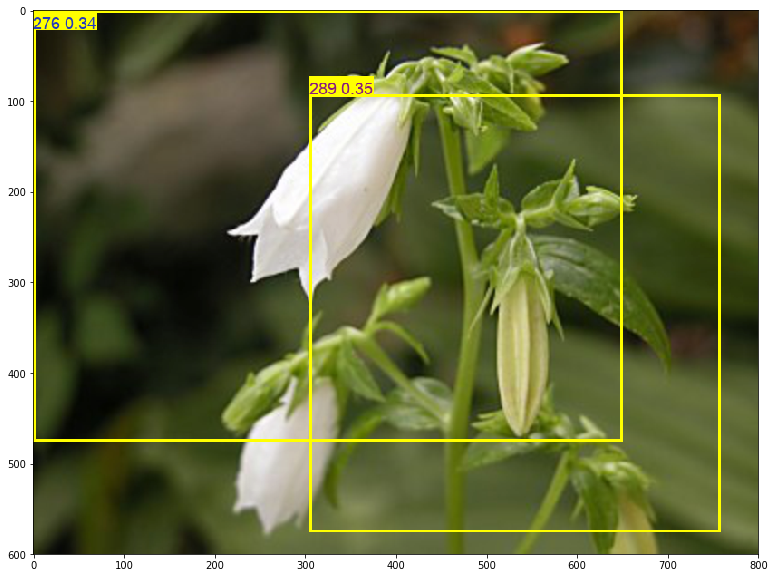

In [50]:
with torch.no_grad():
    result =  net.detect("./test_im/1036.jpg", thr=0.2)
    if result:
        pred_boxes, scores, classes, rois, im_data = result
        if(len(pred_boxes)):
            result_show(im_data[0], pred_boxes, classes, scores)

[u'2_gs_2580310.jpg']
(u'291', (152.0486601306252, 20.559587280762628), (545.9782179717772, 599.0))
[u'2_gs_1766515.jpg']
(u'2690', (698.6268884174274, 278.23988315831485), (935.9599694130907, 403.472502152824))
[u'2_gs_1670722.jpg']
(u'1490', (82.88537394426419, 331.82633194579773), (429.3221183724195, 647.1583793985995))
[u'2_gs_602759.jpg']
[u'2_gs_1768063.jpg']
(u'604', (139.41535812251968, 357.52640098220274), (222.08262464381224, 432.4496603072147))
(u'618', (386.7234900946429, 483.40249360857314), (518.1072435847667, 632.360936102182))
(u'28898', (62.41429502089216, 143.7671358335105), (166.65330745197983, 307.7654928109583))
[u'2_gs_1535142.jpg']
(u'1486', (154.1583353434548, 421.69195598178993), (268.46131422858775, 579.7661775124259))
[u'2_gs_2352200.jpg']
[u'2_gs_2121242.jpg']
(u'2657', (0.0, 535.0630249982106), (510.3077356730643, 1012.9020165702922))
(u'2657', (0.0, 588.8182019314243), (158.50371186332637, 698.2075400370325))
[u'2_gs_1741022.jpg']
(u'1603', (103.2730243198

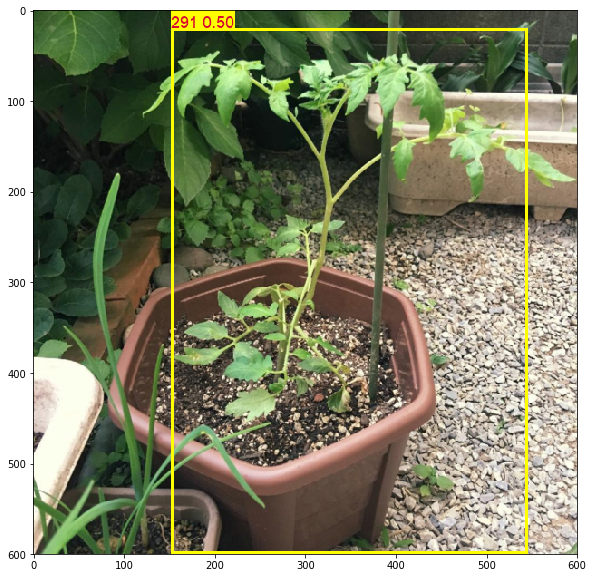

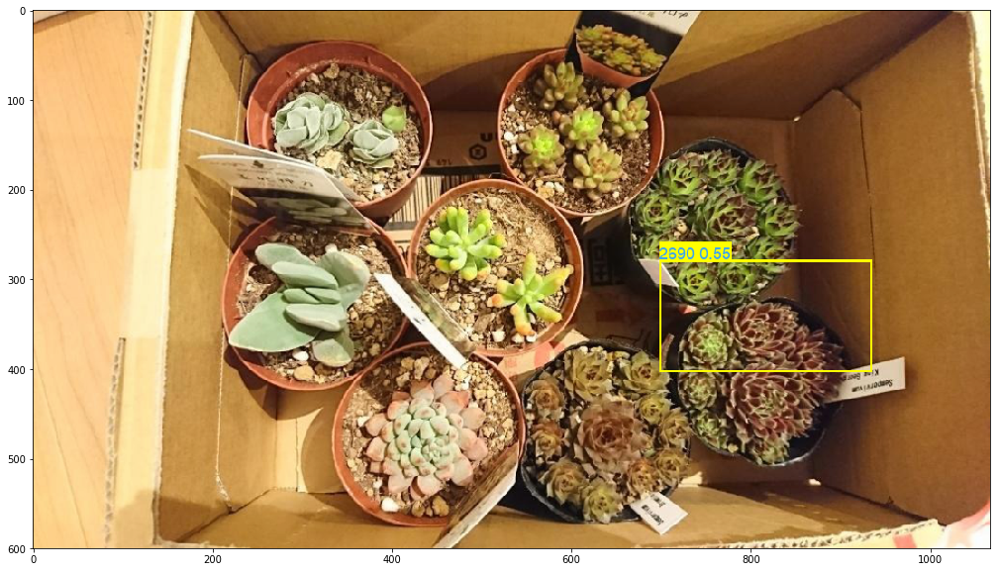

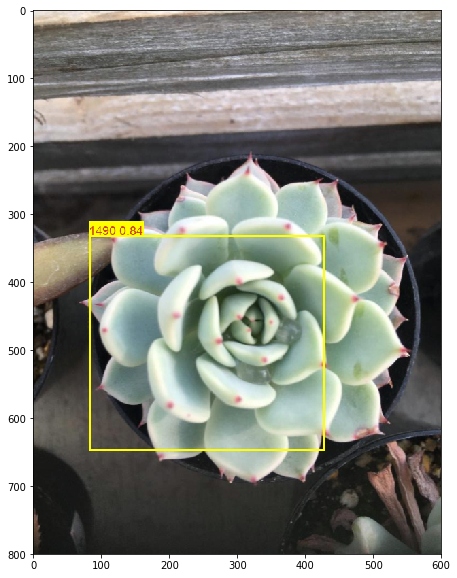

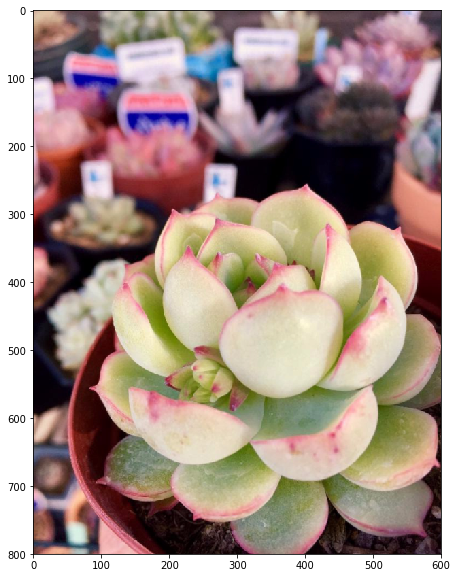

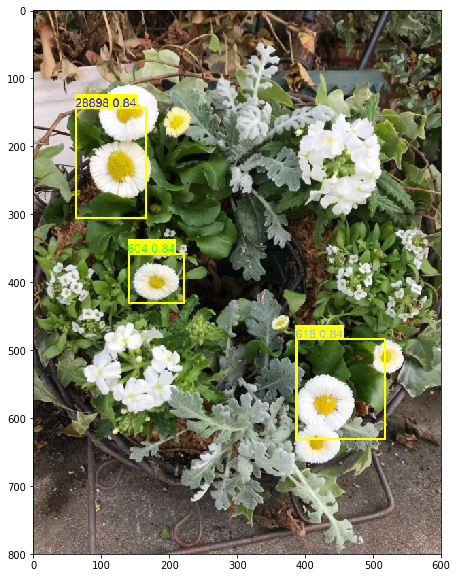

...

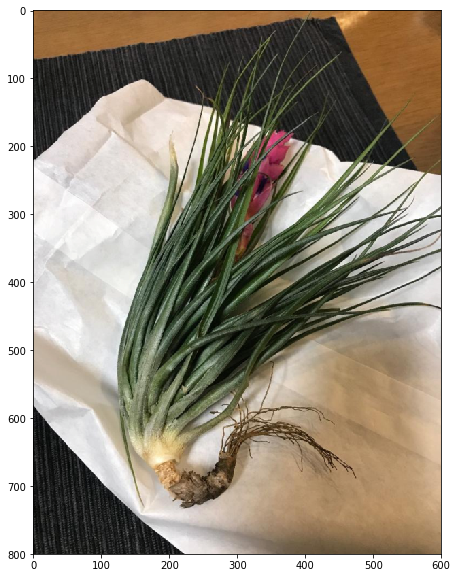

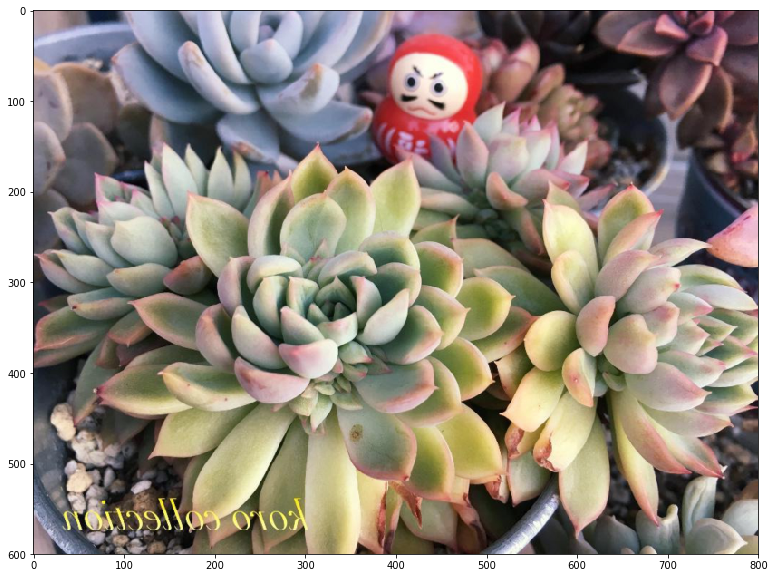

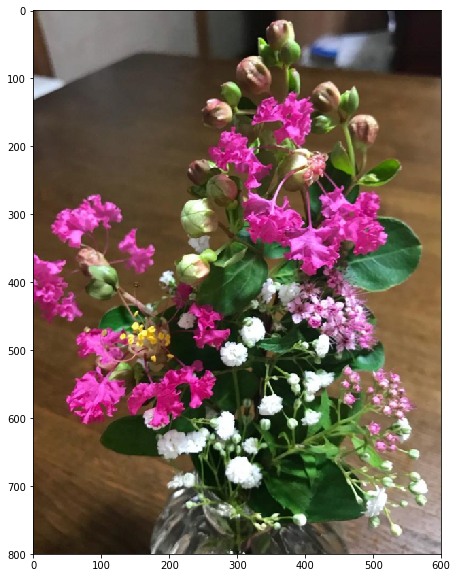

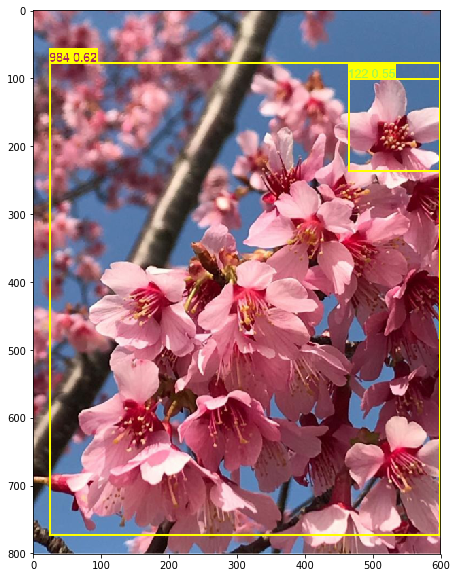

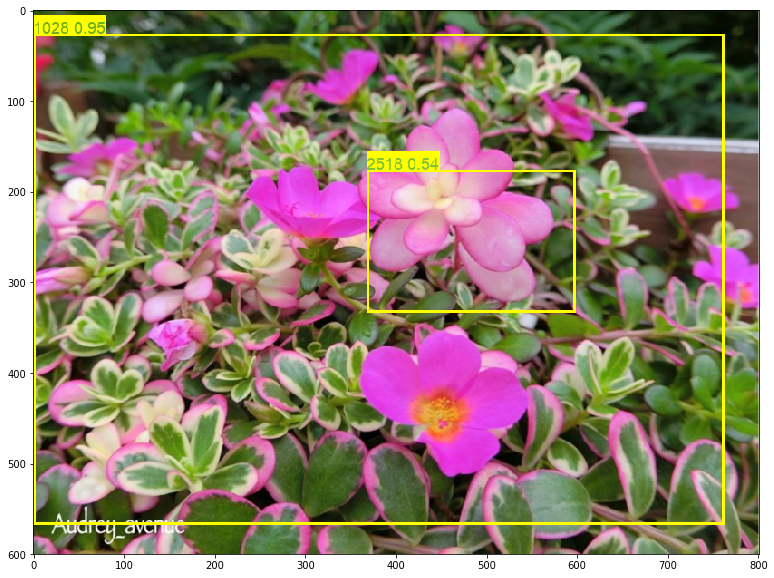

In [21]:
val_data_loader_tmp = DataLoader(val_ds, batch_size=1, shuffle=True, collate_fn=convert_data, num_workers=0, drop_last=True)
with torch.no_grad():
    for i, data in enumerate(val_data_loader_tmp):
        if not data:
            continue
        if i > 40:
            break
        batch_tensor, im_info, batch_boxes, batch_boxes_index, img_names = data
        print img_names
        pred_boxes, scores, classes, rois, im_data = net.detect_blob(batch_tensor, im_info, 0.5)
        result_show(batch_tensor[0], pred_boxes, classes, scores)
